<a href="https://colab.research.google.com/github/layely/DeepLearning-Course-UdeM/blob/master/Ly_Keras_FaceRGB_Caucasian.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Data preparation


## Authenticate to GDrive

In [0]:
# Code to read csv file into Colaboratory
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

## Download dataset (zip file)

In [0]:
import os

# Gdrive link of the dataset 
link = 'https://drive.google.com/open?id=1qINJkD-QOLTObanfIyVMK74yoa6Jins5'
  
_, id = link.split('=')

# Download if zip file does not exist
if os.path.isfile('FacesDataset.zip'):
  print("archive already downloaded")
else:
  print("Downloading dataset (FacesDataset.zip)...")
  downloaded = drive.CreateFile({'id':id})
  downloaded.GetContentFile('FacesDataset.zip')
  print("Donwload finished")

archive already downloaded


## Extract dataset archive

In [0]:
# Extract dataset archive
import zipfile

EXTRACT_PATH = "FacesDataset"

archive = zipfile.ZipFile('FacesDataset.zip', 'r')
archive.extractall(path=EXTRACT_PATH)


if os.path.isdir(EXTRACT_PATH):
  print("archive successfully extracted")
else:
  print("Can't extract archive")
  


archive successfully extracted


## Define load batch


Here we don't load entirely the dataset in ram since we can't afford it. We have almost double the number of images in Causasian folder compared to the number in Asian folder. So we load only a batch from the dataset, hence the training will be a bit slower compared to the notebook with Asian race. 

In [0]:
import numpy as np
import glob
import matplotlib.pyplot as plt
from skimage.transform import resize
import gc

#bottle_resized = resize(bottle, (140, 54), anti_aliasing=True)

root_dir = EXTRACT_PATH + "/" + EXTRACT_PATH
races = ["Caucasian"]

for race in races:
  directory = root_dir + "/" + race
  imgs_gs = glob.glob(directory + "/" + race + "GS/*.jpg")
  imgs_rgb = glob.glob(directory + "/" + race + "RGB/*jpg")
  

# Check if we have the same number of images in both GS and RGB folders
# and images are in the same order
print("len gs %d, len rgb %d " % (len(imgs_gs), len(imgs_rgb)))

img_width = 256
img_height = 256

def load_batch(list_rgb, list_gs, indexes):
  imgs_gs = np.array([resize(plt.imread(x), (img_width, img_height), anti_aliasing=True) 
                      for x in map(list_gs.__getitem__, indexes)])
  imgs_rgb = np.array([resize(plt.imread(x), (img_width, img_height), anti_aliasing=True) 
                       for x in map(list_rgb.__getitem__, indexes)])
  plt.clf()
  return imgs_rgb, np.expand_dims(imgs_gs, axis=3)



len gs 3362, len rgb 3362 


## Split Dataset

The dataset is split as follows: 80% for trainig and 20% for test. Then we pick from the training 60 images for validation.

In [0]:
train_proportion = 0.8
num_train = int(len(imgs_gs) * train_proportion)

imgs_gs_train = imgs_gs[0:num_train]
imgs_rgb_train = imgs_rgb[0:num_train]

imgs_gs_val = imgs_gs_train[0:60]
imgs_rgb_val = imgs_rgb_train[0:60]

imgs_gs_train = imgs_gs[60:]
imgs_rgb_train = imgs_rgb[60:]

imgs_gs_test = imgs_gs[num_train:]
imgs_rgb_test = imgs_rgb[num_train:]

print("Number of images in train set:", len(imgs_gs_train))
print("Number of images in train set:", len(imgs_gs_val))
print("Number of images in test set:", len(imgs_rgb_test))

Number of images in train set: 3302
Number of images in train set: 60
Number of images in test set: 673


## Show images from the dataset

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

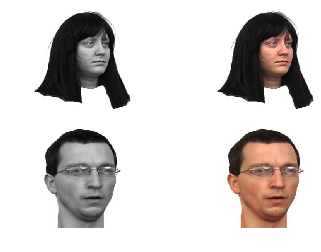

In [0]:
rgb_img, gs_img = load_batch(imgs_rgb_train, imgs_gs_train, list(range(5)))

fig, axis = plt.subplots(2, 2)
cnt = 0
for i in range(2):
  axis[i,0].imshow(gs_img[cnt, :, :,0], cmap='gray')
  axis[i,0].axis('off')
  axis[i,1].imshow(rgb_img[cnt, :, :,])
  axis[i,1].axis('off')
  cnt += 1
plt.show()
plt.close()

# Discriminator

For the discriminator we choose a pretrained DenseNet. Then, we add a global average pooling followed by a fully connected layer with 64 neurons and activated by a leaky relu function. After this, follows a final fully connected layer with a softmax activation judging weither the image is fake or real. Before each fully connected we add 50% dropout. We tested also a network similator to the encoder part of our generator but the adversarial loss get stuck only after the first step of the training.


![Discriminator architecture](https://i.ibb.co/HnRk5TD/tp-dl-gan-generator-1.png)

In [0]:
from keras.models import Sequential, Model
from keras.layers import Conv2D, LeakyReLU, Dropout, Flatten, Dense, GlobalAveragePooling2D
from keras.initializers import VarianceScaling
from keras.applications.densenet import DenseNet121

def freeze_model(model, num_freeze=0):
  # Freeze layers the first 'num_freeze' layers 
  for layer in model.layers[:num_freeze]:
    layer.trainable = False
  for layer in model.layers[num_freeze:]:
    layer.trainable = True
    
def build_discriminator(img_shape=(256,256,3), dropout=0.5, verbose=False):
  base_model = DenseNet121(input_shape=img_shape, weights='imagenet', include_top=False)
  
  x = base_model.output
  x = GlobalAveragePooling2D()(x)
  x = Dropout(dropout)(x)
  x = Dense(64)(x)
  x = LeakyReLU()(x)
  x = Dropout(dropout)(x)
  y = Dense(1, activation='sigmoid')(x)
  
  model = Model(inputs=base_model.input, outputs=y)
  
  freeze_model(model, num_freeze=len(base_model.layers))
  
  if verbose:
    model.summary()
  
  return model
            
disc = build_discriminator(verbose=True)

Using TensorFlow backend.


Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
zero_padding2d_1 (ZeroPadding2D (None, 262, 262, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 128, 128, 64) 9408        zero_padding2d_1[0][0]           
__________________________________________________________________________________________________
conv1/bn (BatchNormal

# Generator

![Texte alternatif…](https://i.ibb.co/fFNcGqx/generator-projet-dl.png)

The generator has two stages: an encoder and a decoder. Each encoding part consist of a convolution followed by a batch normatiliztaion and a leaky relu with alpha equal to 0.3. In each decoding part, we have an upsampling followed by a decovolution. We further concatenate the output of each deconvolution with the output of the symetric encoding block. Except, the last decoding block is concatenated with the grayscale image given as input. This architecture is choosen because it is memory efficient compared to a fully convNet that we also tested. The concatenation allows the network to keep track of the past feature and hence we have more realistic images in fewer steps. This mainly inspired from the UNet architecture.

A part from that, the outpout of our generator is activated with sigmoid instead of tanh. The only reason for this is to avoid having to normalize again the image in the range [0, 1].

In [0]:
from keras.models import Sequential
from keras.layers import Conv2D, Deconv2D, UpSampling2D, Cropping2D, BatchNormalization, LeakyReLU
from keras.layers import Activation, Reshape, Dropout, Dense, Flatten, concatenate
from keras.models import Input, Model

def encode(input_tensor, filters, strides=1, filter_size=5):
  x = Conv2D(filters, filter_size, strides=strides, padding='same')(input_tensor)
  y = BatchNormalization(momentum=0.9)(x)
  z = LeakyReLU(alpha=0.3)(y)
  return z

def decode(input_tensor, filters, filter_size=5, concat=None):
  x = UpSampling2D(size=(2,2))(input_tensor)
  y = Deconv2D(filters, filter_size, padding='same')(x)
  z = BatchNormalization(momentum=0.9)(y)
  t = LeakyReLU(alpha=0.3)(z)
  if concat == None:
    return t
  else:
    print(t.shape)
    print(concat.shape)
    return concatenate([concat, t])
  
def build_generator(imgs_shape=(img_width,img_height,1), dropout=0.4, verbose=False):
  grayscale = Input(shape=imgs_shape)
  
  # Encode
  e1 = encode(grayscale, 64, strides=2)
  e2 = encode(e1, 128, strides=2)
  e3 = encode(e2, 256, strides=2)
  e4 = encode(e3, 512, strides=2)
  
  # Decode
  d1 = decode(e4, 256, concat=e3)
  d2 = decode(d1, 128, concat=e2)
  d3 = decode(d2, 64, concat=e1)
  d4 = decode(d3, 32, concat=grayscale)
  
  rgb_1 = Conv2D(3, 5, strides=1, padding='same')(d4)
  rgb = Activation('sigmoid')(rgb_1)
  
  model = Model(grayscale, rgb)
            
  if verbose:
    model.summary()
  
  return model

gen = build_generator(verbose=True)
            

(?, ?, ?, 256)
(?, 32, 32, 256)
(?, ?, ?, 128)
(?, 64, 64, 128)
(?, ?, ?, 64)
(?, 128, 128, 64)
(?, ?, ?, 32)
(?, 256, 256, 1)
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 256, 256, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 64) 1664        input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_2 (LeakyReLU)       (None, 128, 128, 64) 0           batch_normalizat

# Show generated images

This function allows us to show 4 imagesto monitor our generator perforcemance during training.

In [0]:
import matplotlib.pyplot as plt

def sample_images(epoch, generator, imgs_gs):
  r, c = 2, 2
  gen_imgs = generator.predict(imgs_gs[0:r*c])
  
  fig, axis = plt.subplots(r, c)
  cnt = 0
  for i in range(r):
    for j in range(c):
      axis[i,j].imshow(gen_imgs[cnt, :, :,])
      axis[i,j].axis('off')
      cnt += 1
  plt.show()
  plt.close()

# Init Hyperparams

Here we use a batch size of 16 and 500 iteration suffice to  have very good results as it can be seen bellow. We tested Adam an RMSprop by the results were also pretty similar.

In [0]:
from keras.optimizers import RMSprop, Adam

batch_size = 16
epochs = 500 #5000

# discriminator params
d_lr = 0.9 #.0008
d_decay = 6e-8
d_optimizer = Adam(lr=d_lr, decay=d_decay) #RMSprop(lr=d_lr, clipvalue=1.0, decay=d_decay)

# adversarial params
a_lr = 0.0002
a_decay = 3e-8
a_optimizer = Adam(lr=a_lr, decay=a_decay) #RMSprop(lr=a_lr, clipvalue=1.0, decay=a_decay)


# Combine Generator and Discriminator

Here we create the combined model which have two ouputs, a classification value (fake or real) from the discriminator and the generated images from the generator. We also combined two losses (binary crossentropy and mse), this is mainly inspired from SRGAN. At the begining we tried using only a binary crossentropy loss and it didn't work as the generator was not learning anything. The discriminator is only compiled with a binary crossentropy loss and is freezed before plugged to the combined network. 

In [0]:


from keras.models import Model
from keras.layers import concatenate, Input
from keras.applications.densenet import preprocess_input

# Build and compile discriminator
discriminator = build_discriminator((img_width, img_height, 3))
discriminator.compile(loss='binary_crossentropy',
                      optimizer=d_optimizer,
                      metrics=['accuracy'])


# build generator
generator = build_generator(imgs_shape=(img_width, img_height, 1))
#generator.compile(loss='mae', optimizer=a_optimizer, metrics=['accuracy'])

# generator takes noise and return img
gs_image = Input(shape=(img_width,img_height,1))
rgb_image = generator(gs_image)

# Freeze discriminator when combined with generator
discriminator.trainable = False

# discriminator takes generated images as input and determines validity
validity = discriminator(rgb_image)

# combine models
adversarial = Sequential()
adversarial = Model(gs_image, [validity, rgb_image])
adversarial.compile(loss=['binary_crossentropy', 'mse'], 
                    loss_weights=[1, 1], 
                    optimizer=a_optimizer)

(?, ?, ?, 256)
(?, 32, 32, 256)
(?, ?, ?, 128)
(?, 64, 64, 128)
(?, ?, ?, 64)
(?, 128, 128, 64)
(?, ?, ?, 32)
(?, 256, 256, 1)


# Adversarial Training

Here we create the combined model which have two ouputs, a classification value (fake or real) from the discriminator and the generated images from the generator. We also combined two losses (binary crossentropy and mse), this is mainly inspired from SRGAN. At the begining we tried using only a binary crossentropy loss and it didn't work as the generator was not learning anything. The discriminator is only compiled with a binary crossentropy loss and is freezed before plugged to the combined network. 

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


60/60 [==============================] - 14s 231ms/step
[0.07588237375020981, 1.192093321833454e-07, 0.07588225454092026]
d_real: [0.0007721359, 1.0]
d_fake: [15.942385, 0.0]
0/500 [D loss: 7.971579, acc.: 50.00%] [G loss mse: 0.103834] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

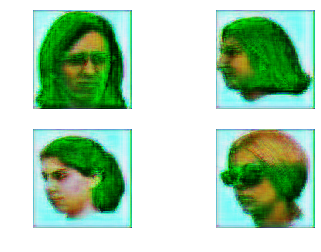

60/60 [==============================] - 1s 16ms/step
[0.07459346950054169, 1.192093321833454e-07, 0.07459335029125214]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
1/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.080885] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

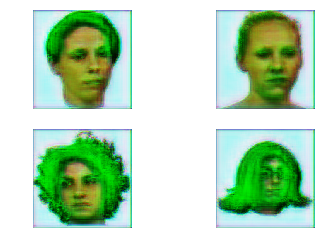

60/60 [==============================] - 1s 16ms/step
[0.06559297690788905, 1.192093321833454e-07, 0.0655928576985995]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
2/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.070963] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

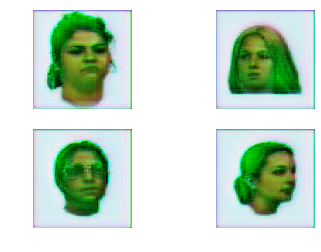

60/60 [==============================] - 1s 16ms/step
[0.05875808522105217, 1.192093321833454e-07, 0.05875796601176262]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
3/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.063405] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

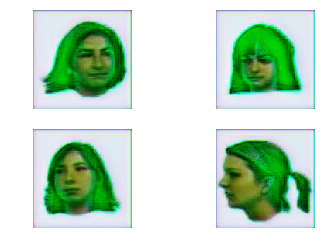

60/60 [==============================] - 1s 16ms/step
[0.05266398638486862, 1.192093321833454e-07, 0.05266386717557907]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
4/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.053022] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

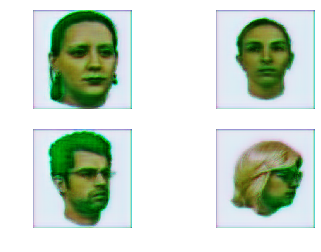

60/60 [==============================] - 1s 16ms/step
[0.04391413008173307, 1.192093321833454e-07, 0.04391401087244352]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
5/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.037294] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

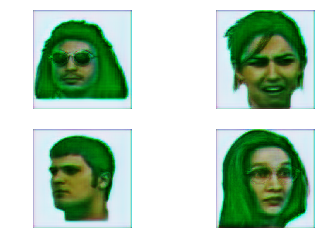

60/60 [==============================] - 1s 16ms/step
[0.03819065565864245, 1.192093321833454e-07, 0.0381905364493529]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
6/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.030939] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

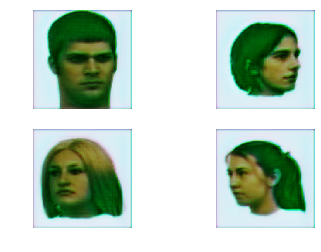

60/60 [==============================] - 1s 16ms/step
[0.033607779443264006, 1.192093321833454e-07, 0.033607660233974455]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
7/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.024144] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

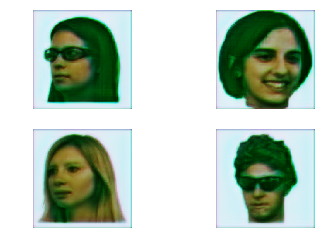

60/60 [==============================] - 1s 16ms/step
[0.03196512299279372, 1.192093321833454e-07, 0.03196500378350417]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
8/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.030028] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

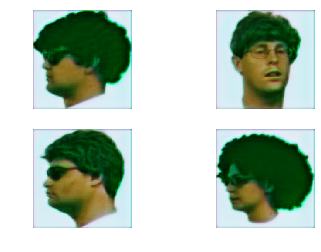

60/60 [==============================] - 1s 16ms/step
[0.030590861787398657, 1.192093321833454e-07, 0.030590742578109106]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
9/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.027913] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

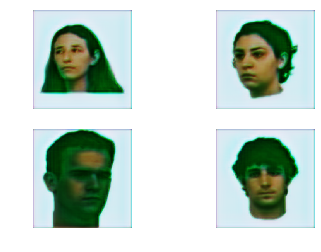

60/60 [==============================] - 1s 16ms/step
[0.029456841697295507, 1.192093321833454e-07, 0.029456722488005956]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
10/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.026861] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

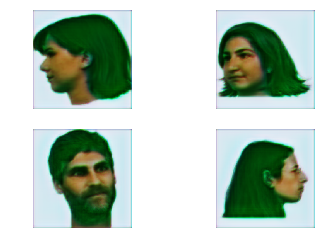

60/60 [==============================] - 1s 16ms/step
[0.028547008832295735, 1.192093321833454e-07, 0.028546889623006184]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
11/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.025496] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

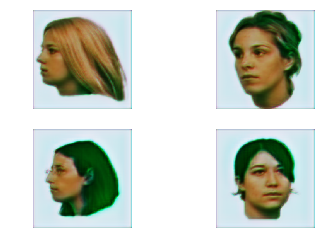

60/60 [==============================] - 1s 16ms/step
[0.02656953694919745, 1.192093321833454e-07, 0.0265694177399079]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
12/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.020787] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

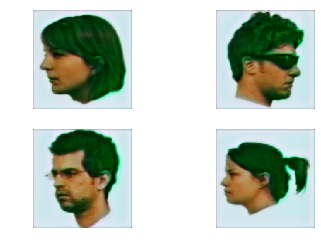

60/60 [==============================] - 1s 16ms/step
[0.024950852120916047, 1.192093321833454e-07, 0.024950732911626496]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
13/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.020627] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

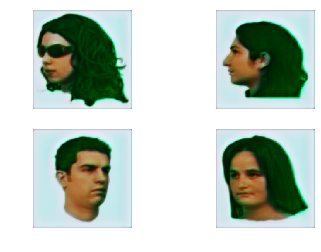

60/60 [==============================] - 1s 16ms/step
[0.024829811602830886, 1.192093321833454e-07, 0.024829692393541335]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
14/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.026302] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

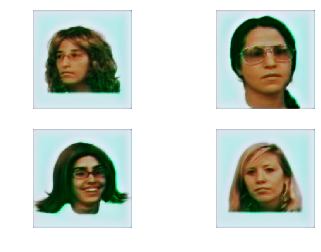

60/60 [==============================] - 1s 16ms/step
[0.024302745113770167, 1.192093321833454e-07, 0.024302625904480617]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
15/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.020124] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

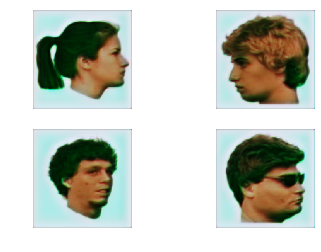

60/60 [==============================] - 1s 16ms/step
[0.023721088841557502, 1.192093321833454e-07, 0.02372096963226795]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
16/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.017245] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

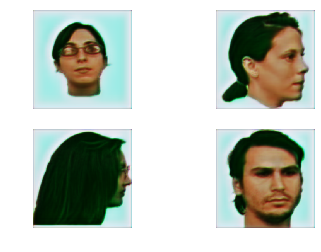

60/60 [==============================] - 1s 16ms/step
[0.023127036541700362, 1.192093321833454e-07, 0.02312691733241081]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
17/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.017973] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

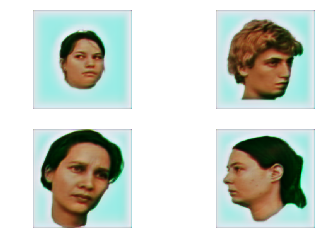

60/60 [==============================] - 1s 16ms/step
[0.023948978384335837, 1.192093321833454e-07, 0.023948859175046286]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
18/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.024598] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

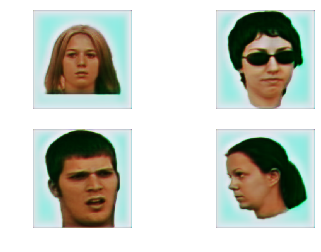

60/60 [==============================] - 1s 16ms/step
[0.02249388284981251, 1.192093321833454e-07, 0.022493763640522958]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
19/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.014187] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

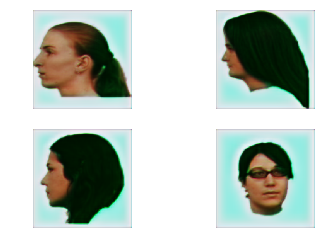

60/60 [==============================] - 1s 16ms/step
[0.022082621107498805, 1.192093321833454e-07, 0.022082501898209254]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
20/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.019117] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

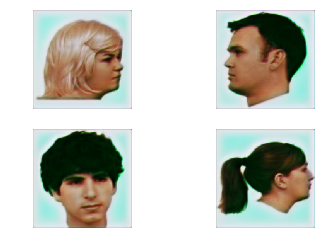

60/60 [==============================] - 1s 16ms/step
[0.020681940640012424, 1.192093321833454e-07, 0.020681821430722874]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
21/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.012167] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

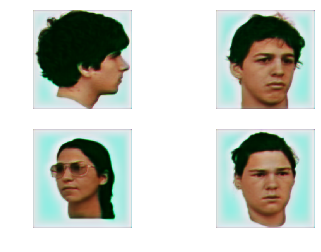

60/60 [==============================] - 1s 16ms/step
[0.01964603327214718, 1.192093321833454e-07, 0.01964591406285763]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
22/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.014030] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

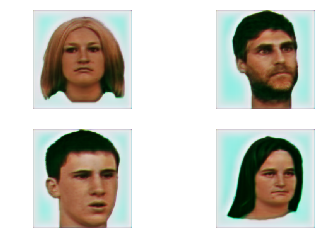

60/60 [==============================] - 1s 16ms/step
[0.018490489572286606, 1.192093321833454e-07, 0.018490370362997055]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
23/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.010913] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

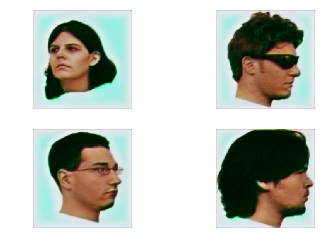

60/60 [==============================] - 1s 16ms/step
[0.01921606846153736, 1.192093321833454e-07, 0.01921594925224781]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
24/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.017604] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

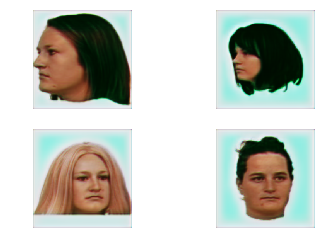

60/60 [==============================] - 1s 16ms/step
[0.02192285383741061, 1.192093321833454e-07, 0.021922734628121058]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
25/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.022918] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

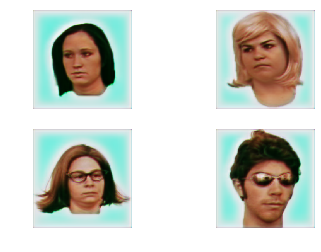

60/60 [==============================] - 1s 16ms/step
[0.021161083007852237, 1.192093321833454e-07, 0.021160963798562686]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
26/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.010504] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

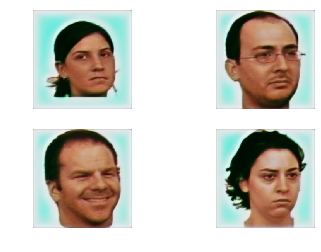

60/60 [==============================] - 1s 16ms/step
[0.01763123758137226, 1.192093321833454e-07, 0.01763111837208271]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
27/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.008922] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

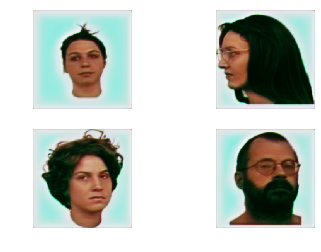

60/60 [==============================] - 1s 16ms/step
[0.01637249402701855, 1.192093321833454e-07, 0.016372374817728998]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
28/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.014680] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

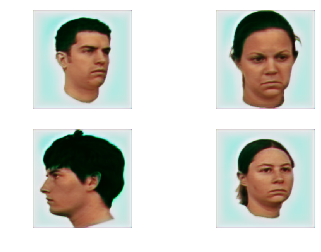

60/60 [==============================] - 1s 16ms/step
[0.015182833932340146, 1.192093321833454e-07, 0.015182714723050595]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
29/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.008645] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

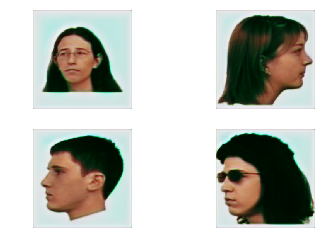

60/60 [==============================] - 1s 16ms/step
[0.01420119336495797, 1.192093321833454e-07, 0.014201074155668418]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
30/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.010503] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

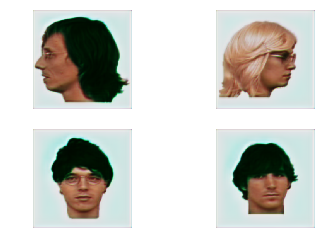

60/60 [==============================] - 1s 16ms/step
[0.013364206564923127, 1.192093321833454e-07, 0.013364087355633577]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
31/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.010644] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

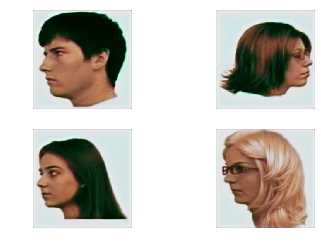

60/60 [==============================] - 1s 16ms/step
[0.012536140903830529, 1.192093321833454e-07, 0.012536021694540978]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
32/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.008780] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

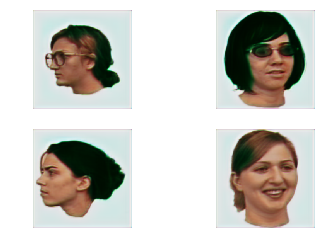

60/60 [==============================] - 1s 16ms/step
[0.01196104393651088, 1.192093321833454e-07, 0.01196092472722133]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
33/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.009726] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

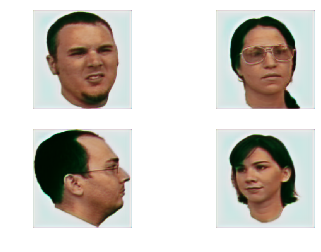

60/60 [==============================] - 1s 16ms/step
[0.011678437081476053, 1.192093321833454e-07, 0.011678317872186502]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
34/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.011063] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

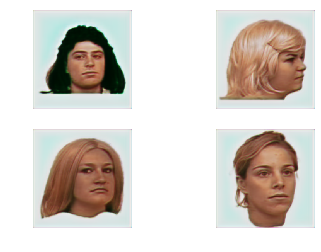

60/60 [==============================] - 1s 16ms/step
[0.010882985157271227, 1.192093321833454e-07, 0.010882865947981676]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
35/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006404] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

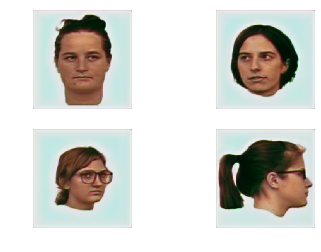

60/60 [==============================] - 1s 16ms/step
[0.01047098555912574, 1.192093321833454e-07, 0.01047086634983619]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
36/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.009377] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

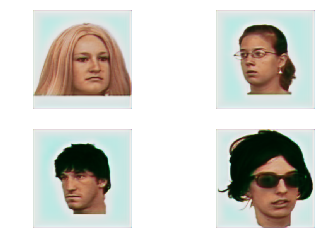

60/60 [==============================] - 1s 16ms/step
[0.009378701572616895, 1.192093321833454e-07, 0.009378582363327344]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
37/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006096] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

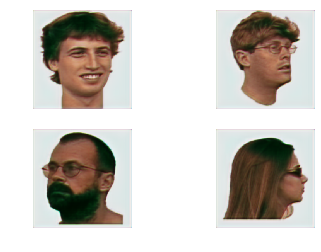

60/60 [==============================] - 1s 16ms/step
[0.009553054161369801, 1.192093321833454e-07, 0.00955293495208025]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
38/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.008249] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

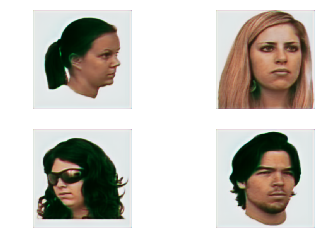

60/60 [==============================] - 1s 16ms/step
[0.009607290662825108, 1.192093321833454e-07, 0.009607171453535557]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
39/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.007269] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

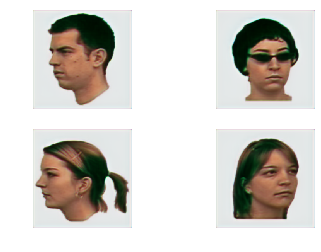

60/60 [==============================] - 1s 16ms/step
[0.009182516547540823, 1.192093321833454e-07, 0.009182397338251273]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
40/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.007044] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

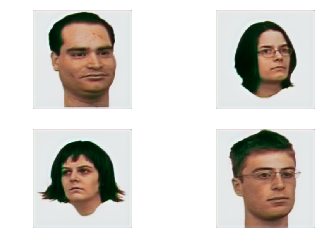

60/60 [==============================] - 1s 16ms/step
[0.008766097202897071, 1.192093321833454e-07, 0.00876597799360752]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
41/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.008721] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

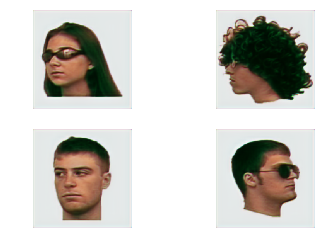

60/60 [==============================] - 1s 16ms/step
[0.00806850902736187, 1.192093321833454e-07, 0.008068389818072319]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
42/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006335] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

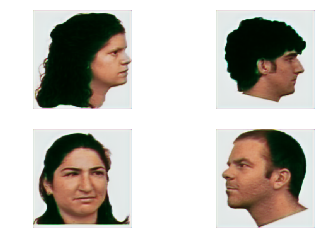

60/60 [==============================] - 1s 16ms/step
[0.007510680022339026, 1.192093321833454e-07, 0.007510560813049475]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
43/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.007632] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

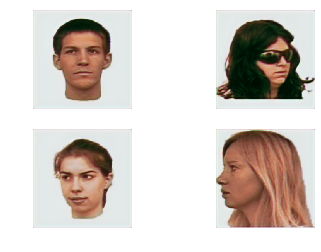

60/60 [==============================] - 1s 16ms/step
[0.007114477393527826, 1.192093321833454e-07, 0.007114358184238275]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
44/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.007270] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

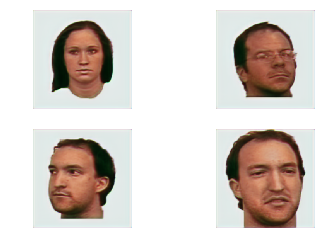

60/60 [==============================] - 1s 16ms/step
[0.00675902512545387, 1.192093321833454e-07, 0.006758905916164319]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
45/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006352] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

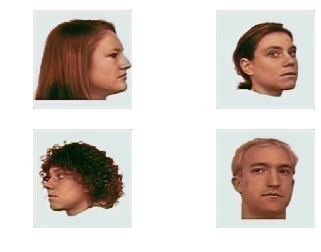

60/60 [==============================] - 1s 16ms/step
[0.006407943150649468, 1.192093321833454e-07, 0.006407823941359917]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
46/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006160] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

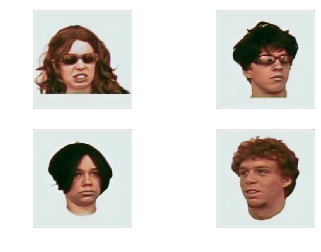

60/60 [==============================] - 1s 16ms/step
[0.006159889915337165, 1.192093321833454e-07, 0.006159770706047615]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
47/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006498] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

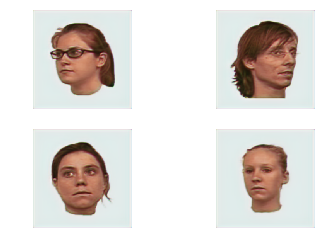

60/60 [==============================] - 1s 16ms/step
[0.005863292763630549, 1.192093321833454e-07, 0.005863173554340999]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
48/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.005626] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

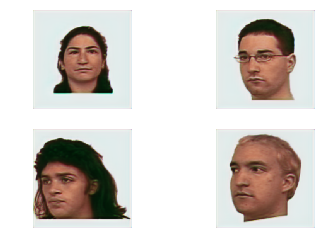

60/60 [==============================] - 1s 16ms/step
[0.005643131739149491, 1.192093321833454e-07, 0.00564301252985994]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
49/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004327] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

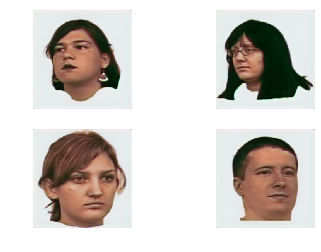

60/60 [==============================] - 1s 16ms/step
[0.005839509330689907, 1.192093321833454e-07, 0.005839390121400357]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
50/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004774] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

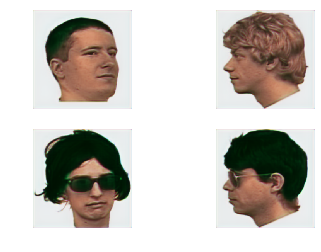

60/60 [==============================] - 1s 16ms/step
[0.00581999933347106, 1.192093321833454e-07, 0.005819880124181509]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
51/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004048] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

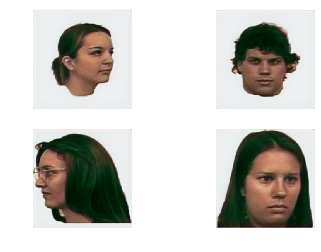

60/60 [==============================] - 1s 16ms/step
[0.00579234454780817, 1.192093321833454e-07, 0.005792225338518619]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
52/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004336] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

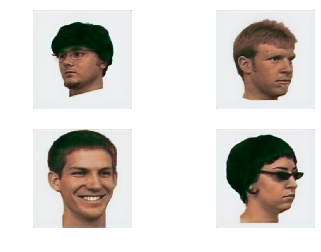

60/60 [==============================] - 1s 16ms/step
[0.0056919879590471584, 1.192093321833454e-07, 0.005691868749757608]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
53/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.010739] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

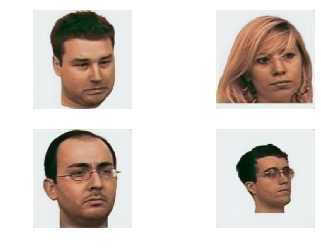

60/60 [==============================] - 1s 16ms/step
[0.0051033963138858475, 1.192093321833454e-07, 0.005103277104596297]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
54/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004279] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

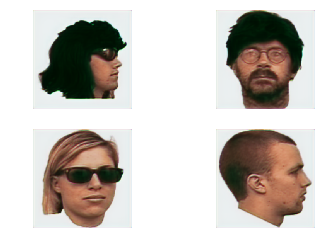

60/60 [==============================] - 1s 16ms/step
[0.00472134705632925, 1.192093321833454e-07, 0.004721227847039699]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
55/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004159] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

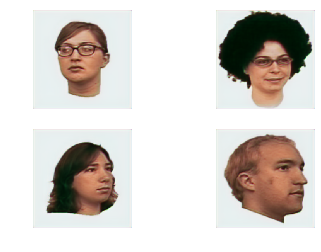

60/60 [==============================] - 1s 16ms/step
[0.004703370730082194, 1.192093321833454e-07, 0.004703251520792643]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
56/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004540] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

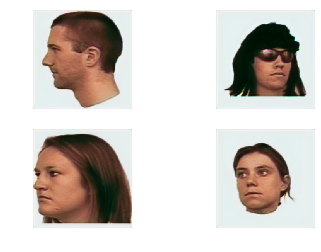

60/60 [==============================] - 1s 16ms/step
[0.004795525905986627, 1.192093321833454e-07, 0.004795406696697076]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
57/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004761] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

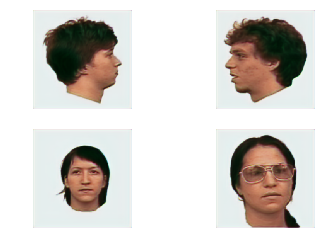

60/60 [==============================] - 1s 16ms/step
[0.004844612317780653, 1.192093321833454e-07, 0.0048444931084911024]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
58/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004674] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

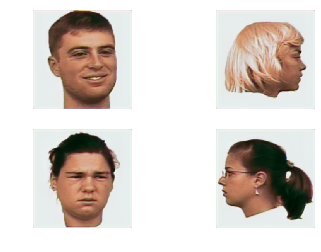

60/60 [==============================] - 1s 16ms/step
[0.004841031848142544, 1.192093321833454e-07, 0.004840912638852993]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
59/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003856] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

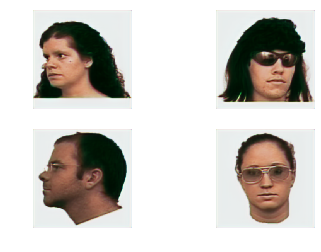

60/60 [==============================] - 1s 16ms/step
[0.004926670187463363, 1.192093321833454e-07, 0.004926550978173812]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
60/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003607] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

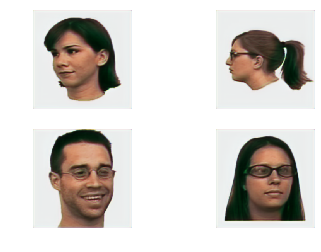

60/60 [==============================] - 1s 16ms/step
[0.00498657568047444, 1.192093321833454e-07, 0.004986456471184889]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
61/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003897] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

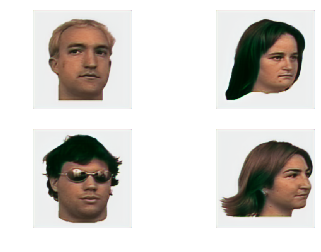

60/60 [==============================] - 1s 16ms/step
[0.004785635105023781, 1.192093321833454e-07, 0.0047855158957342304]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
62/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004289] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

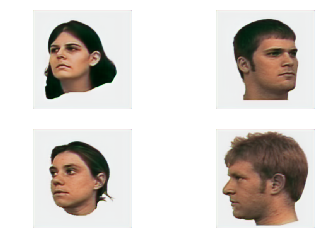

60/60 [==============================] - 1s 16ms/step
[0.004447639702508847, 1.192093321833454e-07, 0.004447520493219296]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
63/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.007547] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

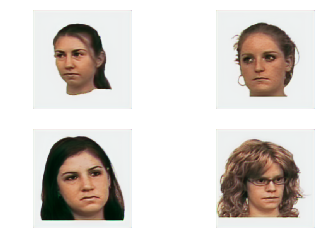

60/60 [==============================] - 1s 16ms/step
[0.0038653888273984193, 1.192093321833454e-07, 0.0038652696181088685]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
64/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004283] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

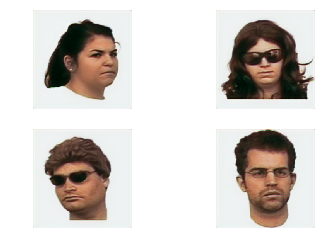

60/60 [==============================] - 1s 16ms/step
[0.0034934053507943946, 1.192093321833454e-07, 0.003493286141504844]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
65/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003190] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

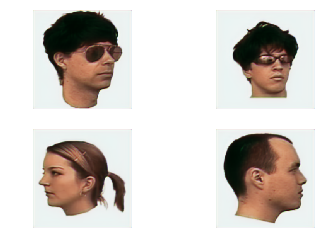

60/60 [==============================] - 1s 16ms/step
[0.003477354859933257, 1.192093321833454e-07, 0.0034772356506437064]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
66/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004276] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

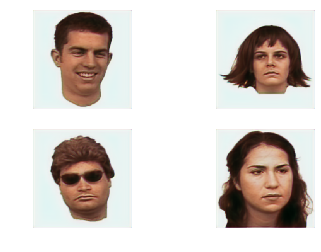

60/60 [==============================] - 1s 16ms/step
[0.0044755767720441025, 1.192093321833454e-07, 0.004475457562754552]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
67/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.005599] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

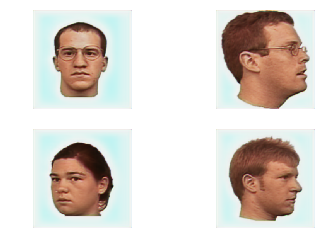

60/60 [==============================] - 1s 16ms/step
[0.004783972352743149, 1.192093321833454e-07, 0.004783853143453598]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
68/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006497] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

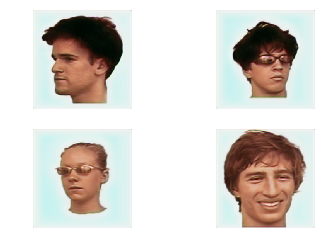

60/60 [==============================] - 1s 16ms/step
[0.01151568436374267, 1.192093321833454e-07, 0.011515565154453119]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
69/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004367] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

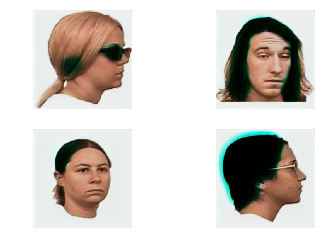

60/60 [==============================] - 1s 16ms/step
[0.021510588377714156, 1.192093321833454e-07, 0.021510469168424605]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
70/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004420] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

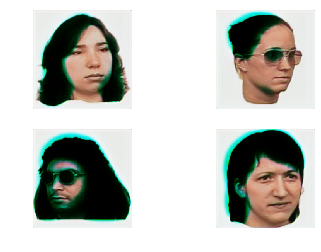

60/60 [==============================] - 1s 16ms/step
[0.02460069072743257, 1.192093321833454e-07, 0.02460057151814302]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
71/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004704] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

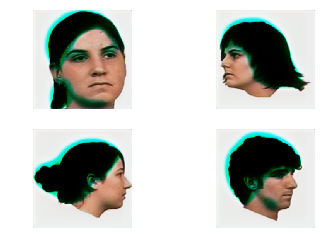

60/60 [==============================] - 1s 16ms/step
[0.025059512257575987, 1.192093321833454e-07, 0.025059393048286437]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
72/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.005987] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

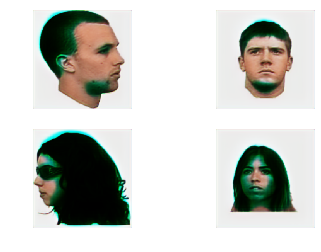

60/60 [==============================] - 1s 16ms/step
[0.02328638918697834, 1.192093321833454e-07, 0.02328626997768879]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
73/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004933] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

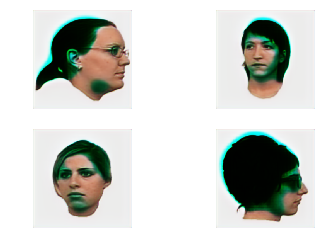

60/60 [==============================] - 1s 16ms/step
[0.02039000081519286, 1.192093321833454e-07, 0.02038988160590331]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
74/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004599] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

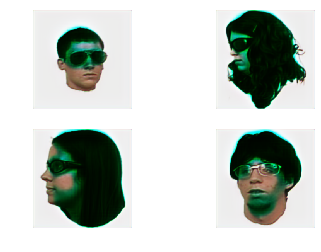

60/60 [==============================] - 1s 16ms/step
[0.018354190265138945, 1.192093321833454e-07, 0.018354071055849394]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
75/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006973] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

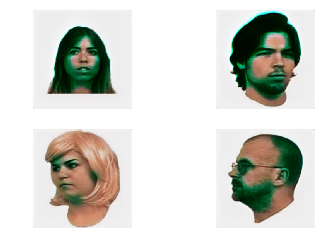

60/60 [==============================] - 1s 16ms/step
[0.01589693867911895, 1.192093321833454e-07, 0.0158968194698294]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
76/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.006289] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

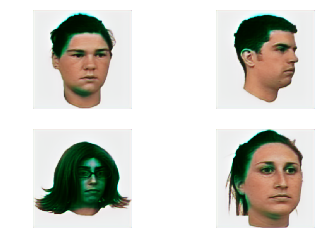

60/60 [==============================] - 1s 16ms/step
[0.012781624806423982, 1.192093321833454e-07, 0.01278150559713443]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
77/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004083] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

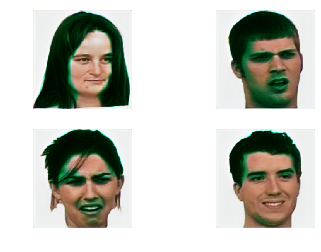

60/60 [==============================] - 1s 16ms/step
[0.009959120365480582, 1.192093321833454e-07, 0.009959001156191031]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
78/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003168] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

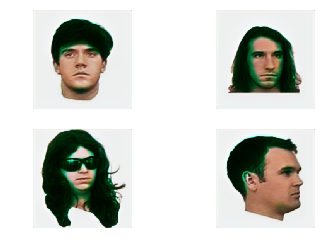

60/60 [==============================] - 1s 16ms/step
[0.00834370795637369, 1.192093321833454e-07, 0.00834358874708414]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
79/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003933] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

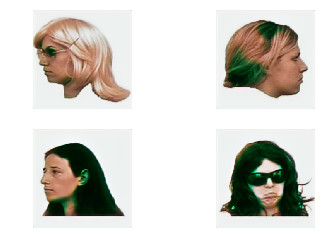

60/60 [==============================] - 1s 16ms/step
[0.0070659594610333444, 1.192093321833454e-07, 0.007065840251743794]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
80/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003805] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

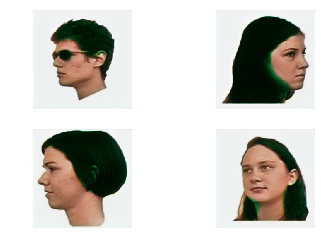

60/60 [==============================] - 1s 16ms/step
[0.0060780356327692665, 1.192093321833454e-07, 0.006077916423479716]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
81/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003630] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

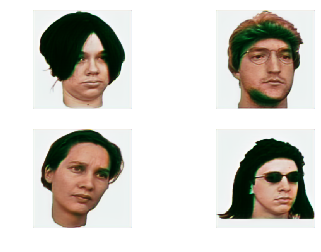

60/60 [==============================] - 1s 16ms/step
[0.005372211430221796, 1.192093321833454e-07, 0.005372092220932245]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
82/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004072] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

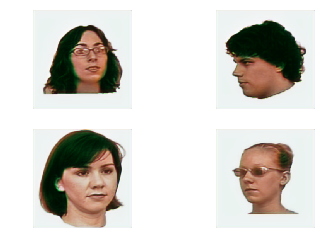

60/60 [==============================] - 1s 16ms/step
[0.004912812759478887, 1.192093321833454e-07, 0.004912693550189336]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
83/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004051] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

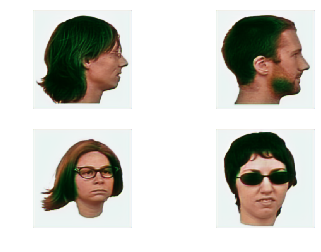

60/60 [==============================] - 1s 16ms/step
[0.004606329929083585, 1.192093321833454e-07, 0.004606210719794035]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
84/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004115] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

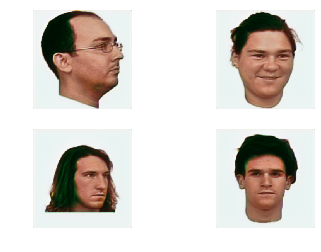

60/60 [==============================] - 1s 16ms/step
[0.0044379553757607935, 1.192093321833454e-07, 0.004437836166471243]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
85/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004116] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

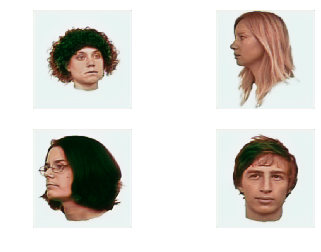

60/60 [==============================] - 1s 16ms/step
[0.004044976488997539, 1.192093321833454e-07, 0.004044857279707988]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
86/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003582] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

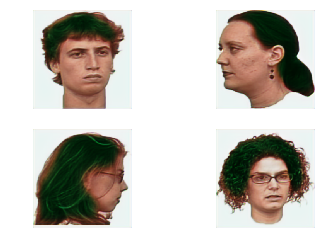

60/60 [==============================] - 1s 16ms/step
[0.003976418807481726, 1.192093321833454e-07, 0.0039762995981921755]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
87/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004309] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

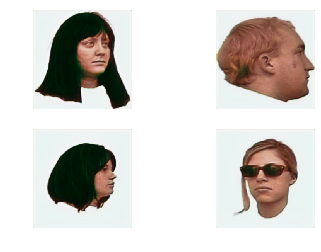

60/60 [==============================] - 1s 16ms/step
[0.0038408690753082434, 1.192093321833454e-07, 0.0038407498660186926]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
88/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003423] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

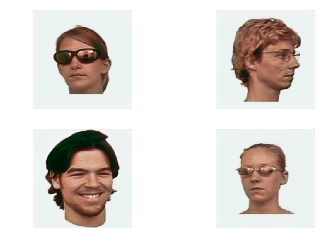

60/60 [==============================] - 1s 16ms/step
[0.0035490862249086303, 1.192093321833454e-07, 0.0035489670156190795]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
89/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003057] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

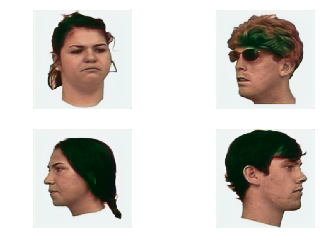

60/60 [==============================] - 1s 16ms/step
[0.003332999364162485, 1.192093321833454e-07, 0.0033328801548729342]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
90/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003162] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

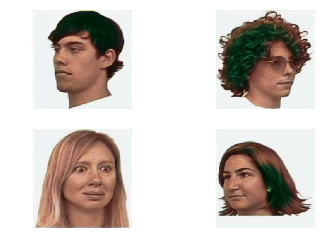

60/60 [==============================] - 1s 16ms/step
[0.0033945924136787654, 1.192093321833454e-07, 0.0033944732043892146]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
91/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004100] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

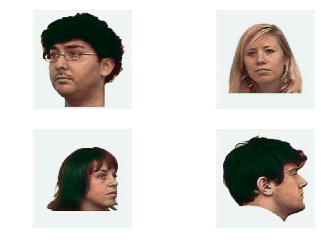

60/60 [==============================] - 1s 16ms/step
[0.0033514696328590314, 1.192093321833454e-07, 0.0033513504235694806]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
92/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002928] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

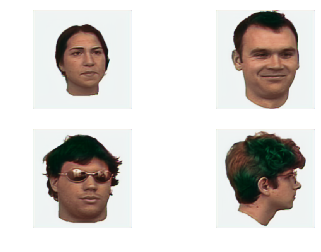

60/60 [==============================] - 1s 16ms/step
[0.0031930628853539624, 1.192093321833454e-07, 0.0031929436760644117]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
93/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002632] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

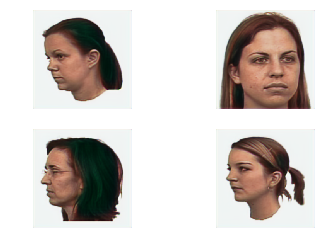

60/60 [==============================] - 1s 16ms/step
[0.0031636157383521397, 1.192093321833454e-07, 0.003163496529062589]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
94/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003733] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

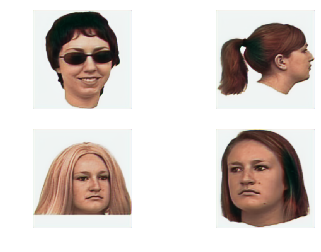

60/60 [==============================] - 1s 16ms/step
[0.0028765374328941105, 1.192093321833454e-07, 0.0028764182236045597]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
95/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002166] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

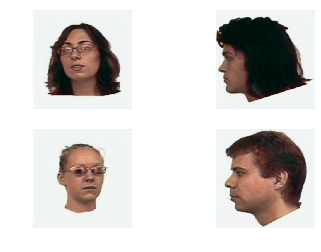

60/60 [==============================] - 1s 16ms/step
[0.0028722793019066253, 1.192093321833454e-07, 0.0028721600926170745]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
96/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004033] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

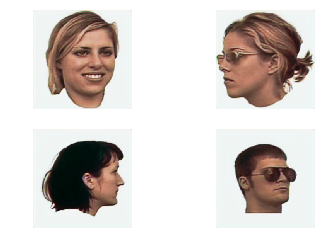

60/60 [==============================] - 1s 16ms/step
[0.002767802526553472, 1.192093321833454e-07, 0.0027676833172639212]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
97/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002455] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

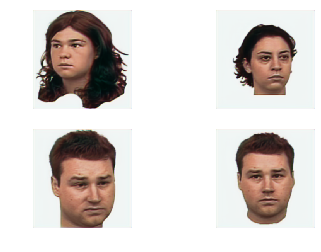

60/60 [==============================] - 1s 16ms/step
[0.002740020103131731, 1.192093321833454e-07, 0.0027399008938421804]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
98/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002468] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

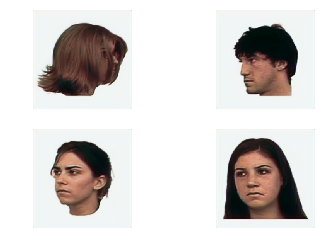

60/60 [==============================] - 1s 16ms/step
[0.0027286058757454157, 1.192093321833454e-07, 0.002728486666455865]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
99/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002234] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

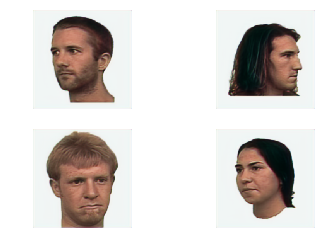

60/60 [==============================] - 1s 16ms/step
[0.0027822894665102166, 1.192093321833454e-07, 0.002782170257220666]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
100/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003683] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

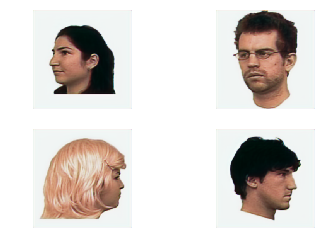

60/60 [==============================] - 1s 16ms/step
[0.002821072532484929, 1.192093321833454e-07, 0.002820953323195378]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
101/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003232] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

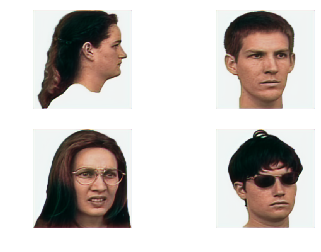

60/60 [==============================] - 1s 16ms/step
[0.0028200673560301462, 1.192093321833454e-07, 0.0028199481467405954]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
102/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002677] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

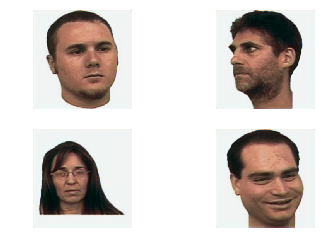

60/60 [==============================] - 1s 16ms/step
[0.002675120998173952, 1.192093321833454e-07, 0.002675001788884401]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
103/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003632] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

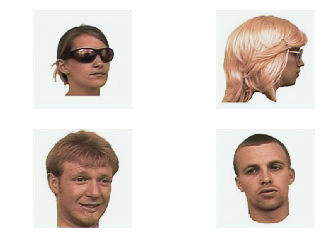

60/60 [==============================] - 1s 16ms/step
[0.0026388471014797688, 1.192093321833454e-07, 0.002638727892190218]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
104/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003048] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

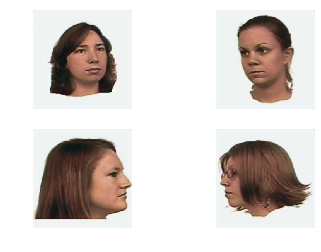

60/60 [==============================] - 1s 16ms/step
[0.002556466792399685, 1.192093321833454e-07, 0.002556347583110134]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
105/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002162] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

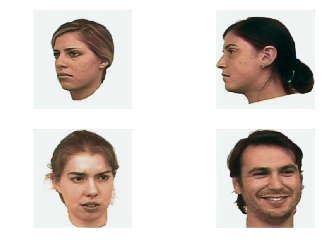

60/60 [==============================] - 1s 16ms/step
[0.0024856360784421363, 1.192093321833454e-07, 0.0024855168691525855]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
106/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002393] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

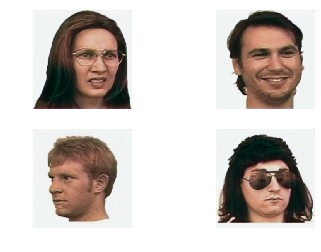

60/60 [==============================] - 1s 16ms/step
[0.002650624777500828, 1.192093321833454e-07, 0.002650505568211277]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
107/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.004892] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

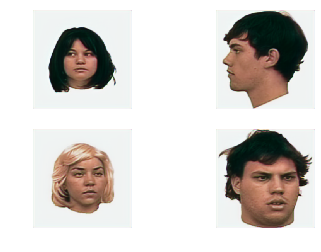

60/60 [==============================] - 1s 16ms/step
[0.0026588396324465674, 1.192093321833454e-07, 0.0026587204231570166]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
108/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002657] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

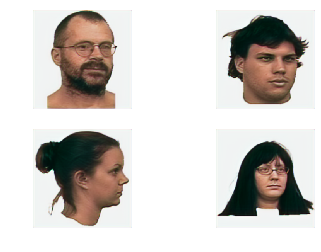

60/60 [==============================] - 1s 16ms/step
[0.002641655985886852, 1.192093321833454e-07, 0.002641536776597301]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
109/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002984] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

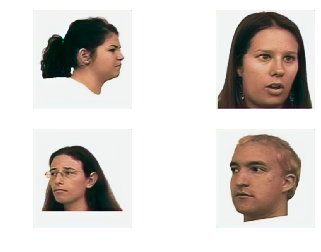

60/60 [==============================] - 1s 16ms/step
[0.002329965385918816, 1.192093321833454e-07, 0.002329846176629265]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
110/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003009] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

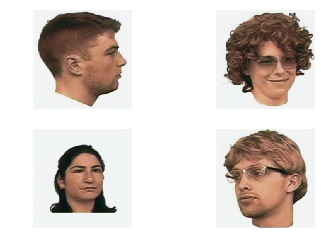

60/60 [==============================] - 1s 16ms/step
[0.002054447711755832, 1.192093321833454e-07, 0.002054328502466281]
d_real: [1.0073811, 0.9375]
d_fake: [15.942385, 0.0]
111/500 [D loss: 8.474883, acc.: 46.88%] [G loss mse: 0.001970] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

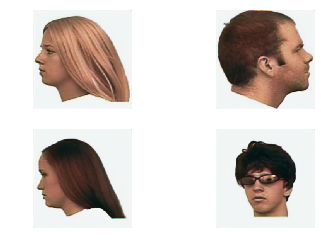

60/60 [==============================] - 1s 16ms/step
[0.001956302369944751, 1.192093321833454e-07, 0.0019561831606552003]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
112/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002305] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

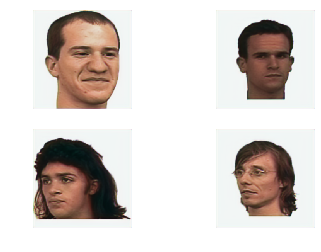

60/60 [==============================] - 1s 16ms/step
[0.0020886555624504886, 1.192093321833454e-07, 0.0020885363531609378]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
113/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002346] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

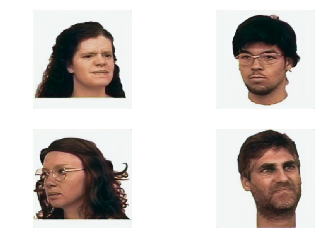

60/60 [==============================] - 1s 16ms/step
[0.002216392351935307, 1.192093321833454e-07, 0.0022162731426457563]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
114/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001934] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

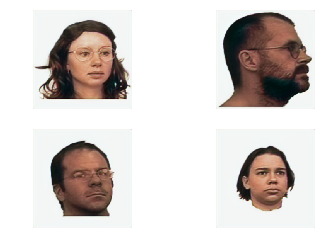

60/60 [==============================] - 1s 16ms/step
[0.002571035549044609, 1.192093321833454e-07, 0.002570916339755058]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
115/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003836] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

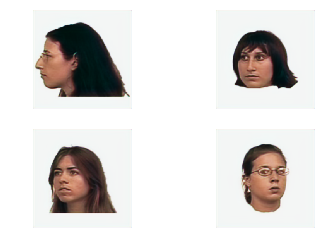

60/60 [==============================] - 1s 16ms/step
[0.0024610765123118956, 1.192093321833454e-07, 0.002460957303022345]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
116/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001944] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

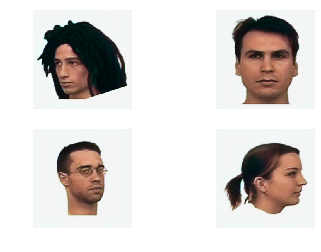

60/60 [==============================] - 1s 16ms/step
[0.002063066403691967, 1.192093321833454e-07, 0.0020629471944024163]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
117/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002288] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

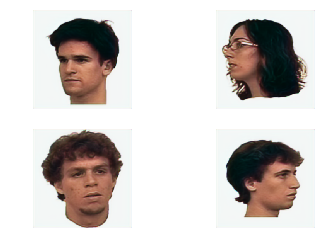

60/60 [==============================] - 1s 16ms/step
[0.0017981025235106547, 1.192093321833454e-07, 0.001797983314221104]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
118/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001933] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

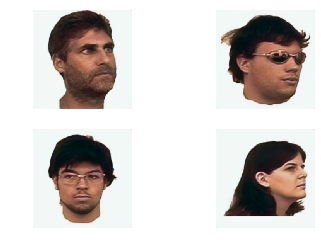

60/60 [==============================] - 1s 16ms/step
[0.0016722730050484338, 1.192093321833454e-07, 0.001672153795758883]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
119/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002990] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

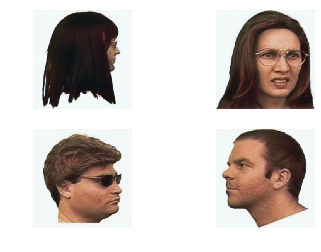

60/60 [==============================] - 1s 16ms/step
[0.0017545531038194895, 1.192093321833454e-07, 0.0017544338945299387]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
120/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003602] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

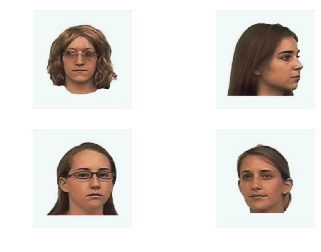

60/60 [==============================] - 1s 16ms/step
[0.0017613976107289395, 1.192093321833454e-07, 0.0017612784014393887]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
121/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001849] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

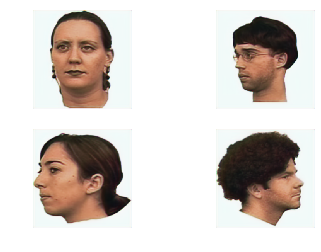

60/60 [==============================] - 1s 16ms/step
[0.0019090285990387202, 1.192093321833454e-07, 0.0019089093897491694]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
122/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003588] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

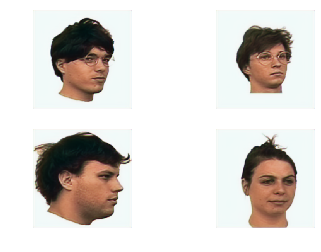

60/60 [==============================] - 1s 16ms/step
[0.002010253576251368, 1.192093321833454e-07, 0.002010134366961817]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
123/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001813] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

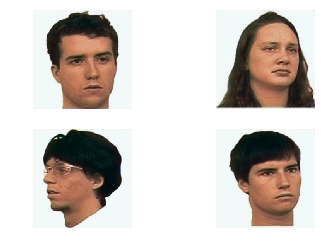

60/60 [==============================] - 1s 16ms/step
[0.0021776915217439335, 1.192093321833454e-07, 0.0021775723124543827]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
124/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002668] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

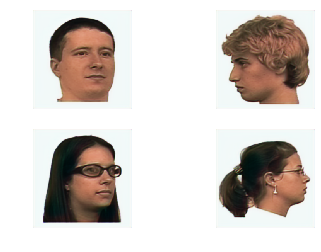

60/60 [==============================] - 1s 16ms/step
[0.002388639748096466, 1.192093321833454e-07, 0.002388520538806915]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
125/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002816] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

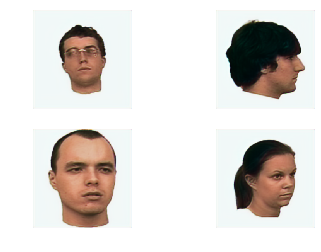

60/60 [==============================] - 1s 16ms/step
[0.0024026012513786556, 1.192093321833454e-07, 0.002402482042089105]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
126/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002115] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

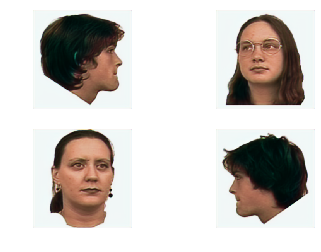

60/60 [==============================] - 1s 16ms/step
[0.0022781445489575467, 1.192093321833454e-07, 0.002278025339667996]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
127/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001821] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

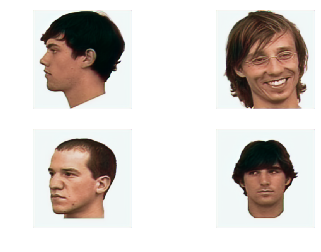

60/60 [==============================] - 1s 16ms/step
[0.0021219962586959203, 1.192093321833454e-07, 0.0021218770494063695]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
128/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002038] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

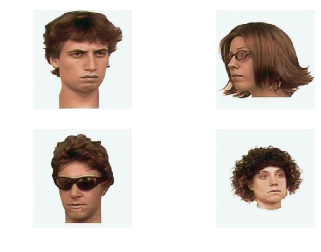

60/60 [==============================] - 1s 16ms/step
[0.0020279863694061834, 1.192093321833454e-07, 0.0020278671601166327]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
129/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002375] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

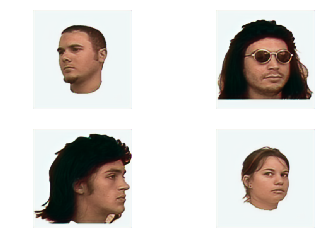

60/60 [==============================] - 1s 16ms/step
[0.001965415353576342, 1.192093321833454e-07, 0.0019652961442867913]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
130/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001863] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

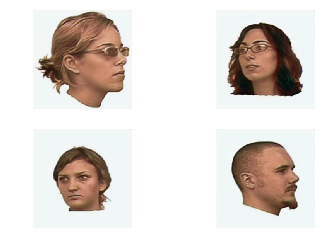

60/60 [==============================] - 1s 16ms/step
[0.0019595479049409428, 1.192093321833454e-07, 0.001959428695651392]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
131/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002110] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

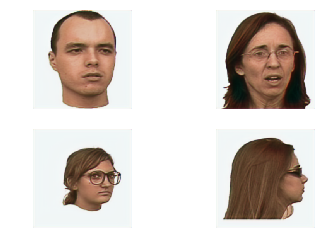

60/60 [==============================] - 1s 16ms/step
[0.0019246588073049983, 1.192093321833454e-07, 0.0019245395980154476]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
132/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001694] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

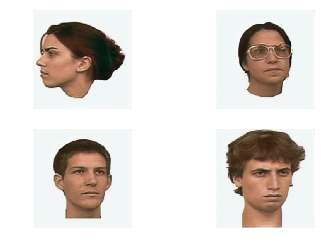

60/60 [==============================] - 1s 16ms/step
[0.0018330997321754695, 1.192093321833454e-07, 0.0018329805228859187]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
133/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002385] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

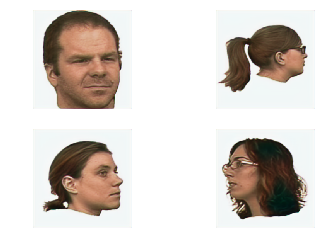

60/60 [==============================] - 1s 16ms/step
[0.001819816146356364, 1.192093321833454e-07, 0.0018196969370668132]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
134/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003421] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

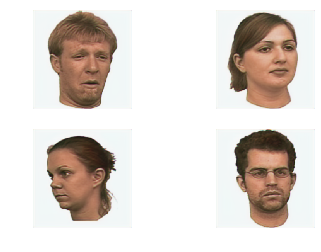

60/60 [==============================] - 1s 16ms/step
[0.001755255227908492, 1.192093321833454e-07, 0.0017551360186189413]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
135/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001948] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

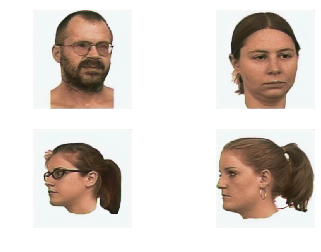

60/60 [==============================] - 1s 16ms/step
[0.001678548528191944, 1.192093321833454e-07, 0.0016784293189023932]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
136/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001996] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

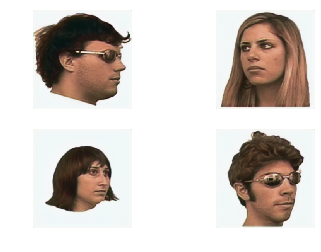

60/60 [==============================] - 1s 16ms/step
[0.0016230399332319697, 1.192093321833454e-07, 0.001622920723942419]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
137/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001966] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

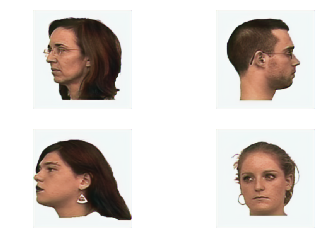

60/60 [==============================] - 1s 16ms/step
[0.0016023409397651752, 1.192093321833454e-07, 0.0016022217304756245]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
138/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002032] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

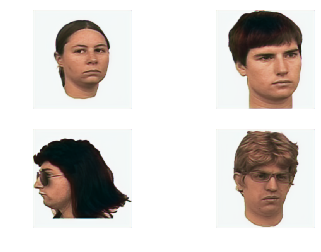

60/60 [==============================] - 1s 16ms/step
[0.001705680717714131, 1.192093321833454e-07, 0.0017055615084245802]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
139/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001805] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

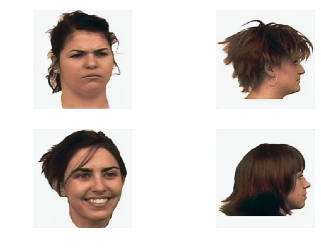

60/60 [==============================] - 1s 16ms/step
[0.001828022914317747, 1.192093321833454e-07, 0.0018279037050281963]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
140/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002315] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

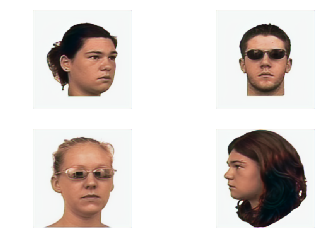

60/60 [==============================] - 1s 16ms/step
[0.0018401629757136106, 1.192093321833454e-07, 0.0018400437664240598]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
141/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002151] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

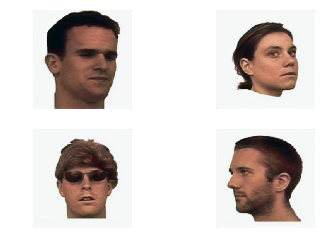

60/60 [==============================] - 1s 16ms/step
[0.0018479402254646022, 1.192093321833454e-07, 0.0018478210161750515]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
142/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002225] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

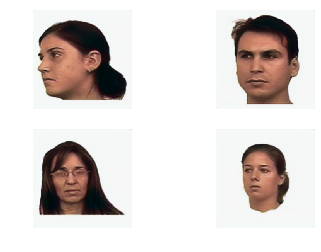

60/60 [==============================] - 1s 16ms/step
[0.0017095817252993583, 1.192093321833454e-07, 0.0017094625160098075]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
143/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001650] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

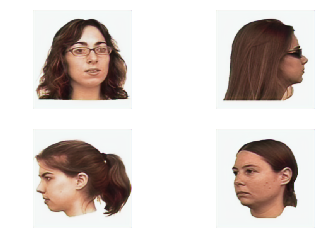

60/60 [==============================] - 1s 16ms/step
[0.001635833418307205, 1.192093321833454e-07, 0.0016357142090176542]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
144/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001794] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

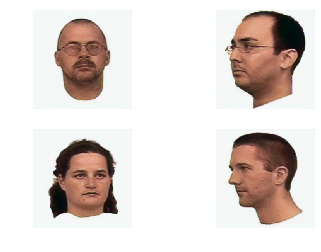

60/60 [==============================] - 1s 16ms/step
[0.0016028100547070304, 1.192093321833454e-07, 0.0016026908454174797]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
145/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002103] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

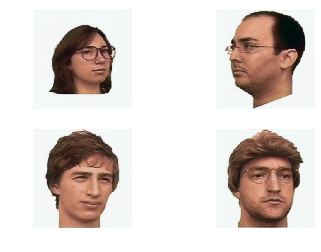

60/60 [==============================] - 1s 16ms/step
[0.0015940027078613639, 1.192093321833454e-07, 0.001593883498571813]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
146/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001897] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

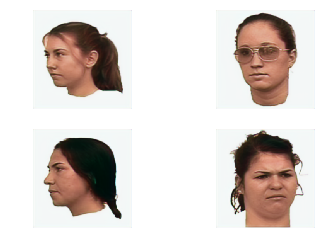

60/60 [==============================] - 1s 16ms/step
[0.0015758155301834147, 1.192093321833454e-07, 0.001575696320893864]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
147/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001754] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

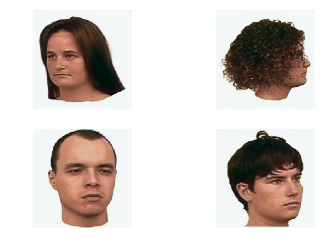

60/60 [==============================] - 1s 16ms/step
[0.0015412206451098124, 1.192093321833454e-07, 0.0015411014358202616]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
148/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001670] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

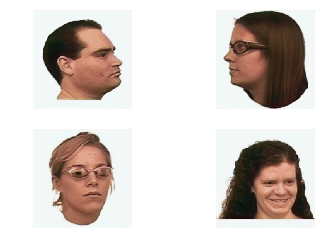

60/60 [==============================] - 1s 16ms/step
[0.0015511844540014863, 1.192093321833454e-07, 0.0015510652447119355]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
149/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001793] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

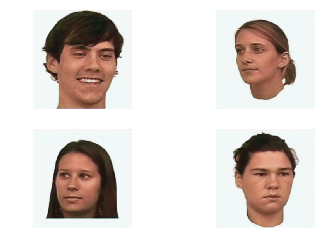

60/60 [==============================] - 1s 16ms/step
[0.0015524914332975944, 1.192093321833454e-07, 0.0015523722240080437]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
150/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001491] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

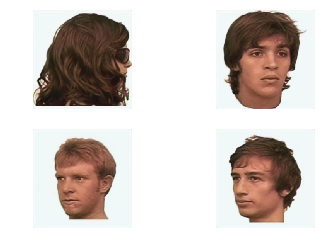

60/60 [==============================] - 1s 16ms/step
[0.0015212194450820486, 1.192093321833454e-07, 0.0015211002357924978]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
151/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001498] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

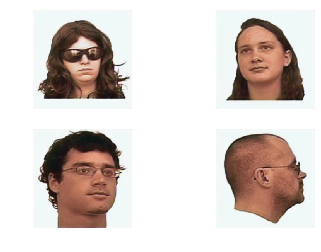

60/60 [==============================] - 1s 16ms/step
[0.0014765847474336625, 1.192093321833454e-07, 0.0014764655381441117]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
152/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001835] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

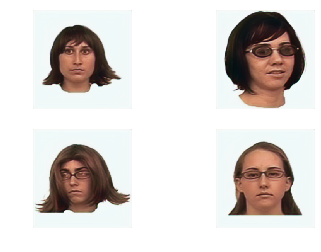

60/60 [==============================] - 1s 16ms/step
[0.0014175094508876403, 1.192093321833454e-07, 0.0014173902415980896]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
153/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001438] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

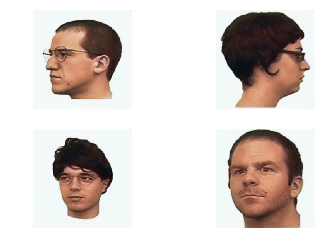

60/60 [==============================] - 1s 16ms/step
[0.0014064375233526032, 1.192093321833454e-07, 0.0014063183140630524]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
154/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001388] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

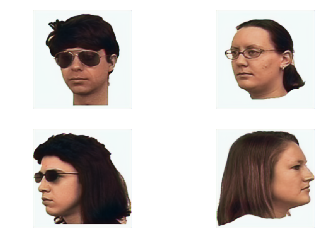

60/60 [==============================] - 1s 16ms/step
[0.0015122442971915006, 1.192093321833454e-07, 0.0015121250879019498]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
155/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001510] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

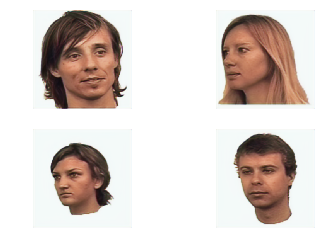

60/60 [==============================] - 1s 16ms/step
[0.0016386115147421756, 1.192093321833454e-07, 0.0016384923054526249]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
156/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001266] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

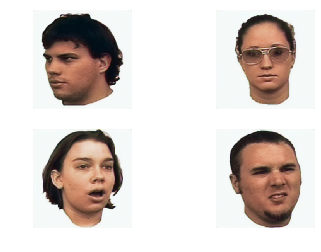

60/60 [==============================] - 1s 16ms/step
[0.0020480184815824033, 1.192093321833454e-07, 0.0020478992722928525]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
157/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003070] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

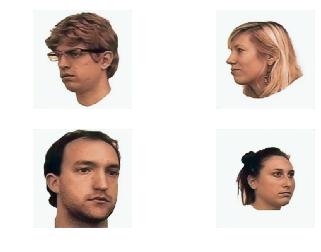

60/60 [==============================] - 1s 16ms/step
[0.0022797667576620975, 1.192093321833454e-07, 0.0022796475483725467]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
158/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001860] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

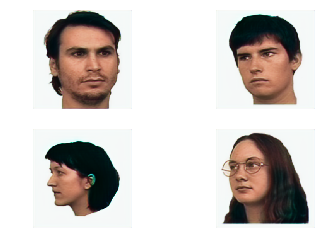

60/60 [==============================] - 1s 16ms/step
[0.002062924594307939, 1.192093321833454e-07, 0.0020628053850183883]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
159/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001418] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

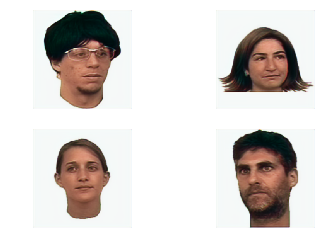

60/60 [==============================] - 1s 16ms/step
[0.0016731598336870471, 1.192093321833454e-07, 0.0016730406243974964]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
160/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001541] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

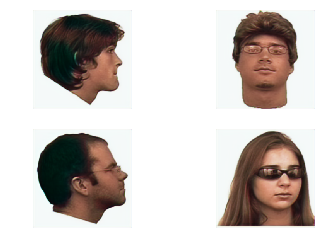

60/60 [==============================] - 1s 16ms/step
[0.001437056305197378, 1.192093321833454e-07, 0.0014369370959078271]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
161/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001575] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

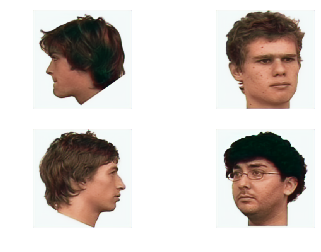

60/60 [==============================] - 1s 16ms/step
[0.0013347294181585312, 1.192093321833454e-07, 0.0013346102088689805]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
162/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001287] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

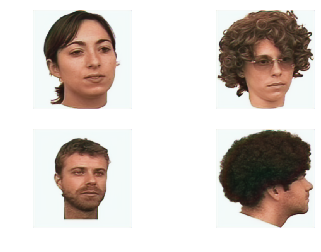

60/60 [==============================] - 1s 16ms/step
[0.0013950291244934003, 1.192093321833454e-07, 0.0013949099152038495]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
163/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001491] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

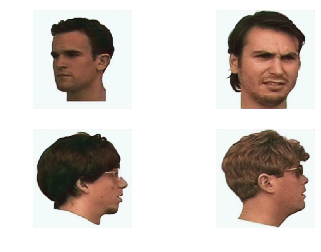

60/60 [==============================] - 1s 16ms/step
[0.0014358985470607876, 1.192093321833454e-07, 0.0014357793377712369]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
164/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001198] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

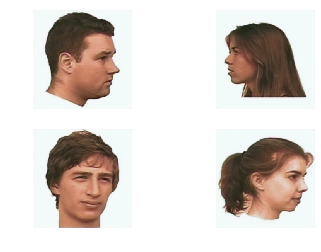

60/60 [==============================] - 1s 16ms/step
[0.0014275141215572755, 1.192093321833454e-07, 0.0014273949122677247]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
165/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001463] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

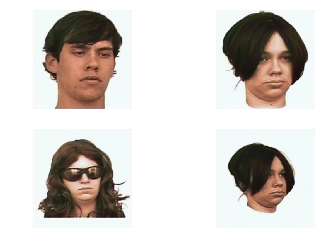

60/60 [==============================] - 1s 16ms/step
[0.0014032643133153517, 1.192093321833454e-07, 0.001403145104025801]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
166/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002110] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

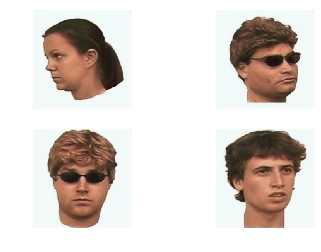

60/60 [==============================] - 1s 16ms/step
[0.0013695651742940149, 1.192093321833454e-07, 0.001369445965004464]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
167/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001236] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

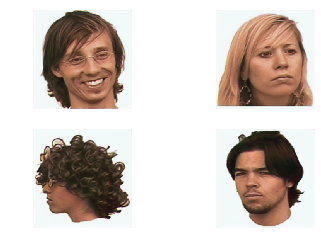

60/60 [==============================] - 1s 16ms/step
[0.0013464121768871943, 1.192093321833454e-07, 0.0013462929675976435]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
168/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001209] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

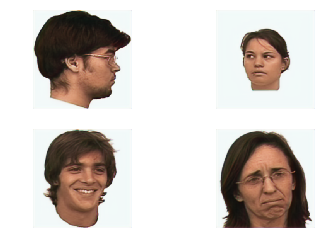

60/60 [==============================] - 1s 16ms/step
[0.0014066946382323901, 1.192093321833454e-07, 0.0014065754289428393]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
169/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002084] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

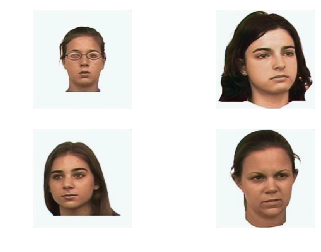

60/60 [==============================] - 1s 16ms/step
[0.0014368148675809303, 1.192093321833454e-07, 0.0014366956582913795]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
170/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001586] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

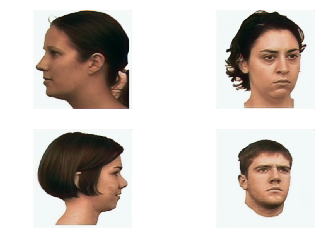

60/60 [==============================] - 1s 16ms/step
[0.0013574409764260053, 1.192093321833454e-07, 0.0013573217671364545]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
171/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001882] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

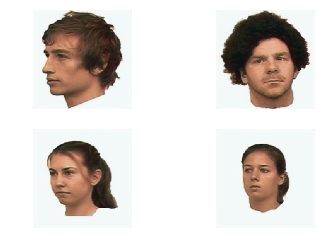

60/60 [==============================] - 1s 16ms/step
[0.0013224494876340031, 1.192093321833454e-07, 0.0013223302783444523]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
172/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001228] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

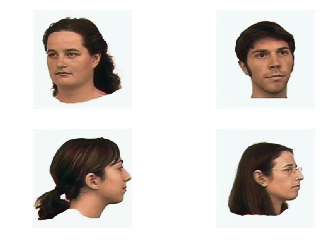

60/60 [==============================] - 1s 16ms/step
[0.0013210753755023082, 1.192093321833454e-07, 0.0013209561662127574]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
173/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001416] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

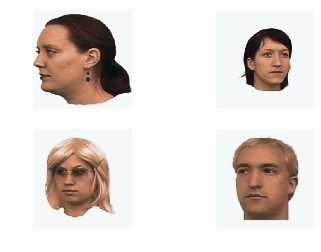

60/60 [==============================] - 1s 16ms/step
[0.0012866108988722166, 1.192093321833454e-07, 0.0012864916895826658]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
174/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001656] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

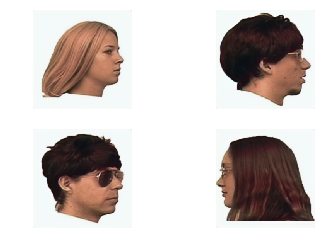

60/60 [==============================] - 1s 16ms/step
[0.0013050056838740905, 1.192093321833454e-07, 0.0013048864745845397]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
175/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001159] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

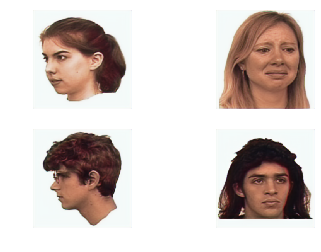

60/60 [==============================] - 1s 16ms/step
[0.0012986896714816492, 1.192093321833454e-07, 0.0012985704621920984]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
176/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001124] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

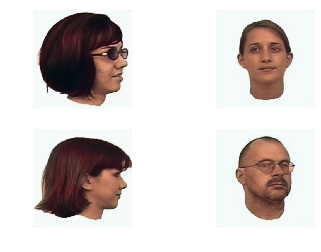

60/60 [==============================] - 1s 16ms/step
[0.0012656037385265033, 1.192093321833454e-07, 0.0012654845292369525]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
177/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001176] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

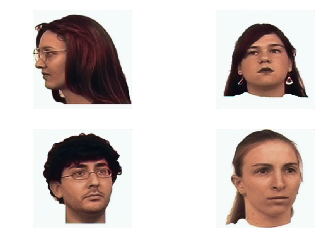

60/60 [==============================] - 1s 16ms/step
[0.001329484721645713, 1.192093321833454e-07, 0.0013293655123561622]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
178/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001367] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

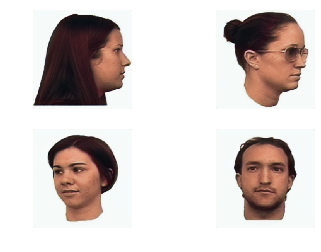

60/60 [==============================] - 1s 16ms/step
[0.0014104988425970078, 1.192093321833454e-07, 0.001410379633307457]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
179/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001598] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

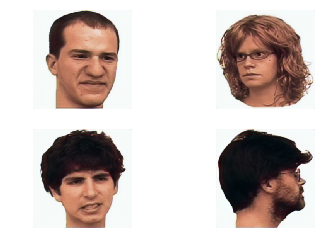

60/60 [==============================] - 1s 16ms/step
[0.0014343196991831065, 1.192093321833454e-07, 0.0014342004898935557]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
180/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001402] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

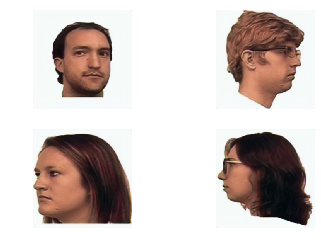

60/60 [==============================] - 1s 16ms/step
[0.0014142274158075452, 1.192093321833454e-07, 0.0014141082065179944]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
181/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001164] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

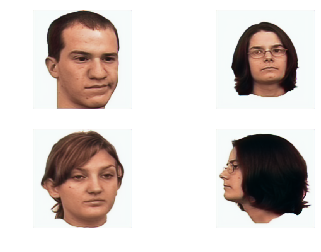

60/60 [==============================] - 1s 16ms/step
[0.001369831501506269, 1.192093321833454e-07, 0.0013697122922167182]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
182/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001183] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

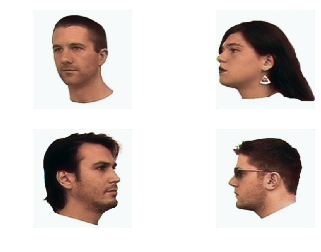

60/60 [==============================] - 1s 16ms/step
[0.0012783436570316554, 1.192093321833454e-07, 0.0012782244477421046]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
183/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001243] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

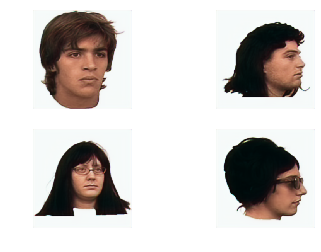

60/60 [==============================] - 1s 16ms/step
[0.0012545475192988912, 1.192093321833454e-07, 0.0012544283100093404]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
184/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001467] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

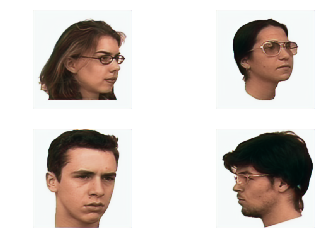

60/60 [==============================] - 1s 16ms/step
[0.0011769062529007593, 1.192093321833454e-07, 0.0011767870436112085]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
185/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001572] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

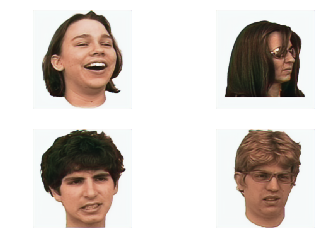

60/60 [==============================] - 1s 16ms/step
[0.0012026471939558783, 1.192093321833454e-07, 0.0012025279846663275]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
186/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001104] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

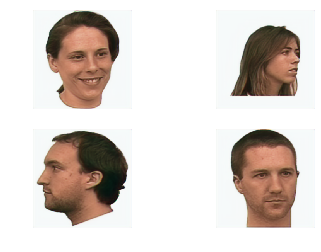

60/60 [==============================] - 1s 16ms/step
[0.0012723376586412391, 1.192093321833454e-07, 0.0012722184493516883]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
187/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001205] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

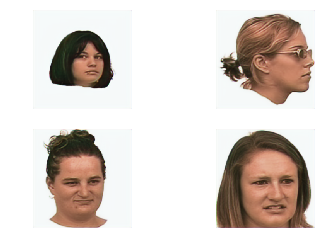

60/60 [==============================] - 1s 16ms/step
[0.0012849830323830246, 1.192093321833454e-07, 0.0012848638230934738]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
188/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002011] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

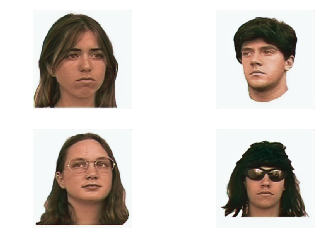

60/60 [==============================] - 1s 16ms/step
[0.001296480877014498, 1.192093321833454e-07, 0.0012963616677249472]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
189/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002096] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

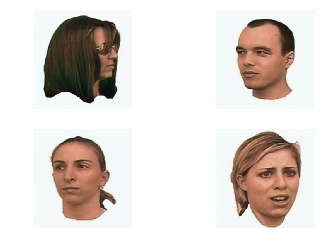

60/60 [==============================] - 1s 16ms/step
[0.001376865974937876, 1.192093321833454e-07, 0.0013767467656483252]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
190/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002008] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

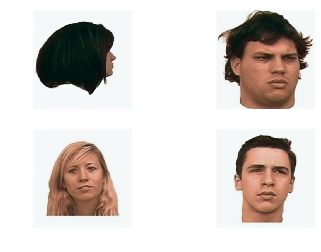

60/60 [==============================] - 1s 16ms/step
[0.001376606042807301, 1.192093321833454e-07, 0.0013764868335177502]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
191/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001129] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

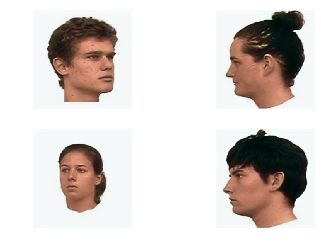

60/60 [==============================] - 1s 16ms/step
[0.0014320251764729619, 1.192093321833454e-07, 0.001431905967183411]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
192/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001431] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

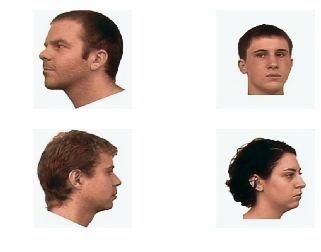

60/60 [==============================] - 1s 16ms/step
[0.001440702254573504, 1.192093321833454e-07, 0.0014405830452839533]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
193/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001361] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

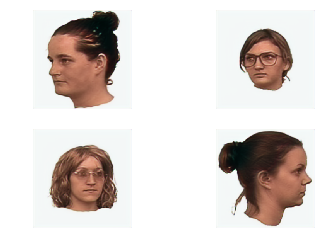

60/60 [==============================] - 1s 16ms/step
[0.0013234883081167936, 1.192093321833454e-07, 0.0013233690988272429]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
194/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001486] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

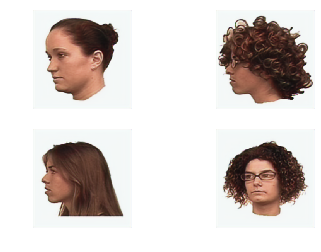

60/60 [==============================] - 1s 16ms/step
[0.0012241698413466414, 1.192093321833454e-07, 0.0012240506320570907]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
195/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001376] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

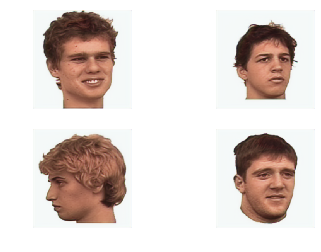

60/60 [==============================] - 1s 16ms/step
[0.0013699264653647938, 1.192093321833454e-07, 0.001369807256075243]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
196/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001723] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

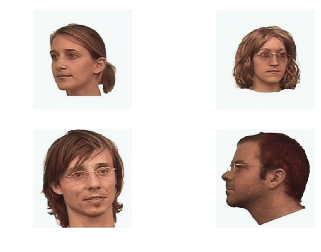

60/60 [==============================] - 1s 16ms/step
[0.0013395331955204407, 1.192093321833454e-07, 0.00133941398623089]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
197/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001365] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

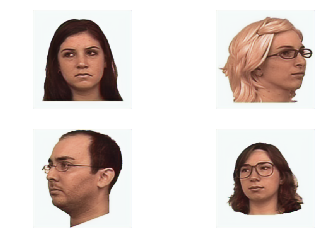

60/60 [==============================] - 1s 16ms/step
[0.0012078391931330164, 1.192093321833454e-07, 0.0012077199838434656]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
198/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001449] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

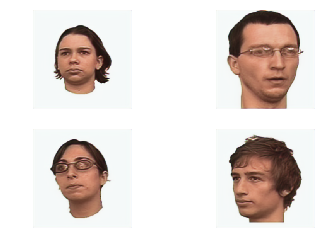

60/60 [==============================] - 1s 16ms/step
[0.0011593338567763567, 1.192093321833454e-07, 0.001159214647486806]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
199/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001182] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

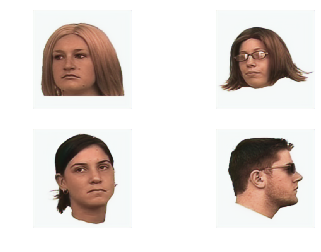

60/60 [==============================] - 1s 16ms/step
[0.0012134521656359234, 1.192093321833454e-07, 0.0012133329563463727]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
200/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001366] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

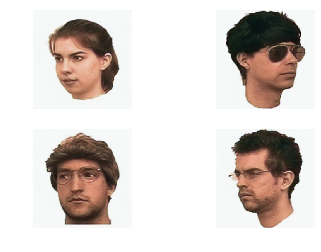

60/60 [==============================] - 1s 16ms/step
[0.0011464282404631376, 1.192093321833454e-07, 0.0011463090311735868]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
201/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001437] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

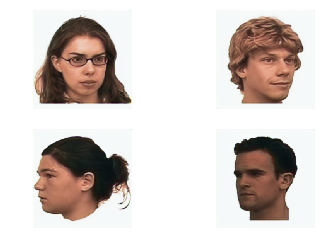

60/60 [==============================] - 1s 16ms/step
[0.00108368129003793, 1.192093321833454e-07, 0.0010835620807483793]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
202/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001446] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

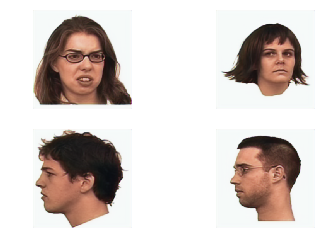

60/60 [==============================] - 1s 16ms/step
[0.0010635942569933831, 1.192093321833454e-07, 0.0010634750477038323]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
203/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001168] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

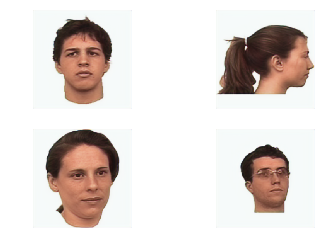

60/60 [==============================] - 1s 16ms/step
[0.0010694212551849583, 1.192093321833454e-07, 0.0010693020458954075]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
204/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001170] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

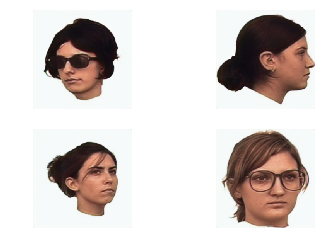

60/60 [==============================] - 1s 16ms/step
[0.001114993030205369, 1.192093321833454e-07, 0.0011148738209158181]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
205/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001297] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

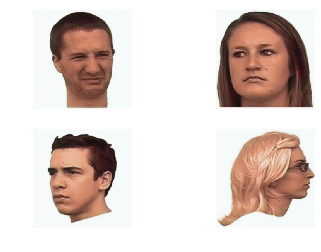

60/60 [==============================] - 1s 16ms/step
[0.0011220345351224145, 1.192093321833454e-07, 0.0011219153258328637]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
206/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001293] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

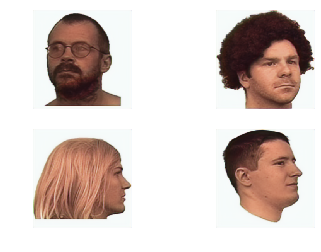

60/60 [==============================] - 1s 16ms/step
[0.0010353426410195728, 1.192093321833454e-07, 0.001035223431730022]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
207/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001275] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

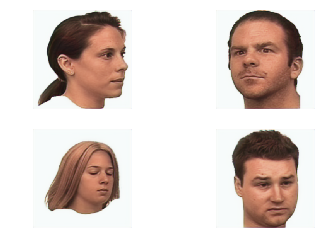

60/60 [==============================] - 1s 16ms/step
[0.001019842344491432, 1.192093321833454e-07, 0.0010197231352018813]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
208/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001457] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

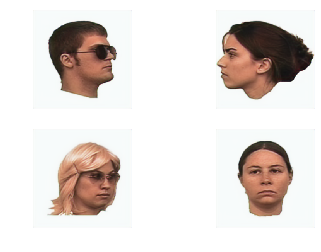

60/60 [==============================] - 1s 16ms/step
[0.0010449314606375993, 1.192093321833454e-07, 0.0010448122513480485]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
209/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001104] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

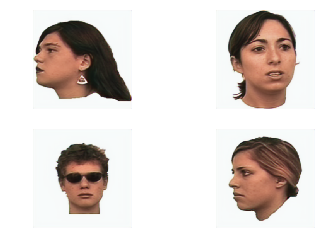

60/60 [==============================] - 1s 16ms/step
[0.0010234813516338667, 1.192093321833454e-07, 0.001023362142344316]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
210/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001053] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

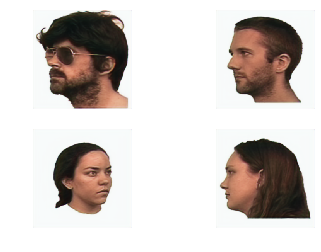

60/60 [==============================] - 1s 16ms/step
[0.001031961280386895, 1.192093321833454e-07, 0.0010318420710973442]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
211/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000982] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

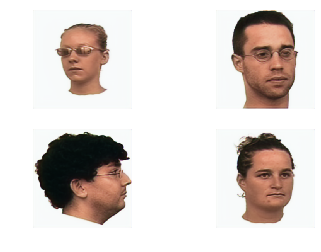

60/60 [==============================] - 1s 16ms/step
[0.0010357265593484045, 1.192093321833454e-07, 0.0010356073500588537]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
212/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000991] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

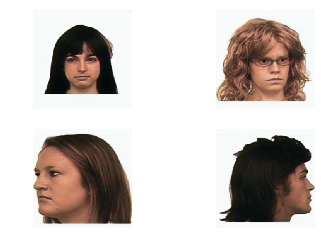

60/60 [==============================] - 1s 16ms/step
[0.0010146476600008706, 1.192093321833454e-07, 0.0010145284507113198]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
213/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000909] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

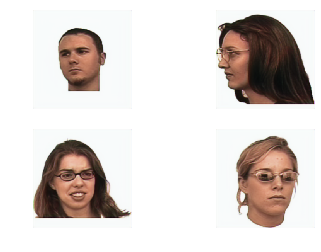

60/60 [==============================] - 1s 16ms/step
[0.001016100236059477, 1.192093321833454e-07, 0.0010159810267699261]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
214/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001139] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

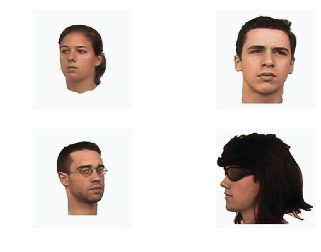

60/60 [==============================] - 1s 16ms/step
[0.0010411100384468833, 1.192093321833454e-07, 0.0010409908291573325]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
215/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001181] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

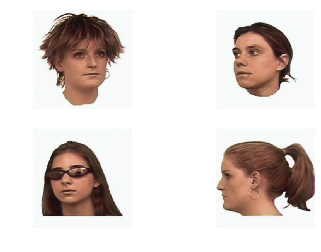

60/60 [==============================] - 1s 16ms/step
[0.0011084692164634665, 1.192093321833454e-07, 0.0011083500071739157]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
216/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001208] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

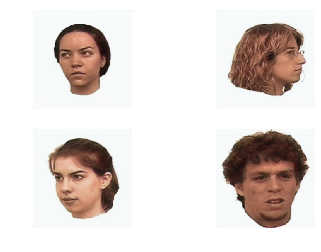

60/60 [==============================] - 1s 16ms/step
[0.001233021472580731, 1.192093321833454e-07, 0.0012329022632911802]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
217/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001184] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

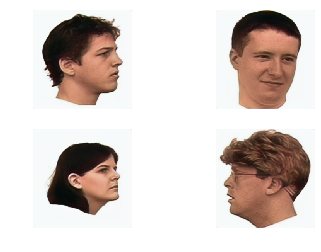

60/60 [==============================] - 1s 16ms/step
[0.0012406168583159645, 1.192093321833454e-07, 0.0012404976490264137]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
218/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001137] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

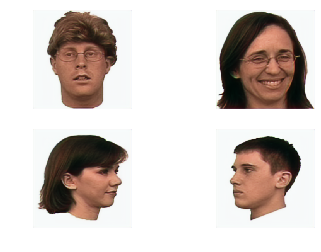

60/60 [==============================] - 1s 16ms/step
[0.0011775273984918992, 1.192093321833454e-07, 0.0011774081892023485]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
219/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001503] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

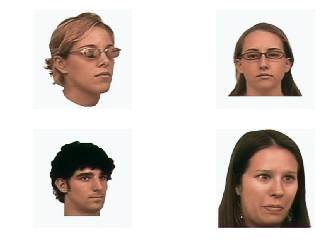

60/60 [==============================] - 1s 16ms/step
[0.0011720495065674185, 1.192093321833454e-07, 0.0011719302972778678]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
220/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000933] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

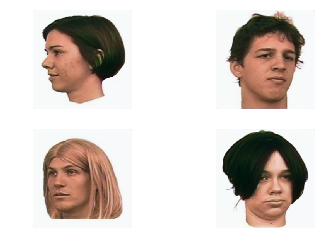

60/60 [==============================] - 1s 16ms/step
[0.0012249886135881146, 1.192093321833454e-07, 0.0012248694042985638]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
221/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001445] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

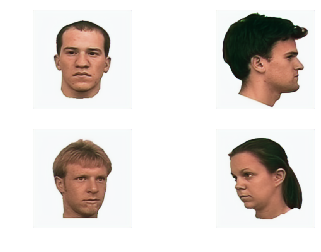

60/60 [==============================] - 1s 16ms/step
[0.001184332378519078, 1.192093321833454e-07, 0.0011842131692295272]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
222/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001292] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

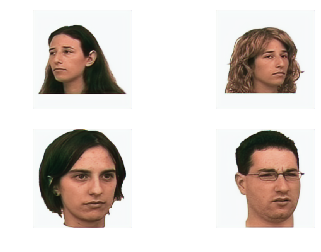

60/60 [==============================] - 1s 16ms/step
[0.0010760734711463252, 1.192093321833454e-07, 0.0010759542618567744]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
223/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001085] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

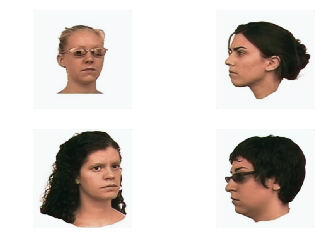

60/60 [==============================] - 1s 16ms/step
[0.0010113789273115497, 1.192093321833454e-07, 0.0010112597180219989]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
224/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000986] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

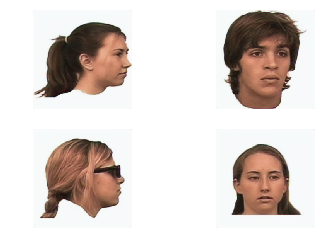

60/60 [==============================] - 1s 16ms/step
[0.001001411936401079, 1.192093321833454e-07, 0.0010012927271115283]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
225/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001038] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

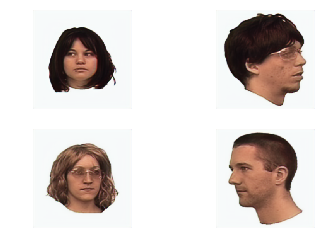

60/60 [==============================] - 1s 16ms/step
[0.0009593064663931727, 1.192093321833454e-07, 0.0009591872571036219]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
226/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001145] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

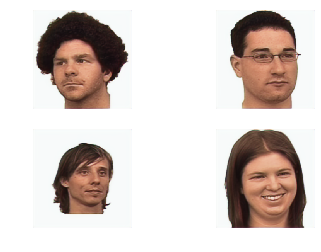

60/60 [==============================] - 1s 16ms/step
[0.0009749866905622185, 1.192093321833454e-07, 0.0009748674812726677]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
227/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001207] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

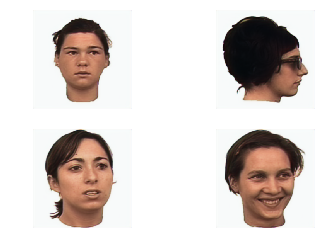

60/60 [==============================] - 1s 16ms/step
[0.0010079060642359157, 1.192093321833454e-07, 0.0010077868549463649]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
228/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001322] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

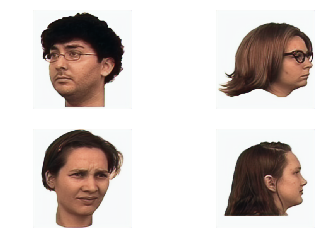

60/60 [==============================] - 1s 16ms/step
[0.0010298335420278212, 1.192093321833454e-07, 0.0010297143327382705]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
229/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001013] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

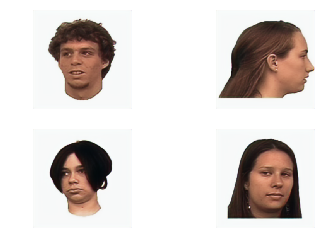

60/60 [==============================] - 1s 16ms/step
[0.001079615190004309, 1.192093321833454e-07, 0.0010794959807147583]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
230/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001161] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

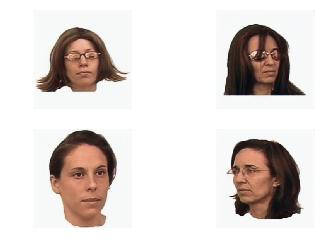

60/60 [==============================] - 1s 16ms/step
[0.001119479862973094, 1.192093321833454e-07, 0.0011193606536835433]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
231/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001015] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

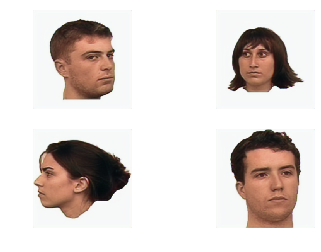

60/60 [==============================] - 1s 16ms/step
[0.0011741236938784519, 1.192093321833454e-07, 0.001174004484588901]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
232/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001093] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

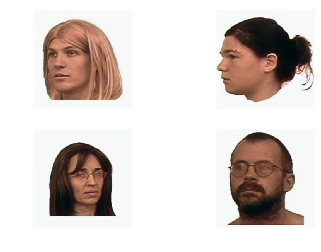

60/60 [==============================] - 1s 16ms/step
[0.0011648943647742272, 1.192093321833454e-07, 0.0011647751554846764]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
233/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001120] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

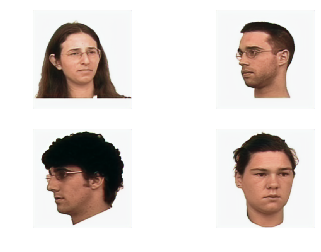

60/60 [==============================] - 1s 16ms/step
[0.001070884196087718, 1.192093321833454e-07, 0.0010707649867981671]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
234/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001309] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

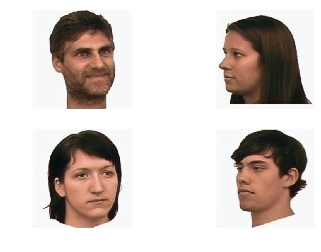

60/60 [==============================] - 1s 16ms/step
[0.0010061756319676837, 1.192093321833454e-07, 0.001006056422678133]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
235/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001591] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

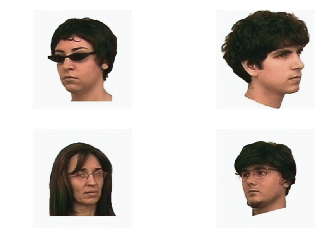

60/60 [==============================] - 1s 16ms/step
[0.0009630887536332012, 1.192093321833454e-07, 0.0009629695443436504]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
236/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001141] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

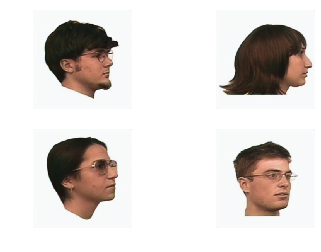

60/60 [==============================] - 1s 16ms/step
[0.0009664538665674627, 1.192093321833454e-07, 0.0009663346572779119]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
237/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001166] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

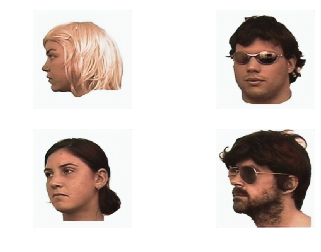

60/60 [==============================] - 1s 16ms/step
[0.001028575247619301, 1.192093321833454e-07, 0.0010284560383297503]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
238/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001872] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

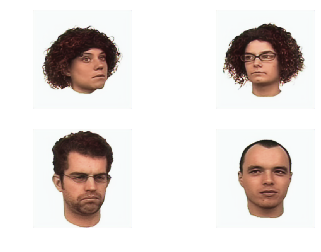

60/60 [==============================] - 1s 16ms/step
[0.0010896223053957026, 1.192093321833454e-07, 0.0010895030961061518]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
239/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001259] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

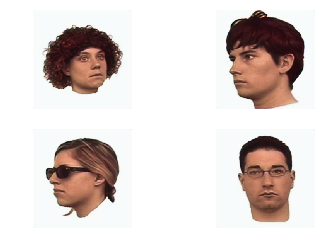

60/60 [==============================] - 1s 16ms/step
[0.0011960633099079132, 1.192093321833454e-07, 0.0011959441006183624]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
240/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001103] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

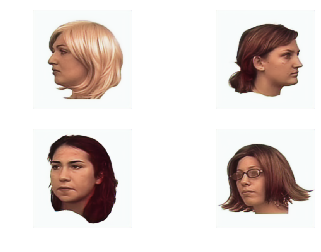

60/60 [==============================] - 1s 16ms/step
[0.0011174104797343413, 1.192093321833454e-07, 0.0011172912704447906]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
241/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001123] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

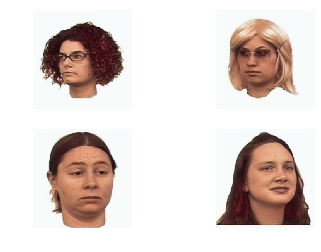

60/60 [==============================] - 1s 16ms/step
[0.001097762972737352, 1.192093321833454e-07, 0.0010976437634478012]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
242/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002444] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

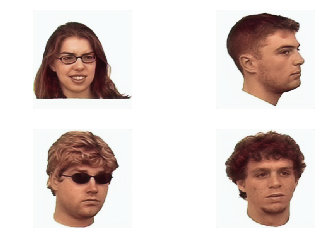

60/60 [==============================] - 1s 16ms/step
[0.001142915532303353, 1.192093321833454e-07, 0.0011427963230138023]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
243/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001707] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

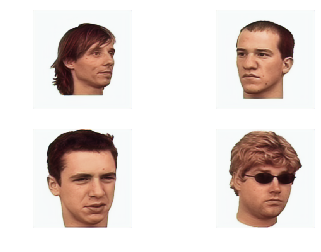

60/60 [==============================] - 1s 16ms/step
[0.0012206745101138949, 1.192093321833454e-07, 0.001220555300824344]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
244/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001073] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

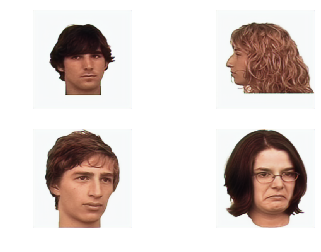

60/60 [==============================] - 1s 16ms/step
[0.0012783176498487592, 1.192093321833454e-07, 0.0012781984405592084]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
245/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001214] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

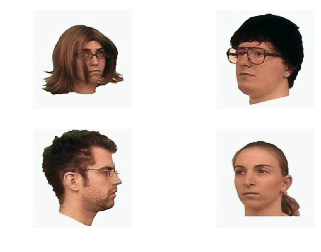

60/60 [==============================] - 1s 16ms/step
[0.001281244222385188, 1.192093321833454e-07, 0.0012811250130956371]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
246/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001148] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

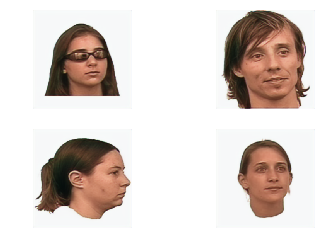

60/60 [==============================] - 1s 16ms/step
[0.0013087390223518014, 1.192093321833454e-07, 0.0013086198130622506]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
247/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000967] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

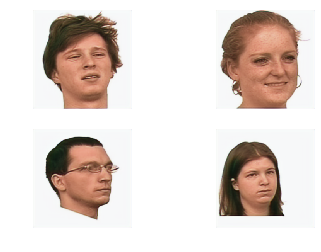

60/60 [==============================] - 1s 16ms/step
[0.0013158252695575356, 1.192093321833454e-07, 0.0013157060602679849]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
248/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001057] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

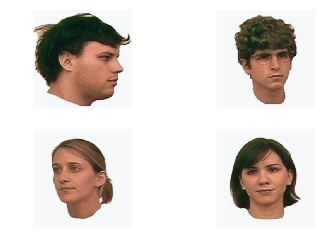

60/60 [==============================] - 1s 16ms/step
[0.001232150134940942, 1.192093321833454e-07, 0.0012320309256513913]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
249/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002424] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

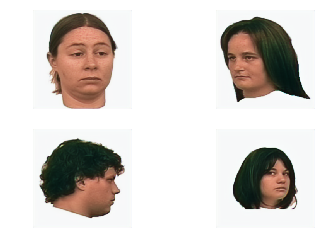

60/60 [==============================] - 1s 16ms/step
[0.0010465725829514364, 1.192093321833454e-07, 0.0010464533736618856]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
250/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001387] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

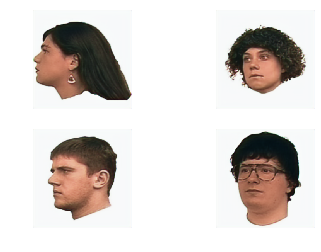

60/60 [==============================] - 1s 16ms/step
[0.0010360196970092754, 1.192093321833454e-07, 0.0010359004877197246]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
251/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001957] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

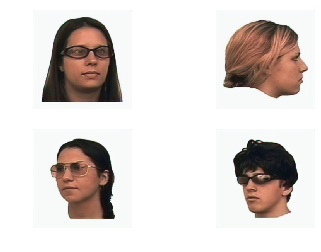

60/60 [==============================] - 1s 16ms/step
[0.0011505091795697808, 1.192093321833454e-07, 0.00115038997028023]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
252/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001022] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

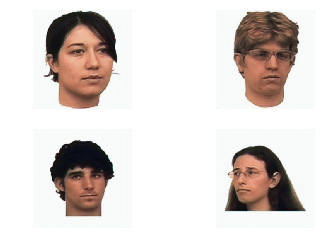

60/60 [==============================] - 1s 16ms/step
[0.0013030595999831954, 1.192093321833454e-07, 0.0013029403906936446]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
253/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001046] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

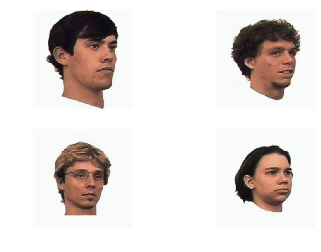

60/60 [==============================] - 1s 16ms/step
[0.0013810370505476992, 1.192093321833454e-07, 0.0013809178412581484]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
254/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001135] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

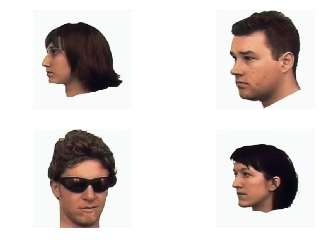

60/60 [==============================] - 1s 16ms/step
[0.0013837042109419901, 1.192093321833454e-07, 0.0013835850016524394]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
255/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001366] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

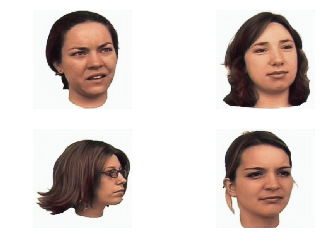

60/60 [==============================] - 1s 16ms/step
[0.0012901176931336522, 1.192093321833454e-07, 0.0012899984838441014]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
256/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001114] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

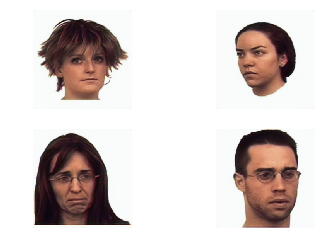

60/60 [==============================] - 1s 16ms/step
[0.0012450946572547157, 1.192093321833454e-07, 0.001244975447965165]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
257/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002021] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

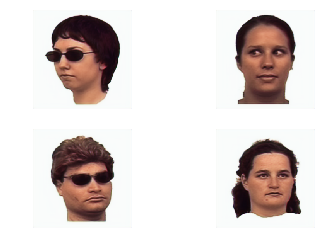

60/60 [==============================] - 1s 16ms/step
[0.0010984229700018962, 1.192093321833454e-07, 0.0010983037607123455]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
258/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001537] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

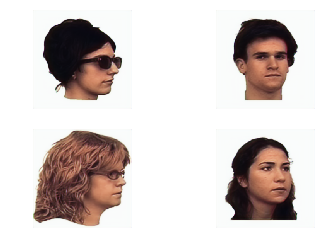

60/60 [==============================] - 1s 16ms/step
[0.0010877215613921483, 1.192093321833454e-07, 0.0010876023521025975]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
259/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000956] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

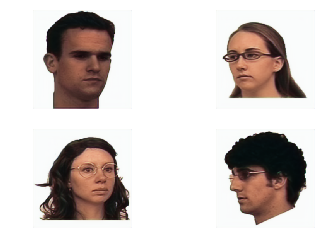

60/60 [==============================] - 1s 16ms/step
[0.0011224924897154172, 1.192093321833454e-07, 0.0011223732804258664]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
260/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001407] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

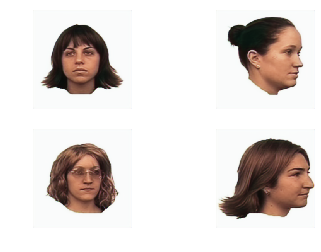

60/60 [==============================] - 1s 16ms/step
[0.0010993114750211437, 1.192093321833454e-07, 0.001099192265731593]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
261/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000925] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

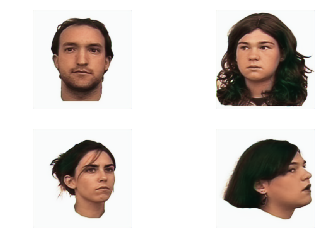

60/60 [==============================] - 1s 16ms/step
[0.0010759964352473617, 1.192093321833454e-07, 0.0010758772259578109]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
262/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000943] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

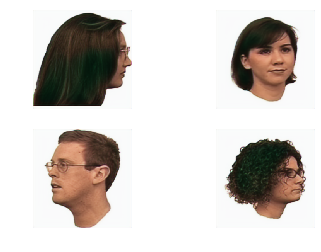

60/60 [==============================] - 1s 16ms/step
[0.0010962418513372541, 1.192093321833454e-07, 0.0010961226420477034]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
263/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002092] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

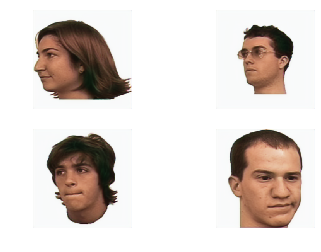

60/60 [==============================] - 1s 16ms/step
[0.0011236326303333045, 1.192093321833454e-07, 0.0011235134210437537]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
264/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001124] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

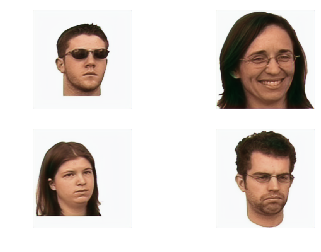

60/60 [==============================] - 1s 16ms/step
[0.001130523276515305, 1.192093321833454e-07, 0.0011304040672257543]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
265/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001085] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

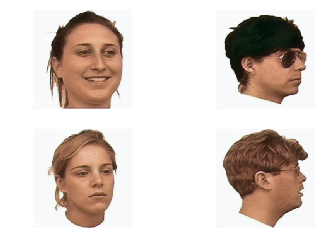

60/60 [==============================] - 1s 16ms/step
[0.0011510808641711872, 1.192093321833454e-07, 0.0011509616548816364]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
266/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001137] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

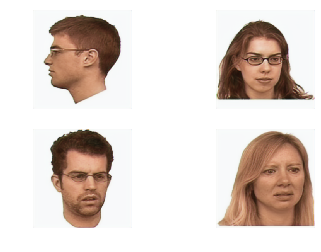

60/60 [==============================] - 1s 16ms/step
[0.0011952847397575775, 1.192093321833454e-07, 0.0011951655304680267]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
267/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001316] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

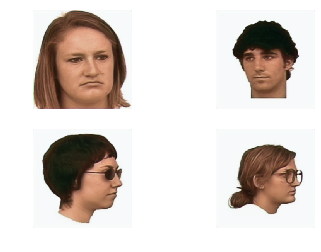

60/60 [==============================] - 1s 16ms/step
[0.0011971186691274245, 1.192093321833454e-07, 0.0011969994598378737]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
268/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001236] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

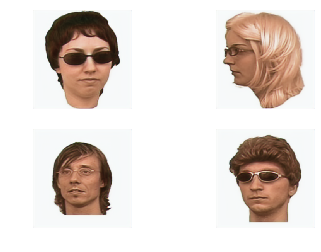

60/60 [==============================] - 1s 16ms/step
[0.0011560986361776788, 1.192093321833454e-07, 0.001155979426888128]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
269/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001013] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

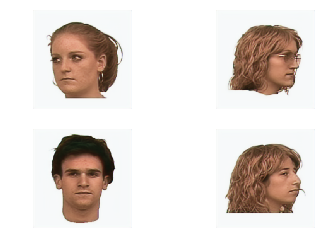

60/60 [==============================] - 1s 16ms/step
[0.0010948681350176532, 1.192093321833454e-07, 0.0010947489257281025]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
270/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001042] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

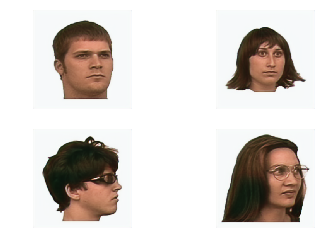

60/60 [==============================] - 1s 16ms/step
[0.0010191611285942296, 1.192093321833454e-07, 0.0010190419193046789]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
271/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001030] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

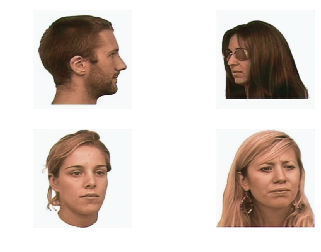

60/60 [==============================] - 1s 16ms/step
[0.000957854522857815, 1.192093321833454e-07, 0.0009577353135682643]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
272/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000964] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

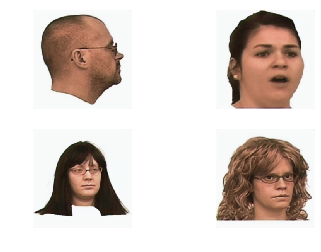

60/60 [==============================] - 1s 16ms/step
[0.0009482106232705216, 1.192093321833454e-07, 0.0009480914139809708]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
273/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001594] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

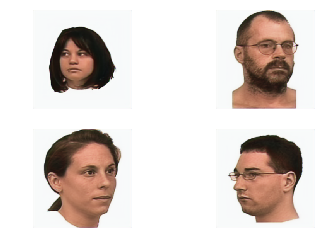

60/60 [==============================] - 1s 16ms/step
[0.0009529130494532486, 1.192093321833454e-07, 0.0009527938401636978]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
274/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000859] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

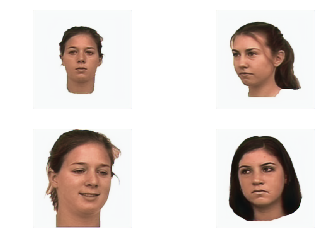

60/60 [==============================] - 1s 16ms/step
[0.0009837364118235807, 1.192093321833454e-07, 0.00098361720253403]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
275/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000993] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

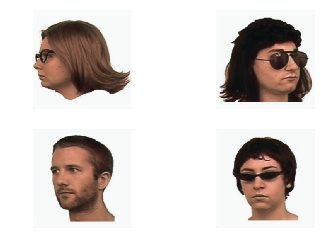

60/60 [==============================] - 1s 16ms/step
[0.0010406833219652374, 1.192093321833454e-07, 0.0010405641126756866]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
276/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001449] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

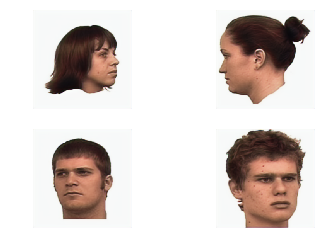

60/60 [==============================] - 1s 16ms/step
[0.0009792765718884765, 1.192093321833454e-07, 0.0009791573625989257]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
277/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001164] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

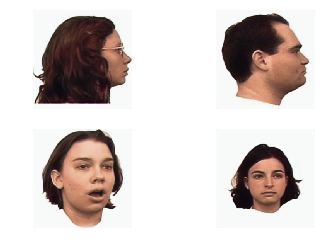

60/60 [==============================] - 1s 16ms/step
[0.0009198593907058239, 1.192093321833454e-07, 0.0009197401814162731]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
278/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000978] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

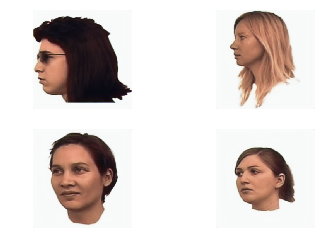

60/60 [==============================] - 1s 16ms/step
[0.0009134005405940116, 1.192093321833454e-07, 0.0009132813313044608]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
279/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000826] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

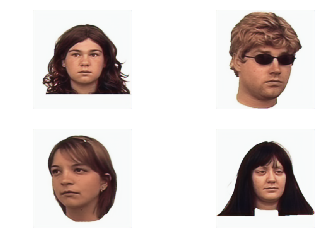

60/60 [==============================] - 1s 16ms/step
[0.0009116616371708611, 1.192093321833454e-07, 0.0009115424278813103]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
280/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001173] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

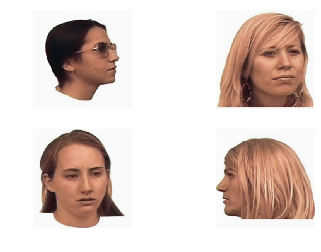

60/60 [==============================] - 1s 16ms/step
[0.0009227618225850165, 1.192093321833454e-07, 0.0009226426132954657]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
281/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001019] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

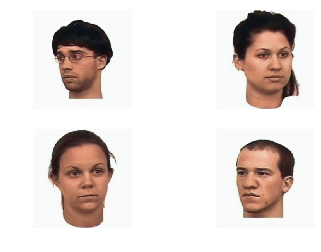

60/60 [==============================] - 1s 16ms/step
[0.0009593081621763606, 1.192093321833454e-07, 0.0009591889528868099]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
282/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000919] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

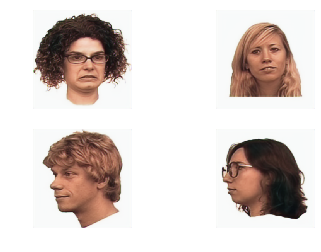

60/60 [==============================] - 1s 16ms/step
[0.0009573295169199507, 1.192093321833454e-07, 0.0009572103076303999]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
283/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001092] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

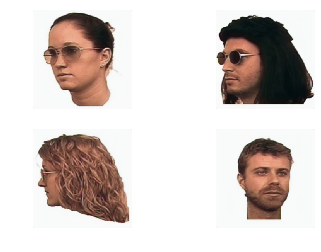

60/60 [==============================] - 1s 16ms/step
[0.0009427610745963951, 1.192093321833454e-07, 0.0009426418653068443]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
284/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000875] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

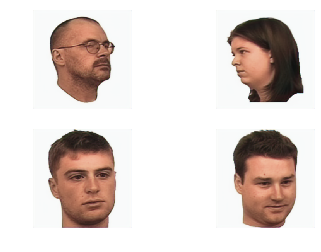

60/60 [==============================] - 1s 16ms/step
[0.0008972248605762918, 1.192093321833454e-07, 0.000897105651286741]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
285/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000985] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

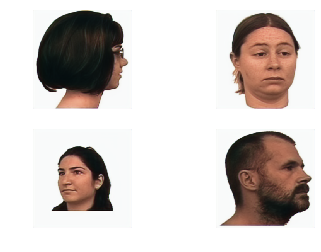

60/60 [==============================] - 1s 16ms/step
[0.0008624144558173915, 1.192093321833454e-07, 0.0008622952465278407]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
286/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001102] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

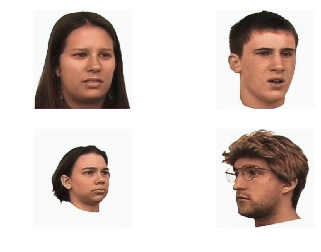

60/60 [==============================] - 1s 16ms/step
[0.0008454397049111624, 1.192093321833454e-07, 0.0008453204956216117]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
287/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000864] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

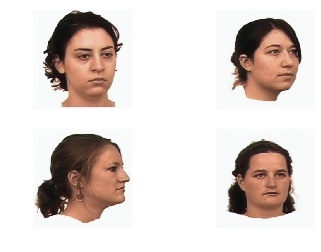

60/60 [==============================] - 1s 16ms/step
[0.0008353910835770269, 1.192093321833454e-07, 0.0008352718742874761]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
288/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001888] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

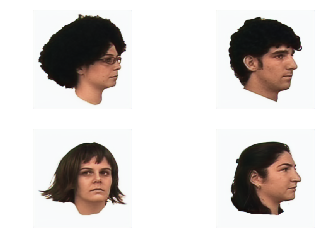

60/60 [==============================] - 1s 16ms/step
[0.000843816960696131, 1.192093321833454e-07, 0.0008436977514065802]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
289/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000815] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

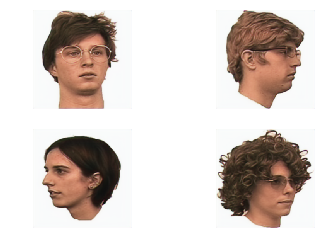

60/60 [==============================] - 1s 16ms/step
[0.0008571194407219688, 1.192093321833454e-07, 0.0008570002314324181]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
290/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001411] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

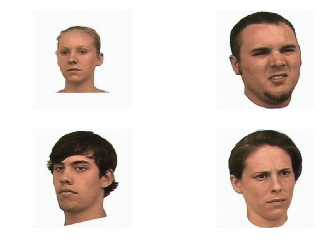

60/60 [==============================] - 1s 16ms/step
[0.0008617707217733066, 1.192093321833454e-07, 0.0008616515124837558]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
291/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001811] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

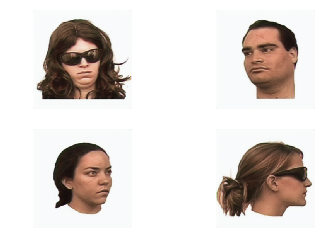

60/60 [==============================] - 1s 16ms/step
[0.0008514083262222508, 1.192093321833454e-07, 0.0008512891169327]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
292/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000943] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

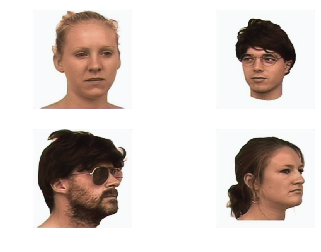

60/60 [==============================] - 1s 16ms/step
[0.0008359541456835966, 1.192093321833454e-07, 0.0008358349363940458]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
293/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000936] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

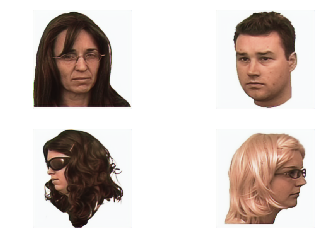

60/60 [==============================] - 1s 16ms/step
[0.0008217584108933806, 1.192093321833454e-07, 0.0008216392016038299]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
294/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000797] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

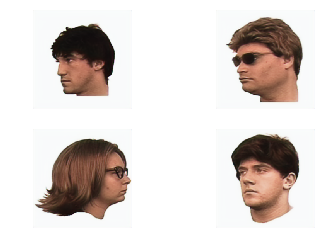

60/60 [==============================] - 1s 16ms/step
[0.0008357001468539238, 1.192093321833454e-07, 0.000835580937564373]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
295/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 1.008653] [G loss bce: 1.007381]


<Figure size 432x288 with 0 Axes>

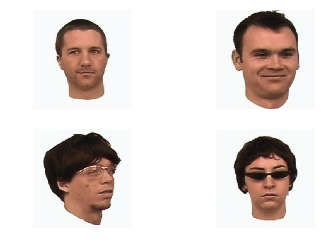

60/60 [==============================] - 1s 16ms/step
[0.0008588826206202308, 1.192093321833454e-07, 0.00085876341133068]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
296/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001011] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

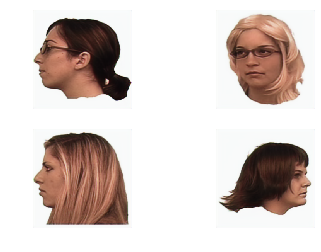

60/60 [==============================] - 1s 16ms/step
[0.0008953601975614826, 1.192093321833454e-07, 0.0008952409882719318]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
297/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000794] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

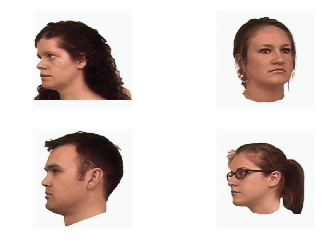

60/60 [==============================] - 1s 16ms/step
[0.00090256966650486, 1.192093321833454e-07, 0.0009024504572153092]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
298/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000910] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

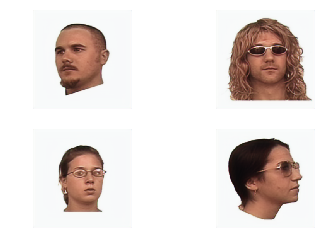

60/60 [==============================] - 1s 16ms/step
[0.0008429935628858705, 1.192093321833454e-07, 0.0008428743535963197]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
299/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001608] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

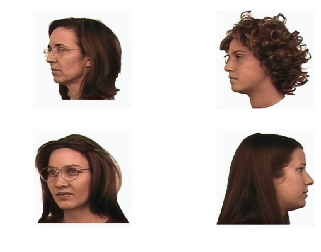

60/60 [==============================] - 1s 16ms/step
[0.0008304193809938928, 1.192093321833454e-07, 0.000830300171704342]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
300/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001672] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

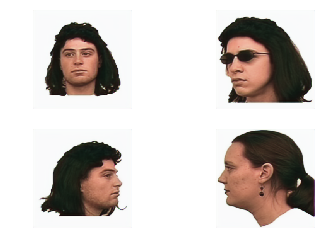

60/60 [==============================] - 1s 16ms/step
[0.0008632571009608606, 1.192093321833454e-07, 0.0008631378916713099]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
301/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000763] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

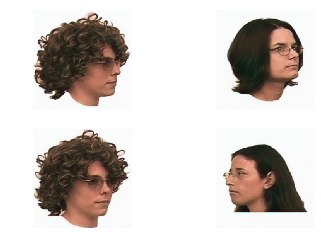

60/60 [==============================] - 1s 16ms/step
[0.0008641836466267705, 1.192093321833454e-07, 0.0008640644373372197]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
302/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001085] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

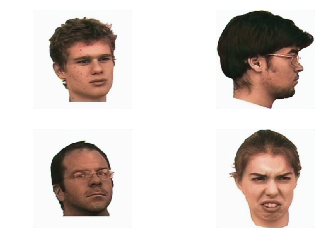

60/60 [==============================] - 1s 16ms/step
[0.0008728074880006413, 1.192093321833454e-07, 0.0008726882787110905]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
303/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000901] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

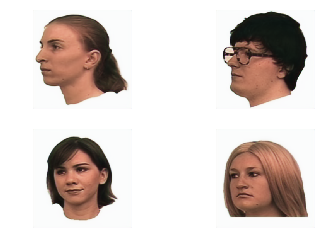

60/60 [==============================] - 1s 16ms/step
[0.0008778959629125894, 1.192093321833454e-07, 0.0008777767536230386]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
304/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002446] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

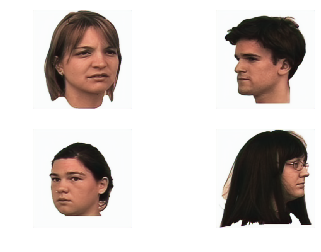

60/60 [==============================] - 1s 16ms/step
[0.0009765269312386712, 1.192093321833454e-07, 0.0009764077219491204]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
305/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001795] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

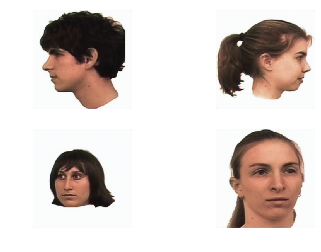

60/60 [==============================] - 1s 16ms/step
[0.0010734540410339832, 1.192093321833454e-07, 0.0010733348317444324]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
306/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001595] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

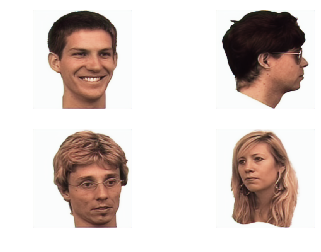

60/60 [==============================] - 1s 16ms/step
[0.0010777843107158938, 1.192093321833454e-07, 0.001077665101426343]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
307/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000820] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

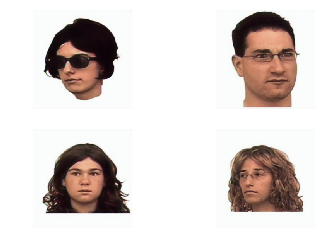

60/60 [==============================] - 1s 16ms/step
[0.00112161742678533, 1.192093321833454e-07, 0.0011214982174957793]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
308/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001016] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

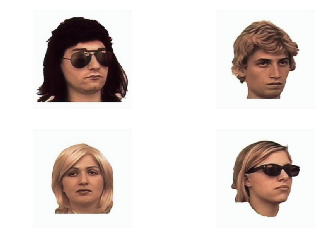

60/60 [==============================] - 1s 16ms/step
[0.0010480316278214255, 1.192093321833454e-07, 0.0010479124185318748]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
309/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000887] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

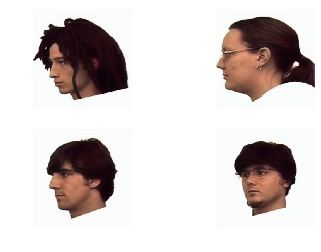

60/60 [==============================] - 1s 16ms/step
[0.0011112640456606945, 1.192093321833454e-07, 0.0011111448363711437]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
310/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001556] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

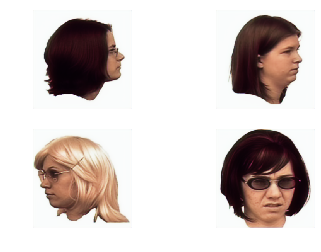

60/60 [==============================] - 1s 16ms/step
[0.0011639644857496024, 1.192093321833454e-07, 0.0011638452764600516]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
311/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001057] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

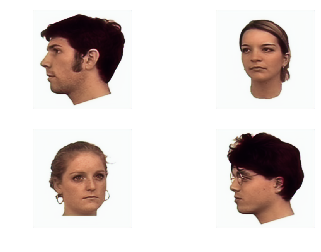

60/60 [==============================] - 1s 16ms/step
[0.0013124631019309162, 1.192093321833454e-07, 0.0013123438926413654]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
312/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001176] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

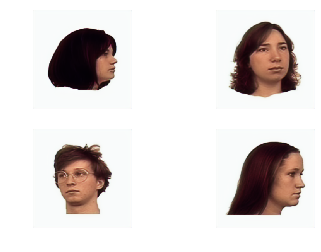

60/60 [==============================] - 1s 16ms/step
[0.0011968833471958835, 1.192093321833454e-07, 0.0011967641379063327]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
313/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001574] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

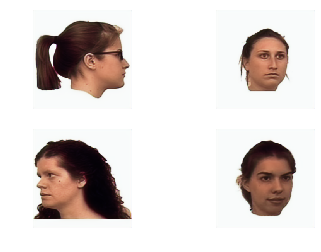

60/60 [==============================] - 1s 16ms/step
[0.001062279373096923, 1.192093321833454e-07, 0.0010621601638073723]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
314/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001064] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

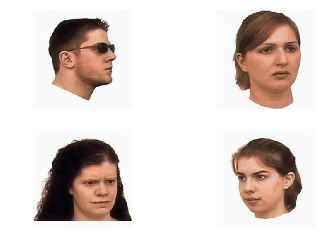

60/60 [==============================] - 1s 16ms/step
[0.0009526252746582031, 1.192093321833454e-07, 0.0009525060653686523]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
315/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000849] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

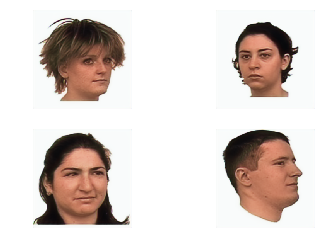

60/60 [==============================] - 1s 16ms/step
[0.0009066365309990942, 1.192093321833454e-07, 0.0009065173217095435]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
316/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000774] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

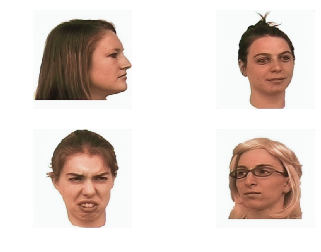

60/60 [==============================] - 1s 16ms/step
[0.0009158886309402685, 1.192093321833454e-07, 0.0009157694216507177]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
317/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001453] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

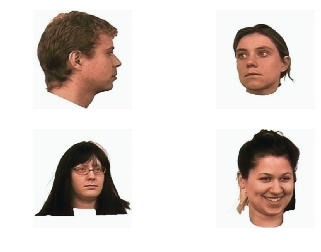

60/60 [==============================] - 1s 16ms/step
[0.00086599140195176, 1.192093321833454e-07, 0.0008658721926622093]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
318/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001098] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

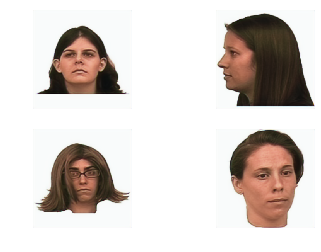

60/60 [==============================] - 1s 16ms/step
[0.0008378397479342918, 1.192093321833454e-07, 0.000837720538644741]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
319/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000855] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

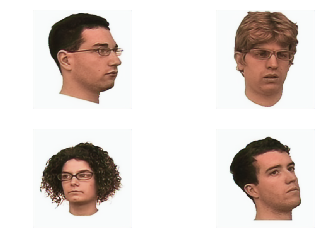

60/60 [==============================] - 1s 16ms/step
[0.0008291249512694776, 1.192093321833454e-07, 0.0008290057419799268]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
320/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001012] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

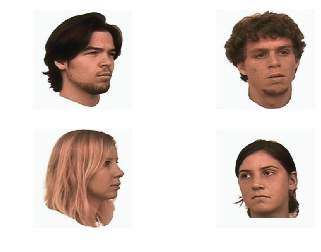

60/60 [==============================] - 1s 16ms/step
[0.0008599875145591795, 1.192093321833454e-07, 0.0008598683052696288]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
321/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001238] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

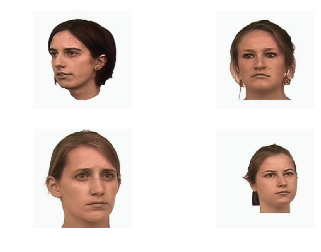

60/60 [==============================] - 1s 16ms/step
[0.0009027354690867166, 1.192093321833454e-07, 0.0009026162597971658]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
322/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000872] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

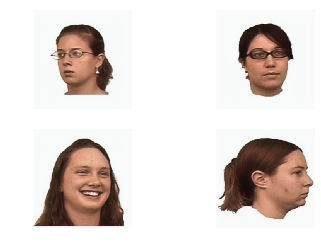

60/60 [==============================] - 1s 16ms/step
[0.0009217798748674492, 1.192093321833454e-07, 0.0009216606655778984]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
323/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001032] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

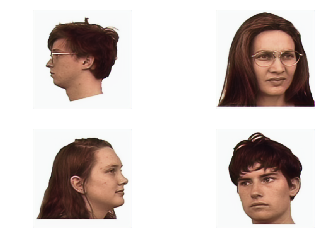

60/60 [==============================] - 1s 16ms/step
[0.0009529033598179618, 1.192093321833454e-07, 0.0009527841505284111]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
324/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000869] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

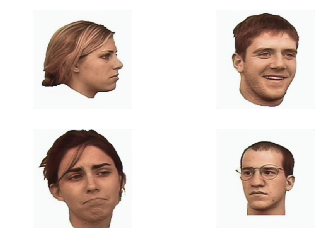

60/60 [==============================] - 1s 16ms/step
[0.0009365648108844956, 1.192093321833454e-07, 0.0009364456015949448]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
325/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000983] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

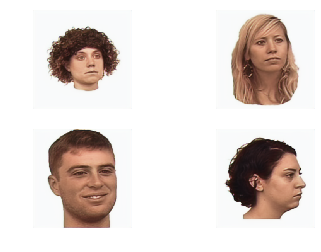

60/60 [==============================] - 1s 16ms/step
[0.0008575471622558931, 1.192093321833454e-07, 0.0008574279529663424]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
326/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000871] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

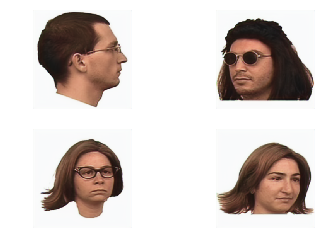

60/60 [==============================] - 1s 16ms/step
[0.0008239167005134125, 1.192093321833454e-07, 0.0008237974912238617]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
327/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001331] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

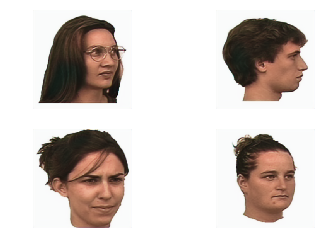

60/60 [==============================] - 1s 16ms/step
[0.0008228330872952939, 1.192093321833454e-07, 0.0008227138780057431]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
328/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000979] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

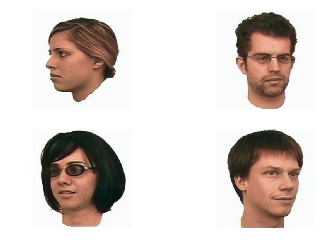

60/60 [==============================] - 1s 16ms/step
[0.000807030425251772, 1.192093321833454e-07, 0.0008069112159622212]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
329/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000906] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

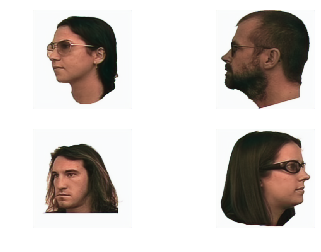

60/60 [==============================] - 1s 16ms/step
[0.0007843905089733502, 1.192093321833454e-07, 0.0007842712996837994]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
330/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000843] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

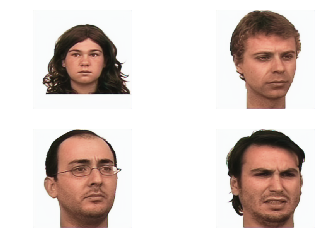

60/60 [==============================] - 1s 16ms/step
[0.0007391903355407219, 1.192093321833454e-07, 0.0007390711262511711]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
331/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001282] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

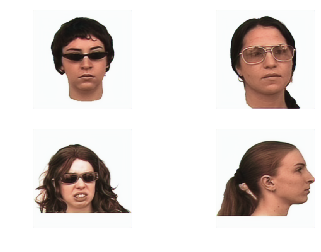

60/60 [==============================] - 1s 16ms/step
[0.0007265989008980493, 1.192093321833454e-07, 0.0007264796916084985]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
332/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000898] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

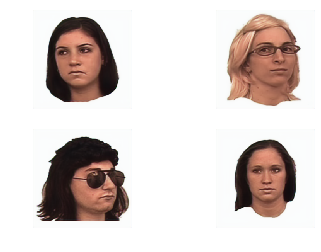

60/60 [==============================] - 1s 16ms/step
[0.0007430077957299848, 1.192093321833454e-07, 0.000742888586440434]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
333/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000749] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

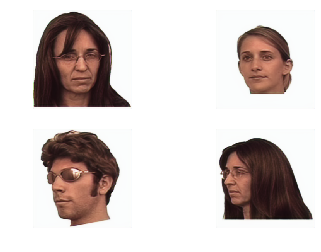

60/60 [==============================] - 1s 16ms/step
[0.0007627821100565295, 1.192093321833454e-07, 0.0007626629007669787]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
334/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000749] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

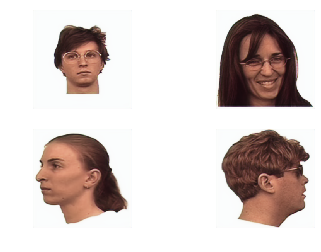

60/60 [==============================] - 1s 16ms/step
[0.000765109007867674, 1.192093321833454e-07, 0.0007649897985781232]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
335/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000765] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

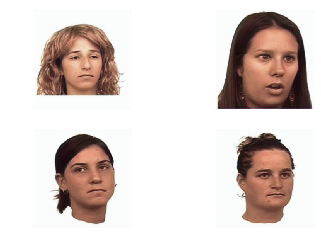

60/60 [==============================] - 1s 16ms/step
[0.0007625169237144291, 1.192093321833454e-07, 0.0007623977144248784]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
336/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000770] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

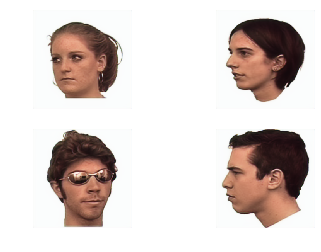

60/60 [==============================] - 1s 16ms/step
[0.0007644795152979592, 1.192093321833454e-07, 0.0007643603060084085]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
337/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000979] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

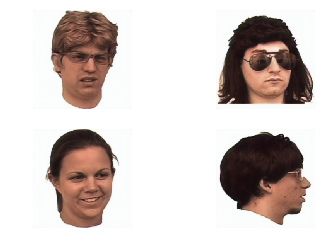

60/60 [==============================] - 1s 16ms/step
[0.000794305675663054, 1.192093321833454e-07, 0.0007941864663735032]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
338/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000869] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

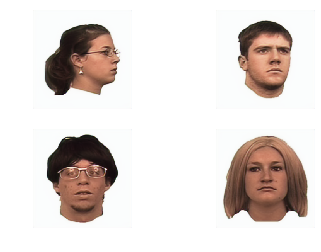

60/60 [==============================] - 1s 16ms/step
[0.0008322828720944623, 1.192093321833454e-07, 0.0008321636628049116]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
339/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000858] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

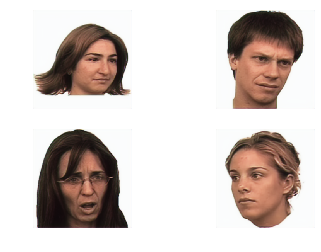

60/60 [==============================] - 1s 16ms/step
[0.0008629355773640176, 1.192093321833454e-07, 0.0008628163680744668]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
340/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001237] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

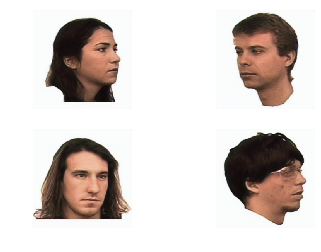

60/60 [==============================] - 1s 16ms/step
[0.0008327137019174794, 1.192093321833454e-07, 0.0008325944926279287]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
341/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000814] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

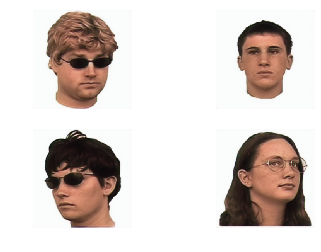

60/60 [==============================] - 1s 16ms/step
[0.0008199195571554203, 1.192093321833454e-07, 0.0008198003478658696]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
342/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001438] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

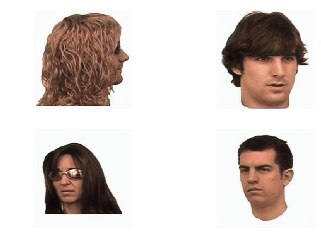

60/60 [==============================] - 1s 16ms/step
[0.0009109914962512751, 1.192093321833454e-07, 0.0009108722869617243]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
343/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001879] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

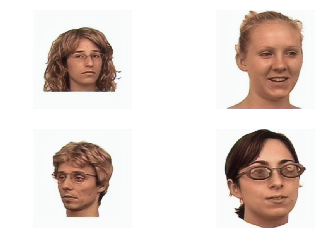

60/60 [==============================] - 1s 16ms/step
[0.001035876610937218, 1.192093321833454e-07, 0.0010357574016476672]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
344/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000774] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

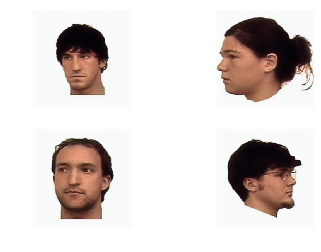

60/60 [==============================] - 1s 16ms/step
[0.001056952215731144, 1.192093321833454e-07, 0.0010568330064415932]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
345/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001000] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

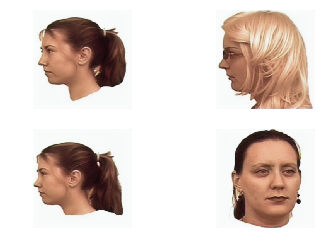

60/60 [==============================] - 1s 16ms/step
[0.0011252431276564797, 1.192093321833454e-07, 0.001125123918366929]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
346/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001107] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

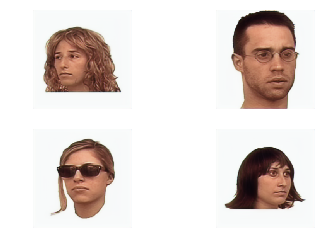

60/60 [==============================] - 1s 16ms/step
[0.0012248445069417357, 1.192093321833454e-07, 0.0012247252976521849]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
347/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001395] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

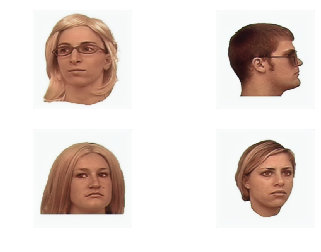

60/60 [==============================] - 1s 16ms/step
[0.001291324570775032, 1.192093321833454e-07, 0.0012912053614854812]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
348/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001037] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

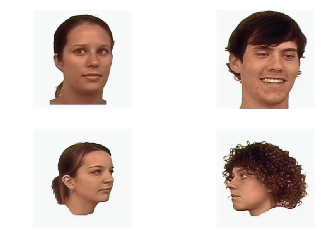

60/60 [==============================] - 1s 16ms/step
[0.0011489798702920477, 1.192093321833454e-07, 0.001148860661002497]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
349/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001410] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

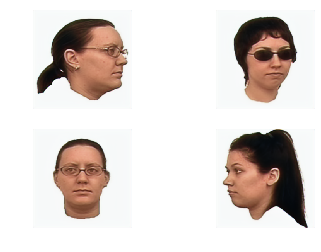

60/60 [==============================] - 1s 16ms/step
[0.0010052393578613799, 1.192093321833454e-07, 0.001005120148571829]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
350/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001051] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

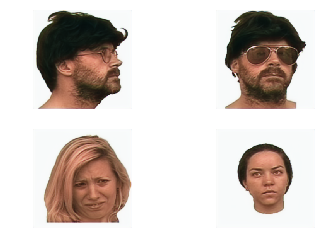

60/60 [==============================] - 1s 16ms/step
[0.0009561618052733441, 1.192093321833454e-07, 0.0009560425959837933]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
351/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000881] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

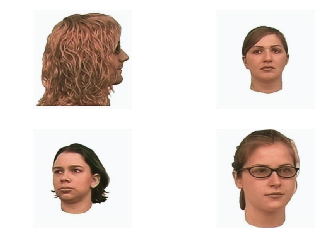

60/60 [==============================] - 1s 16ms/step
[0.0009048262417005996, 1.192093321833454e-07, 0.0009047070324110488]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
352/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001515] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

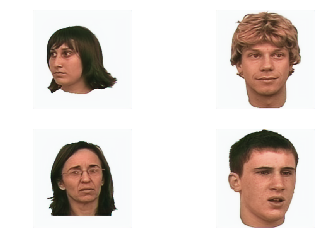

60/60 [==============================] - 1s 16ms/step
[0.0008554168472376962, 1.192093321833454e-07, 0.0008552976379481455]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
353/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000995] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

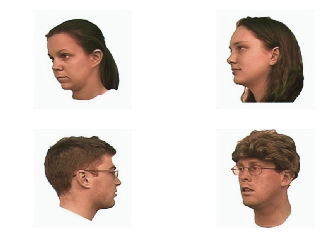

60/60 [==============================] - 1s 16ms/step
[0.0008090804136979083, 1.192093321833454e-07, 0.0008089612044083575]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
354/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000851] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

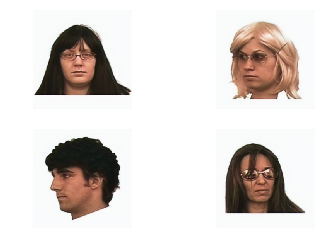

60/60 [==============================] - 1s 16ms/step
[0.0007900828418011467, 1.192093321833454e-07, 0.0007899636325115959]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
355/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000893] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

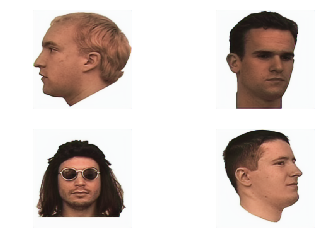

60/60 [==============================] - 1s 16ms/step
[0.000789602865309765, 1.192093321833454e-07, 0.0007894836560202142]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
356/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000794] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

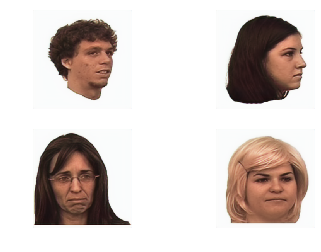

60/60 [==============================] - 1s 16ms/step
[0.0007855322328396142, 1.192093321833454e-07, 0.0007854130235500634]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
357/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001207] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

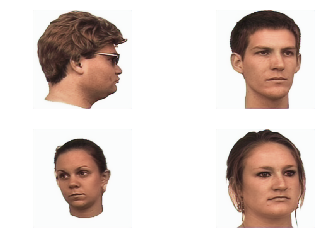

60/60 [==============================] - 1s 16ms/step
[0.0007934844858633975, 1.192093321833454e-07, 0.0007933652765738467]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
358/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000857] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

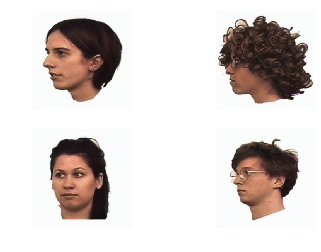

60/60 [==============================] - 1s 16ms/step
[0.0008308976927461723, 1.192093321833454e-07, 0.0008307784834566215]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
359/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000708] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

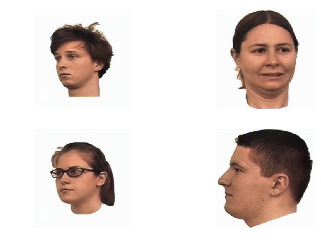

60/60 [==============================] - 1s 16ms/step
[0.0008805547802088161, 1.192093321833454e-07, 0.0008804355709192654]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
360/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000758] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

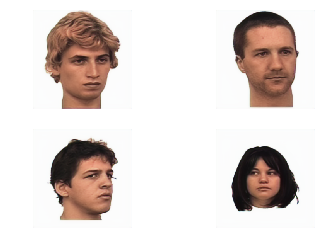

60/60 [==============================] - 1s 16ms/step
[0.0009376976639032363, 1.192093321833454e-07, 0.0009375784546136856]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
361/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000877] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

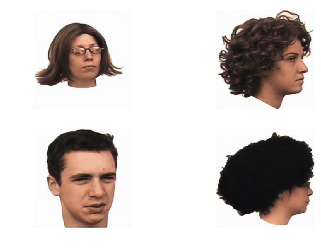

60/60 [==============================] - 1s 16ms/step
[0.0009380978609745701, 1.192093321833454e-07, 0.0009379786516850193]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
362/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000753] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

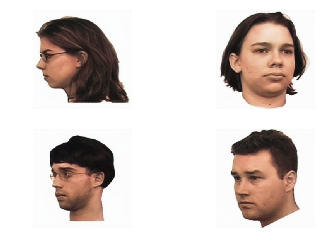

60/60 [==============================] - 1s 16ms/step
[0.0008967846088732283, 1.192093321833454e-07, 0.0008966653995836775]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
363/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000802] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

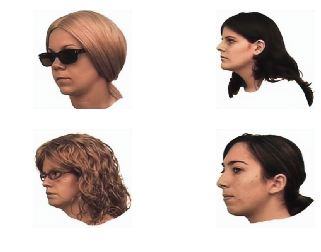

60/60 [==============================] - 1s 16ms/step
[0.0008685280530092617, 1.192093321833454e-07, 0.0008684088437197109]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
364/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001069] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

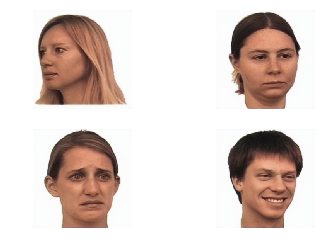

60/60 [==============================] - 1s 16ms/step
[0.0008206205442547798, 1.192093321833454e-07, 0.000820501334965229]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
365/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000986] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

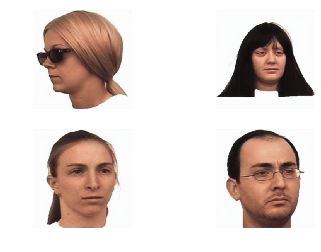

60/60 [==============================] - 1s 16ms/step
[0.0007689483463764191, 1.192093321833454e-07, 0.0007688291370868683]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
366/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000853] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

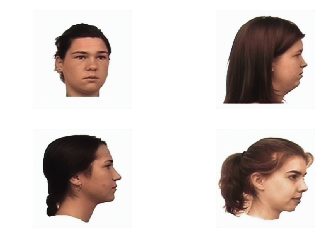

60/60 [==============================] - 1s 16ms/step
[0.0007200321687074999, 1.192093321833454e-07, 0.0007199129594179491]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
367/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000755] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

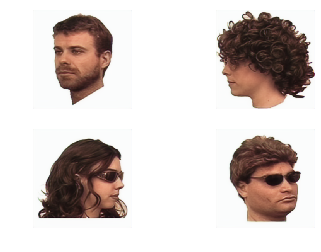

60/60 [==============================] - 1s 16ms/step
[0.0007305760596257945, 1.192093321833454e-07, 0.0007304568503362437]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
368/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001515] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

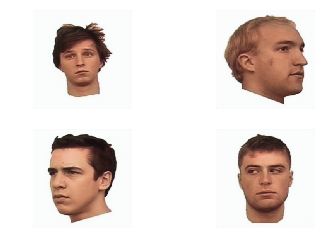

60/60 [==============================] - 1s 16ms/step
[0.0007514571072533727, 1.192093321833454e-07, 0.0007513378979638219]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
369/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000967] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

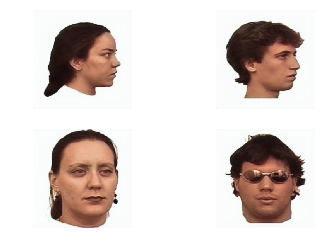

60/60 [==============================] - 1s 16ms/step
[0.0007948168825047711, 1.192093321833454e-07, 0.0007946976732152204]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
370/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000915] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

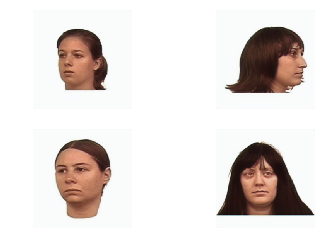

60/60 [==============================] - 1s 16ms/step
[0.000790925754699856, 1.192093321833454e-07, 0.0007908065454103053]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
371/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000766] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

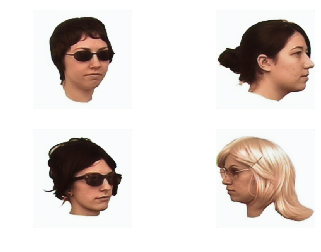

60/60 [==============================] - 1s 16ms/step
[0.0007783602884349724, 1.192093321833454e-07, 0.0007782410791454216]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
372/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000693] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

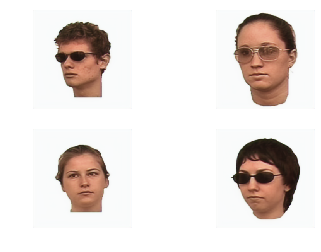

60/60 [==============================] - 1s 16ms/step
[0.0007748731411993503, 1.192093321833454e-07, 0.0007747539319097995]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
373/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001188] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

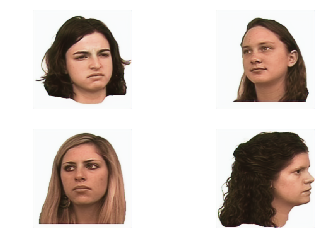

60/60 [==============================] - 1s 16ms/step
[0.0007799952096926669, 1.192093321833454e-07, 0.0007798760004031161]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
374/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000697] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

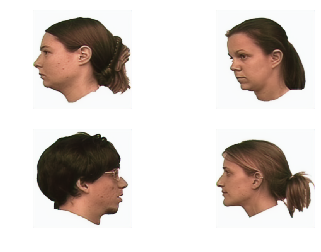

60/60 [==============================] - 1s 16ms/step
[0.0007930148121279974, 1.192093321833454e-07, 0.0007928956028384466]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
375/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001148] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

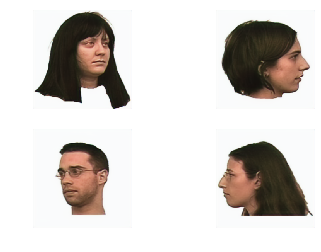

60/60 [==============================] - 1s 16ms/step
[0.0007959830768716832, 1.192093321833454e-07, 0.0007958638675821324]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
376/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001207] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

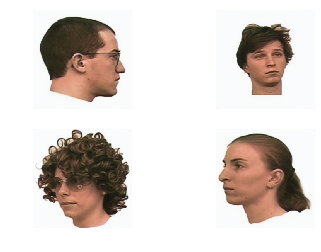

60/60 [==============================] - 1s 16ms/step
[0.0008061185517969231, 1.192093321833454e-07, 0.0008059993425073724]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
377/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001015] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

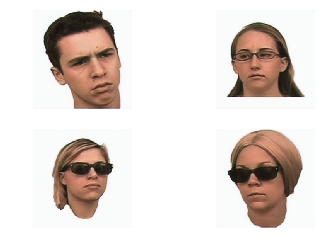

60/60 [==============================] - 1s 16ms/step
[0.0008249795335965852, 1.192093321833454e-07, 0.0008248603243070344]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
378/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000727] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

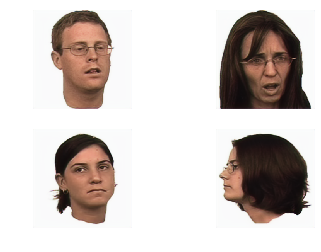

60/60 [==============================] - 1s 16ms/step
[0.0008252938627265394, 1.192093321833454e-07, 0.0008251746534369886]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
379/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000688] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

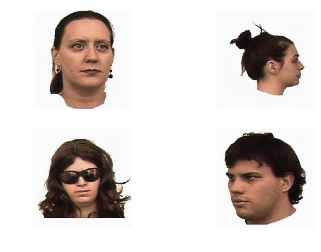

60/60 [==============================] - 1s 16ms/step
[0.000796526352254053, 1.192093321833454e-07, 0.0007964071429645022]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
380/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000907] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

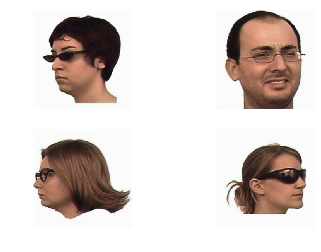

60/60 [==============================] - 1s 16ms/step
[0.0007815302776483198, 1.192093321833454e-07, 0.000781411068358769]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
381/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000638] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

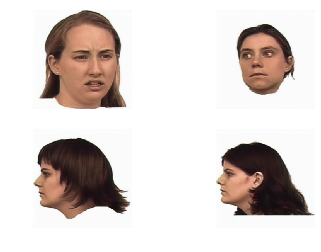

60/60 [==============================] - 1s 16ms/step
[0.0008248366842356821, 1.192093321833454e-07, 0.0008247174749461313]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
382/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001470] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

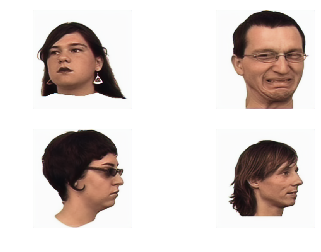

60/60 [==============================] - 1s 16ms/step
[0.0009262472119492789, 1.192093321833454e-07, 0.0009261280026597281]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
383/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001912] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

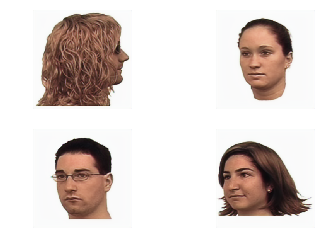

60/60 [==============================] - 1s 16ms/step
[0.0009670787529709439, 1.192093321833454e-07, 0.0009669595436813931]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
384/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000694] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

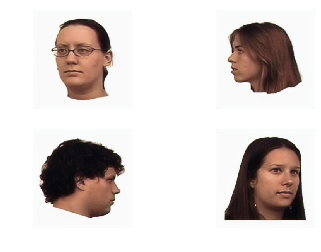

60/60 [==============================] - 1s 16ms/step
[0.0009827694894435504, 1.192093321833454e-07, 0.0009826502801539997]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
385/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000670] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

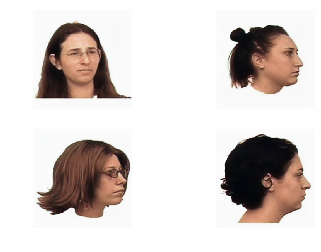

60/60 [==============================] - 1s 16ms/step
[0.0009305223861398797, 1.192093321833454e-07, 0.0009304031768503289]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
386/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000749] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

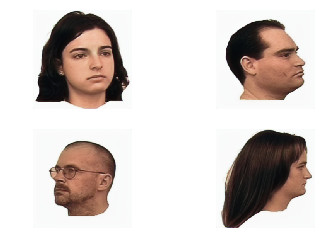

60/60 [==============================] - 1s 16ms/step
[0.0007904822821728885, 1.192093321833454e-07, 0.0007903630728833377]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
387/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002428] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

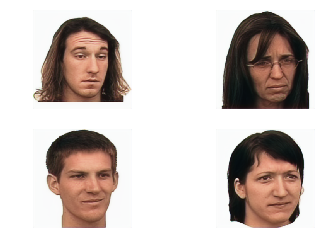

60/60 [==============================] - 1s 16ms/step
[0.000779248463610808, 1.192093321833454e-07, 0.0007791292543212572]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
388/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000712] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

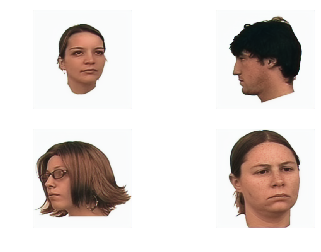

60/60 [==============================] - 1s 16ms/step
[0.0007881858386099338, 1.192093321833454e-07, 0.000788066629320383]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
389/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001208] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

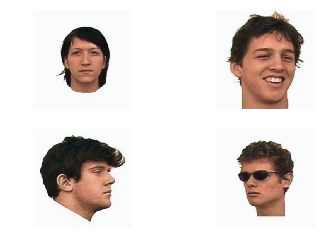

60/60 [==============================] - 1s 16ms/step
[0.0007509129160704712, 1.192093321833454e-07, 0.0007507937067809204]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
390/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000791] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

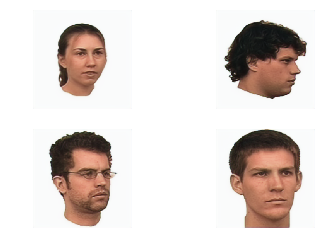

60/60 [==============================] - 1s 16ms/step
[0.0007660496669511, 1.192093321833454e-07, 0.0007659304576615492]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
391/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001101] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

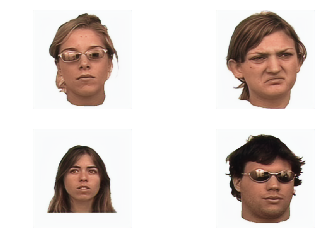

60/60 [==============================] - 1s 16ms/step
[0.000779367086943239, 1.192093321833454e-07, 0.0007792478776536882]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
392/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001199] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

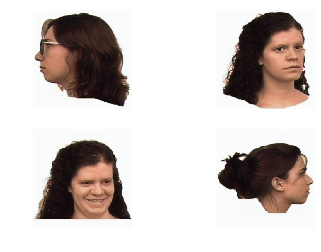

60/60 [==============================] - 1s 16ms/step
[0.0007885103928856552, 1.192093321833454e-07, 0.0007883911835961044]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
393/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000838] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

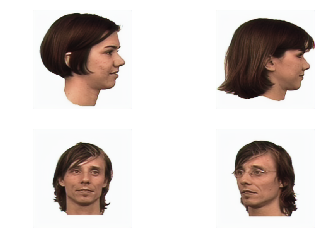

60/60 [==============================] - 1s 16ms/step
[0.0007587073642450075, 1.192093321833454e-07, 0.0007585881549554567]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
394/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000776] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

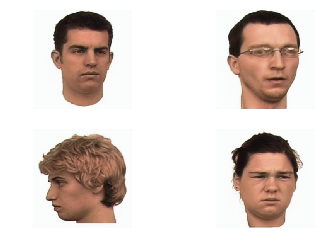

60/60 [==============================] - 1s 16ms/step
[0.0006928099280533691, 1.192093321833454e-07, 0.0006926907187638184]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
395/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001156] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

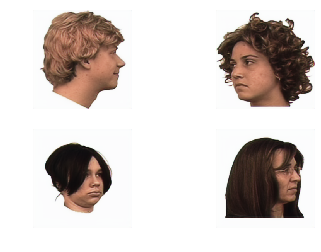

60/60 [==============================] - 1s 16ms/step
[0.0007062062077845137, 1.192093321833454e-07, 0.0007060869984949629]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
396/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001297] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

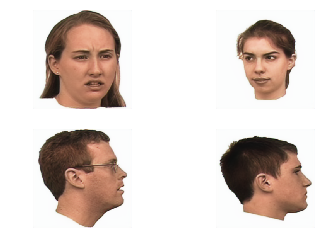

60/60 [==============================] - 1s 16ms/step
[0.0007588875557606419, 1.192093321833454e-07, 0.0007587683464710911]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
397/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001714] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

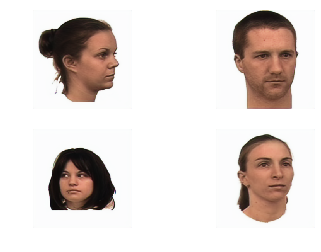

60/60 [==============================] - 1s 16ms/step
[0.0007532505551353097, 1.192093321833454e-07, 0.0007531313458457589]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
398/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000753] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

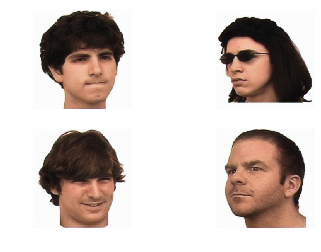

60/60 [==============================] - 1s 16ms/step
[0.0006925504033764204, 1.192093321833454e-07, 0.0006924311940868696]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
399/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000795] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

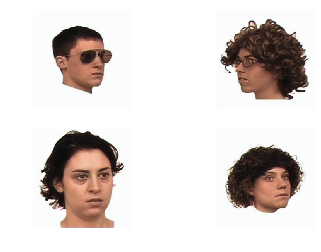

60/60 [==============================] - 1s 16ms/step
[0.0006688315498953064, 1.192093321833454e-07, 0.0006687123406057556]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
400/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000769] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

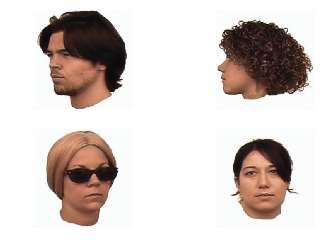

60/60 [==============================] - 1s 16ms/step
[0.0006699722842313349, 1.192093321833454e-07, 0.0006698530749417841]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
401/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000594] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

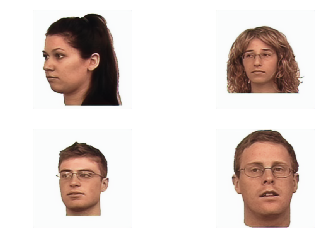

60/60 [==============================] - 1s 16ms/step
[0.0007531107752583921, 1.192093321833454e-07, 0.0007529915659688413]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
402/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002584] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

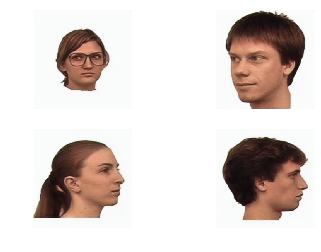

60/60 [==============================] - 1s 16ms/step
[0.0007909374389176567, 1.192093321833454e-07, 0.0007908182296281059]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
403/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000848] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

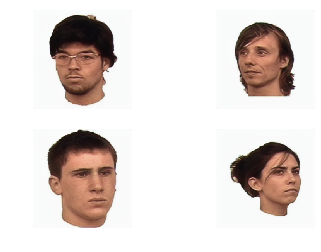

60/60 [==============================] - 1s 16ms/step
[0.0007837700890377164, 1.192093321833454e-07, 0.0007836508797481656]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
404/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000939] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

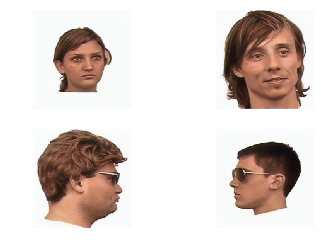

60/60 [==============================] - 1s 16ms/step
[0.0007772313392100234, 1.192093321833454e-07, 0.0007771121299204727]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
405/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000646] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

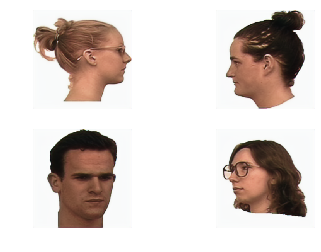

60/60 [==============================] - 1s 16ms/step
[0.0007839667610824108, 1.192093321833454e-07, 0.00078384755179286]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
406/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000694] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

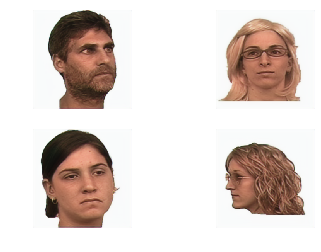

60/60 [==============================] - 1s 16ms/step
[0.0007740961465363701, 1.192093321833454e-07, 0.0007739769372468193]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
407/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000696] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

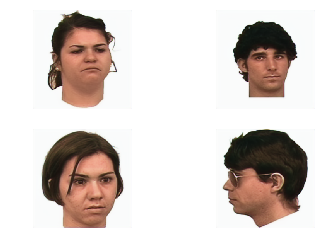

60/60 [==============================] - 1s 16ms/step
[0.0007370313513092696, 1.192093321833454e-07, 0.0007369121420197188]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
408/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000635] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

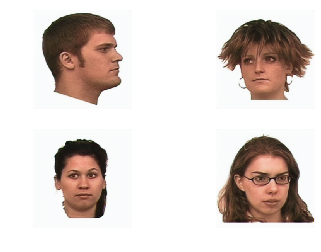

60/60 [==============================] - 1s 16ms/step
[0.000684374508758386, 1.192093321833454e-07, 0.0006842552994688352]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
409/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000820] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

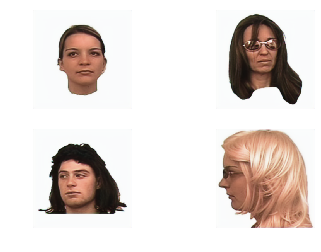

60/60 [==============================] - 1s 16ms/step
[0.000675065175164491, 1.192093321833454e-07, 0.0006749459658749402]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
410/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000829] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

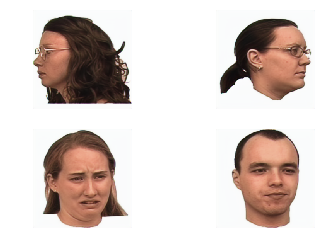

60/60 [==============================] - 1s 16ms/step
[0.0006834096158854664, 1.192093321833454e-07, 0.0006832904065959156]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
411/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000612] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

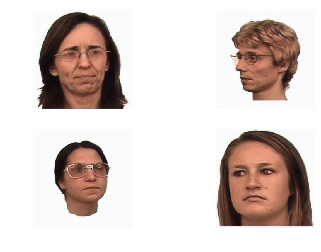

60/60 [==============================] - 1s 16ms/step
[0.0006774933892302216, 1.192093321833454e-07, 0.0006773741799406708]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
412/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000781] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

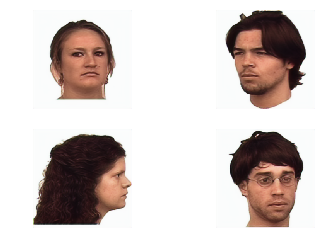

60/60 [==============================] - 1s 16ms/step
[0.0006854789874826869, 1.192093321833454e-07, 0.0006853597781931361]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
413/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000931] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

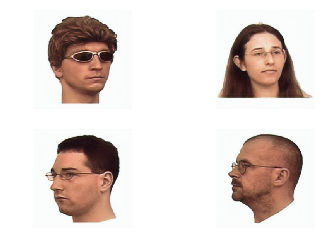

60/60 [==============================] - 1s 16ms/step
[0.0006817838759161532, 1.192093321833454e-07, 0.0006816646666266025]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
414/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000693] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

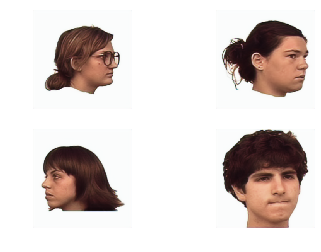

60/60 [==============================] - 1s 16ms/step
[0.0006656159840834637, 1.192093321833454e-07, 0.000665496774793913]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
415/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000862] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

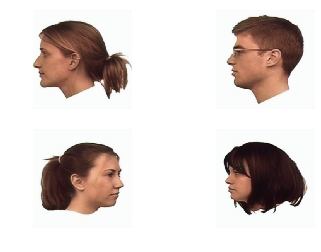

60/60 [==============================] - 1s 16ms/step
[0.000637597858440131, 1.192093321833454e-07, 0.0006374786491505802]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
416/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000758] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

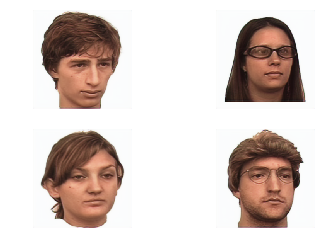

60/60 [==============================] - 1s 16ms/step
[0.0006339984053435425, 1.192093321833454e-07, 0.0006338791960539917]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
417/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000603] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

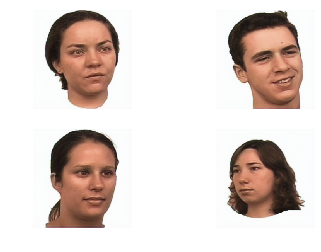

60/60 [==============================] - 1s 16ms/step
[0.0006660916570884486, 1.192093321833454e-07, 0.0006659724477988978]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
418/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000896] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

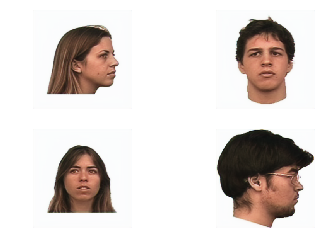

60/60 [==============================] - 1s 16ms/step
[0.0006902520428411663, 1.192093321833454e-07, 0.0006901328335516155]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
419/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000915] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

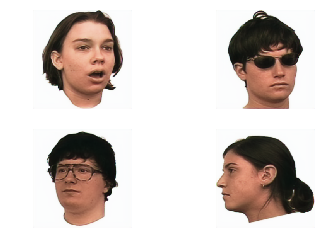

60/60 [==============================] - 1s 16ms/step
[0.0006889697552348177, 1.192093321833454e-07, 0.0006888505459452669]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
420/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000821] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

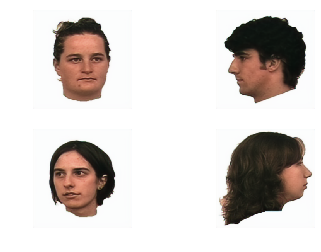

60/60 [==============================] - 1s 16ms/step
[0.0007051905190261702, 1.192093321833454e-07, 0.0007050713097366194]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
421/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000842] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

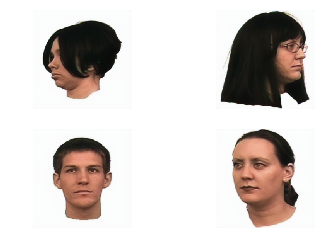

60/60 [==============================] - 1s 16ms/step
[0.0006727524994251629, 1.192093321833454e-07, 0.0006726332901356121]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
422/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000755] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

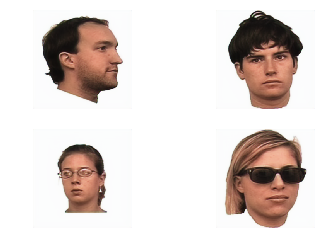

60/60 [==============================] - 1s 16ms/step
[0.0006532787578180432, 1.192093321833454e-07, 0.0006531595485284924]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
423/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000610] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

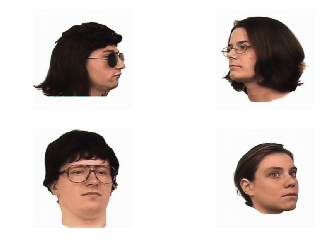

60/60 [==============================] - 1s 16ms/step
[0.0007189046707935631, 1.192093321833454e-07, 0.0007187854615040123]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
424/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001870] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

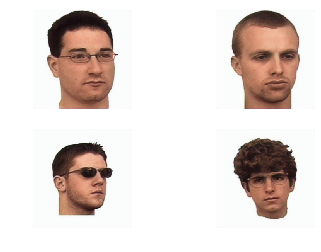

60/60 [==============================] - 1s 16ms/step
[0.0009049935188765328, 1.192093321833454e-07, 0.000904874309586982]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
425/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001564] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

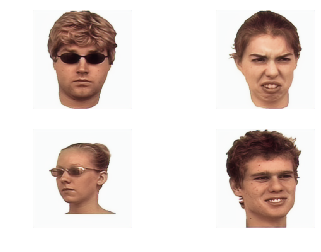

60/60 [==============================] - 1s 16ms/step
[0.0011136249561483661, 1.192093321833454e-07, 0.0011135057468588153]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
426/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000790] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

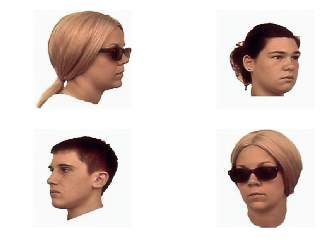

60/60 [==============================] - 1s 16ms/step
[0.001048679385955135, 1.192093321833454e-07, 0.0010485601766655843]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
427/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001283] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

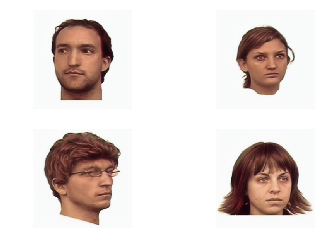

60/60 [==============================] - 1s 16ms/step
[0.0009972605233391125, 1.192093321833454e-07, 0.0009971413140495617]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
428/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000918] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

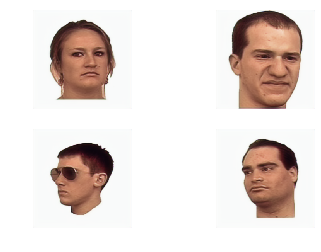

60/60 [==============================] - 1s 16ms/step
[0.0009172609269929428, 1.192093321833454e-07, 0.0009171417177033921]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
429/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000791] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

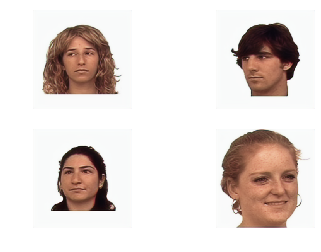

60/60 [==============================] - 1s 16ms/step
[0.000873767080095907, 1.192093321833454e-07, 0.0008736478708063562]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
430/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000732] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

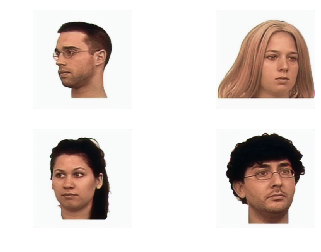

60/60 [==============================] - 1s 16ms/step
[0.0008569239367110034, 1.192093321833454e-07, 0.0008568047274214526]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
431/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000772] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

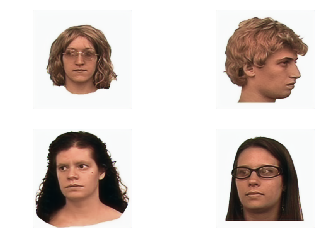

60/60 [==============================] - 1s 16ms/step
[0.0008386818420452377, 1.192093321833454e-07, 0.0008385626327556869]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
432/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000843] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

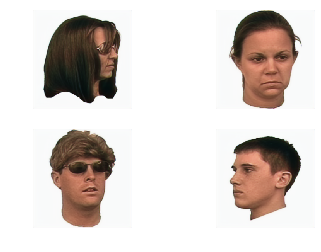

60/60 [==============================] - 1s 16ms/step
[0.0008231188791493574, 1.192093321833454e-07, 0.0008229996698598067]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
433/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000689] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

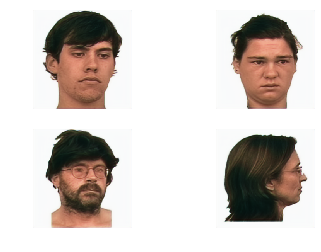

60/60 [==============================] - 1s 16ms/step
[0.0008036902989260852, 1.192093321833454e-07, 0.0008035710896365344]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
434/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001020] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

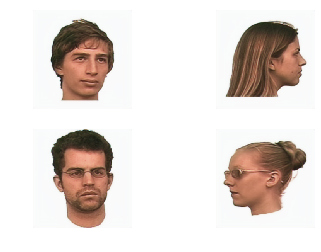

60/60 [==============================] - 1s 16ms/step
[0.0007878484825293223, 1.192093321833454e-07, 0.0007877292732397716]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
435/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000684] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

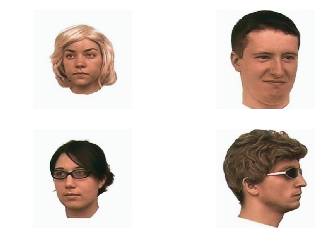

60/60 [==============================] - 1s 16ms/step
[0.0007660821080207825, 1.192093321833454e-07, 0.0007659628987312317]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
436/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000693] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

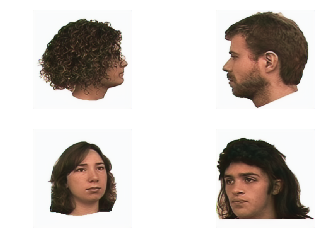

60/60 [==============================] - 1s 16ms/step
[0.0007489005181317528, 1.192093321833454e-07, 0.000748781308842202]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
437/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000818] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

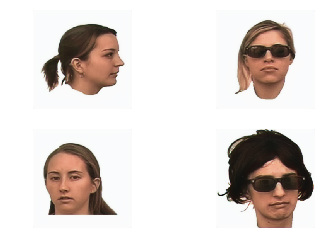

60/60 [==============================] - 1s 16ms/step
[0.000736900958387802, 1.192093321833454e-07, 0.0007367817490982512]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
438/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001057] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

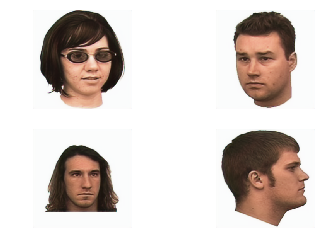

60/60 [==============================] - 1s 16ms/step
[0.0007450631392809252, 1.192093321833454e-07, 0.0007449439299913745]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
439/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000889] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

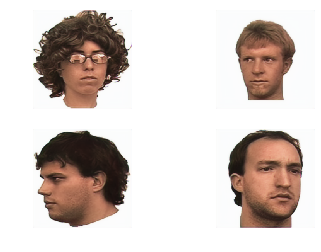

60/60 [==============================] - 1s 16ms/step
[0.0007530130717592935, 1.192093321833454e-07, 0.0007528938624697427]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
440/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000700] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

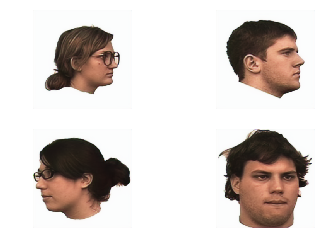

60/60 [==============================] - 1s 16ms/step
[0.0007610800714852909, 1.192093321833454e-07, 0.0007609608621957401]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
441/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001027] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

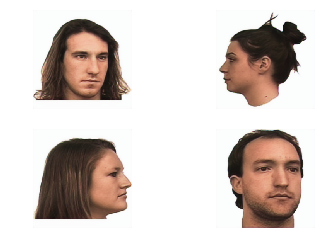

60/60 [==============================] - 1s 16ms/step
[0.0008007779833860695, 1.192093321833454e-07, 0.0008006587740965188]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
442/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000867] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

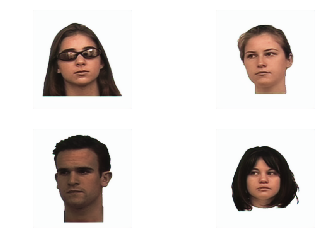

60/60 [==============================] - 1s 16ms/step
[0.0008136469948415955, 1.192093321833454e-07, 0.0008135277855520447]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
443/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000776] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

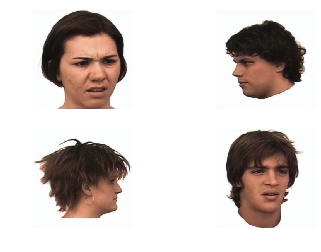

60/60 [==============================] - 1s 16ms/step
[0.0008232695089342694, 1.192093321833454e-07, 0.0008231502996447186]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
444/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000753] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

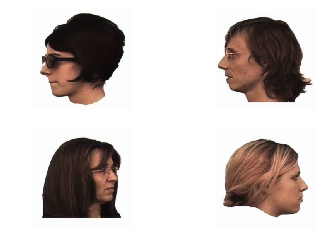

60/60 [==============================] - 1s 16ms/step
[0.0007964808610267937, 1.192093321833454e-07, 0.0007963616517372429]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
445/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000569] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

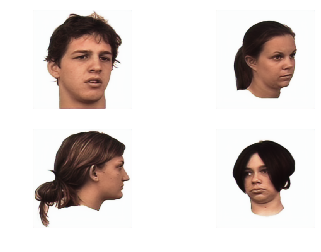

60/60 [==============================] - 1s 16ms/step
[0.000793858520531406, 1.192093321833454e-07, 0.0007937393112418552]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
446/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001221] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

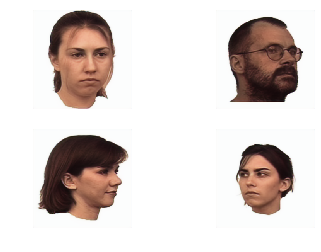

60/60 [==============================] - 1s 16ms/step
[0.0007815379571790497, 1.192093321833454e-07, 0.0007814187478894989]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
447/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000744] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

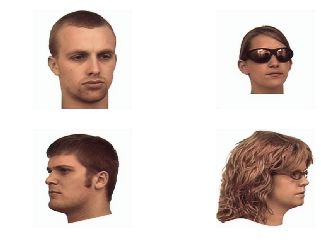

60/60 [==============================] - 1s 16ms/step
[0.0007284624502062797, 1.192093321833454e-07, 0.000728343240916729]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
448/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001478] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

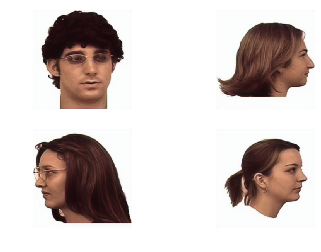

60/60 [==============================] - 1s 16ms/step
[0.0007182602654211223, 1.192093321833454e-07, 0.0007181410561315716]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
449/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000783] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

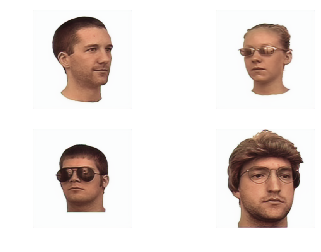

60/60 [==============================] - 1s 16ms/step
[0.0006683719887708625, 1.192093321833454e-07, 0.0006682527794813117]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
450/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001017] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

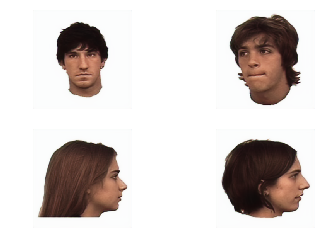

60/60 [==============================] - 1s 16ms/step
[0.0006908473054257532, 1.192093321833454e-07, 0.0006907280961362025]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
451/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000748] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

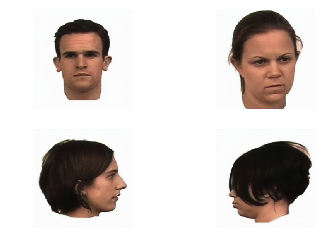

60/60 [==============================] - 1s 16ms/step
[0.0007222399154367547, 1.192093321833454e-07, 0.0007221207061472039]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
452/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000748] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

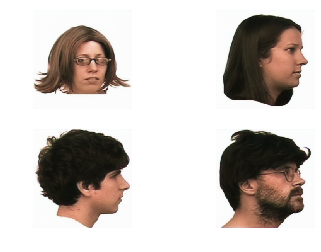

60/60 [==============================] - 1s 15ms/step
[0.0007623439732318123, 1.192093321833454e-07, 0.0007622247639422615]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
453/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000698] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

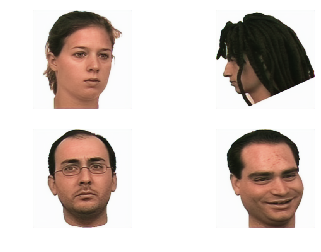

60/60 [==============================] - 1s 16ms/step
[0.0007593264182408651, 1.192093321833454e-07, 0.0007592072089513143]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
454/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000619] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

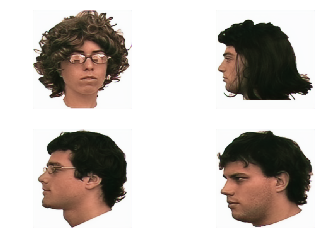

60/60 [==============================] - 1s 16ms/step
[0.000714147052106758, 1.192093321833454e-07, 0.0007140278428172072]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
455/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001550] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

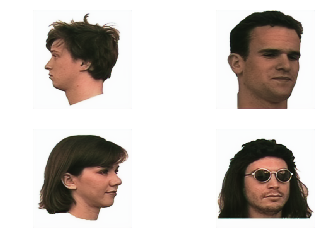

60/60 [==============================] - 1s 16ms/step
[0.0007194061491948863, 1.192093321833454e-07, 0.0007192869399053355]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
456/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001501] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

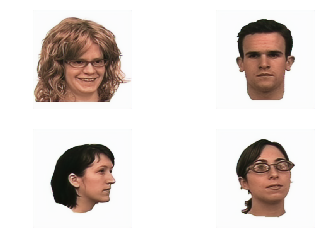

60/60 [==============================] - 1s 16ms/step
[0.0007401397645783921, 1.192093321833454e-07, 0.0007400205552888414]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
457/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000789] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

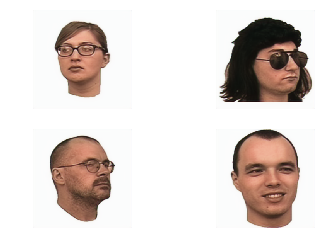

60/60 [==============================] - 1s 16ms/step
[0.0009537940844893455, 1.192093321833454e-07, 0.0009536748751997947]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
458/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.003023] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

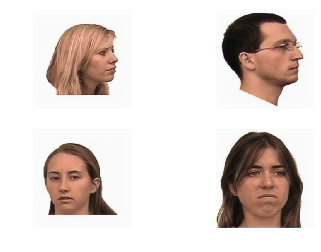

60/60 [==============================] - 1s 16ms/step
[0.0010753977810963988, 1.192093321833454e-07, 0.001075278571806848]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
459/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000833] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

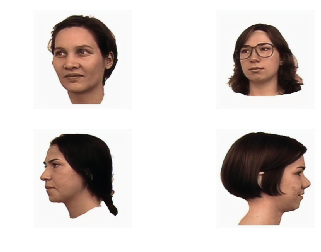

60/60 [==============================] - 1s 16ms/step
[0.0009496690123341978, 1.192093321833454e-07, 0.000949549803044647]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
460/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000915] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

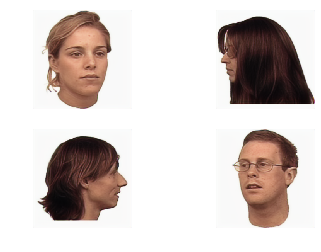

60/60 [==============================] - 1s 16ms/step
[0.0008907516215307018, 1.192093321833454e-07, 0.000890632412241151]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
461/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000861] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

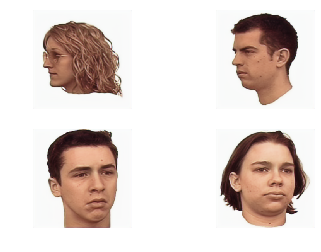

60/60 [==============================] - 1s 16ms/step
[0.0009779788049248358, 1.192093321833454e-07, 0.000977859595635285]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
462/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000935] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

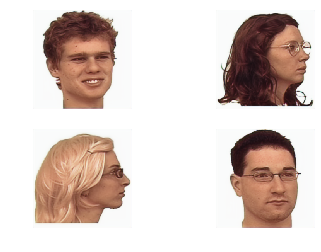

60/60 [==============================] - 1s 16ms/step
[0.0008679490458841125, 1.192093321833454e-07, 0.0008678298365945617]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
463/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001014] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

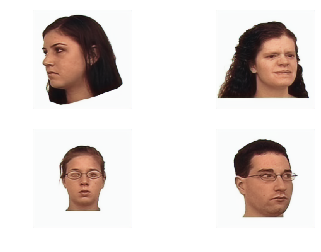

60/60 [==============================] - 1s 16ms/step
[0.0007638510277805229, 1.192093321833454e-07, 0.0007637318184909721]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
464/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000818] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

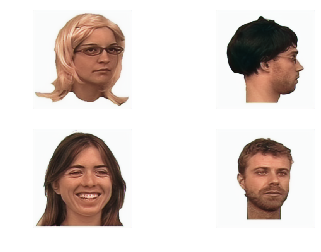

60/60 [==============================] - 1s 16ms/step
[0.0007904496703607341, 1.192093321833454e-07, 0.0007903304610711833]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
465/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000788] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

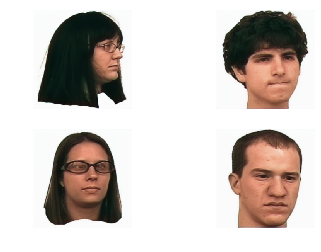

60/60 [==============================] - 1s 16ms/step
[0.0008452790168424448, 1.192093321833454e-07, 0.000845159807552894]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
466/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000940] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

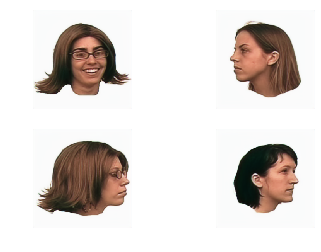

60/60 [==============================] - 1s 16ms/step
[0.0007956029730848968, 1.192093321833454e-07, 0.000795483763795346]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
467/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000780] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

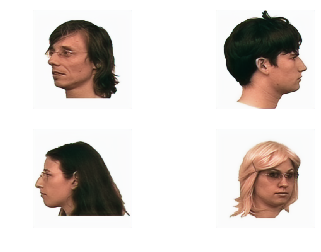

60/60 [==============================] - 1s 16ms/step
[0.0006965290134151777, 1.192093321833454e-07, 0.0006964098041256269]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
468/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000735] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

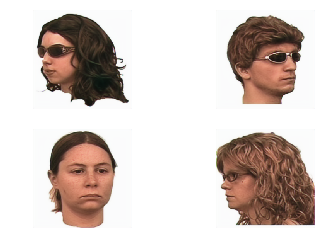

60/60 [==============================] - 1s 16ms/step
[0.0006630208847733835, 1.192093321833454e-07, 0.0006629016754838327]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
469/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000904] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

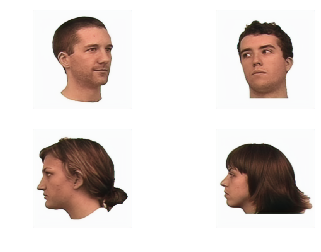

60/60 [==============================] - 1s 16ms/step
[0.0007464399561285973, 1.192093321833454e-07, 0.0007463207468390465]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
470/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000788] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

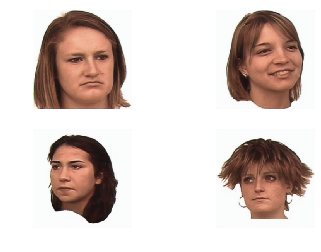

60/60 [==============================] - 1s 16ms/step
[0.0008255823515355587, 1.192093321833454e-07, 0.000825463142246008]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
471/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000618] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

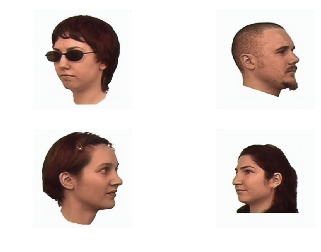

60/60 [==============================] - 1s 16ms/step
[0.000833024763657401, 1.192093321833454e-07, 0.0008329055543678502]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
472/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000696] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

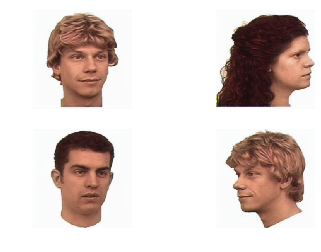

60/60 [==============================] - 1s 16ms/step
[0.0007947856055883069, 1.192093321833454e-07, 0.0007946663962987562]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
473/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000718] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

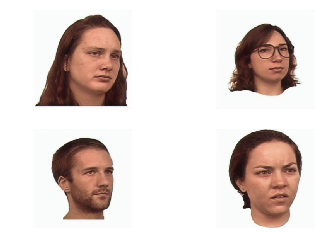

60/60 [==============================] - 1s 16ms/step
[0.0007750702595027784, 1.192093321833454e-07, 0.0007749510502132276]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
474/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000715] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

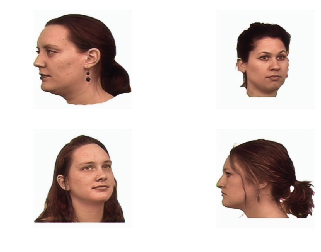

60/60 [==============================] - 1s 16ms/step
[0.0007734190012949209, 1.192093321833454e-07, 0.0007732997920053701]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
475/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000709] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

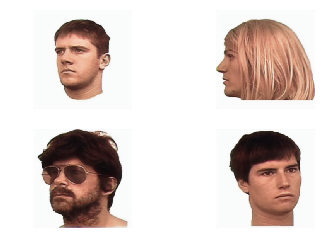

60/60 [==============================] - 1s 16ms/step
[0.0007890369510278106, 1.192093321833454e-07, 0.0007889177417382598]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
476/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001252] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

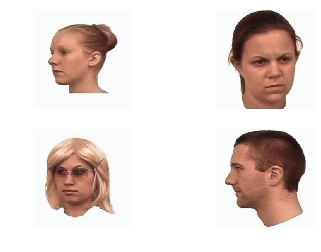

60/60 [==============================] - 1s 16ms/step
[0.0007941135438159109, 1.192093321833454e-07, 0.0007939943345263601]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
477/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002523] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

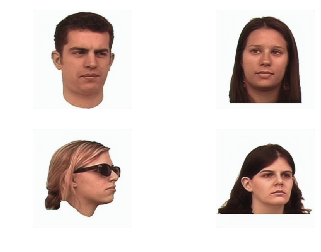

60/60 [==============================] - 1s 16ms/step
[0.00074704420985654, 1.192093321833454e-07, 0.0007469250005669892]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
478/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000629] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

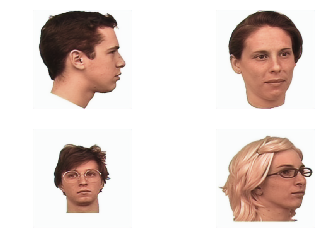

60/60 [==============================] - 1s 16ms/step
[0.0007257593485216299, 1.192093321833454e-07, 0.0007256401392320792]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
479/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000787] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

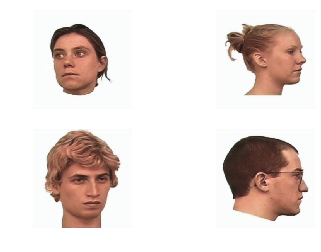

60/60 [==============================] - 1s 16ms/step
[0.0006628410774283111, 1.192093321833454e-07, 0.0006627218681387603]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
480/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000694] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

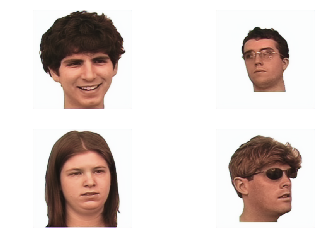

60/60 [==============================] - 1s 16ms/step
[0.0006163121627954146, 1.192093321833454e-07, 0.0006161929535058638]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
481/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001575] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

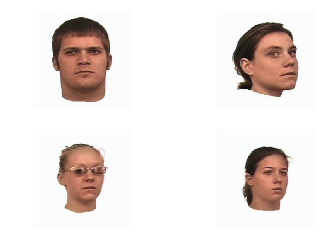

60/60 [==============================] - 1s 16ms/step
[0.0006500934638703862, 1.192093321833454e-07, 0.0006499742545808355]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
482/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000725] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

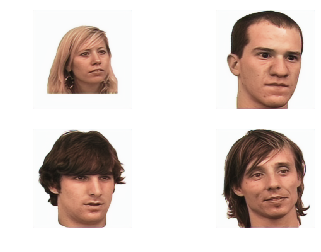

60/60 [==============================] - 1s 16ms/step
[0.000647853776657333, 1.192093321833454e-07, 0.0006477345673677822]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
483/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000660] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

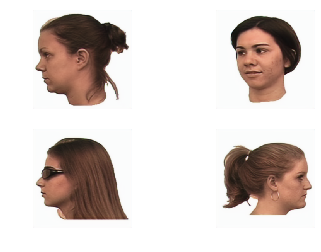

60/60 [==============================] - 1s 16ms/step
[0.000621199794113636, 1.192093321833454e-07, 0.0006210805848240852]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
484/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000819] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

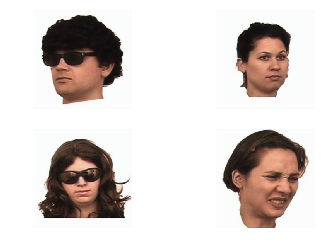

60/60 [==============================] - 1s 16ms/step
[0.0006145441167367001, 1.192093321833454e-07, 0.0006144249074471493]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
485/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000661] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

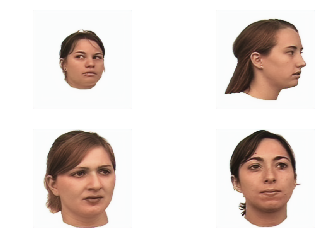

60/60 [==============================] - 1s 16ms/step
[0.0006166361815606554, 1.192093321833454e-07, 0.0006165169722711047]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
486/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000643] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

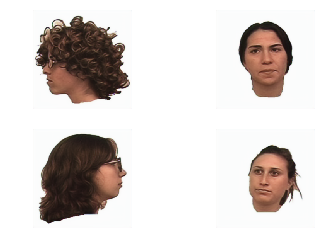

60/60 [==============================] - 1s 16ms/step
[0.0006125907180830837, 1.192093321833454e-07, 0.0006124715087935329]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
487/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000693] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

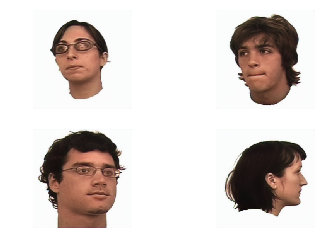

60/60 [==============================] - 1s 16ms/step
[0.0006124708529872199, 1.192093321833454e-07, 0.0006123516436976691]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
488/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000845] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

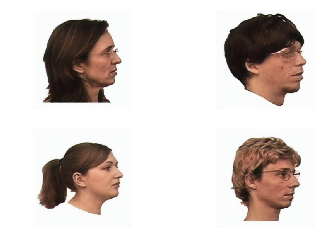

60/60 [==============================] - 1s 16ms/step
[0.0006036653532646597, 1.192093321833454e-07, 0.0006035461439751089]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
489/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001299] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

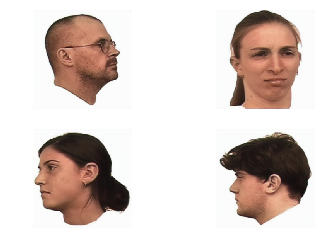

60/60 [==============================] - 1s 16ms/step
[0.0006348023229899506, 1.192093321833454e-07, 0.0006346831137003998]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
490/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001476] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

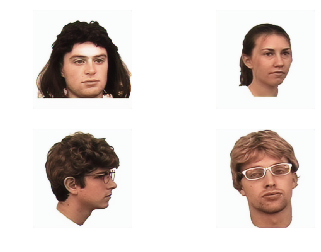

60/60 [==============================] - 1s 16ms/step
[0.0006597019537972908, 1.192093321833454e-07, 0.00065958274450774]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
491/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000628] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

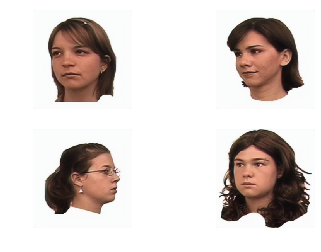

60/60 [==============================] - 1s 16ms/step
[0.0007557552501869699, 1.192093321833454e-07, 0.0007556360408974191]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
492/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000732] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

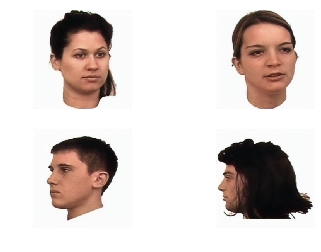

60/60 [==============================] - 1s 16ms/step
[0.0007384175201877952, 1.192093321833454e-07, 0.0007382983108982444]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
493/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000641] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

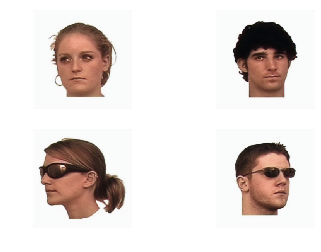

60/60 [==============================] - 1s 16ms/step
[0.0006347533858691652, 1.192093321833454e-07, 0.0006346341765796145]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
494/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001450] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

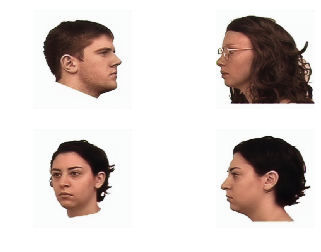

60/60 [==============================] - 1s 16ms/step
[0.0006335200858302414, 1.192093321833454e-07, 0.0006334008765406906]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
495/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000667] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

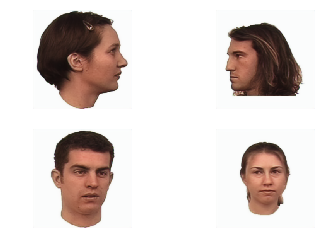

60/60 [==============================] - 1s 16ms/step
[0.0006311582828251024, 1.192093321833454e-07, 0.0006310390735355516]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
496/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.001224] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

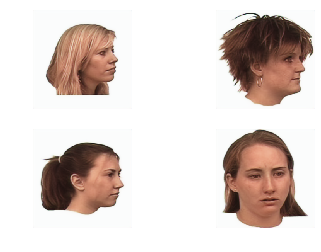

60/60 [==============================] - 1s 16ms/step
[0.0006173644447699189, 1.192093321833454e-07, 0.0006172452354803682]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
497/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000642] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

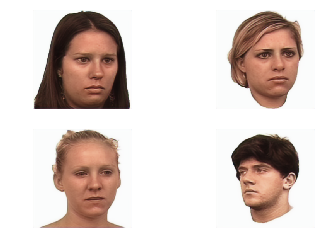

60/60 [==============================] - 1s 16ms/step
[0.0006103809496077399, 1.192093321833454e-07, 0.0006102617403181891]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
498/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.002155] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

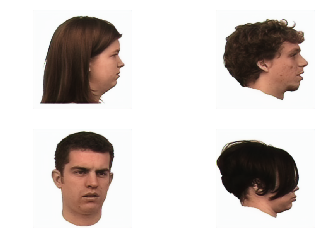

60/60 [==============================] - 1s 16ms/step
[0.0006560904905200005, 1.192093321833454e-07, 0.0006559712812304497]
d_real: [1.1920933e-07, 1.0]
d_fake: [15.942385, 0.0]
499/500 [D loss: 7.971192, acc.: 50.00%] [G loss mse: 0.000621] [G loss bce: 0.000000]


<Figure size 432x288 with 0 Axes>

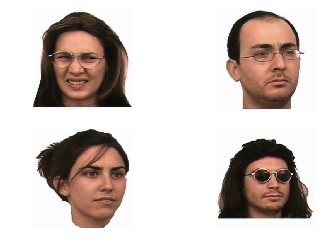

In [0]:
import gc

save_interval = 1
weight_path = "best_weights_generator"

d_losses_fake = []
d_losses_real = []
d_losses = []
g_losses = []

min_mse_loss = 10000
val_losses = []

for epoch in range(epochs):
  # Adversarial ground truths
  valid = np.ones((batch_size, 1)) #np.random.uniform(0.7, 1.0, batch_size) 
  fake =  np.zeros((batch_size, 1)) #np.random.uniform(0.0, 0.3, batch_size) 
  
  ## 
  # Train discriminator activation='sigmoid'))          
  
  # Select a random batch of images
  idx = np.random.randint(0, len(imgs_rgb_train), batch_size)

  batch_rgb, batch_gs = load_batch(imgs_rgb_train, imgs_gs_train, idx)

  # Generate a batch of new images
  gen_imgs = generator.predict(batch_gs)

  # Run training on discrimantor
  d_loss_real = discriminator.train_on_batch(batch_rgb, valid)
  d_loss_fake = discriminator.train_on_batch(gen_imgs, fake)
  d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
  
  d_losses_fake.append(d_loss_fake)
  d_losses_real.append(d_loss_real)
  d_losses.append(d_loss)
 
  
  ##
  # Train generator
  
  idx_a = np.random.randint(0, len(imgs_rgb_train), batch_size)
  batch_rgb, batch_gs = load_batch(imgs_rgb_train, imgs_gs_train, idx_a)
  
  g_loss = adversarial.train_on_batch(batch_gs, [valid, batch_rgb])
  g_losses.append(g_loss)
  
  valid_val = np.ones((60, 1))
  batch_rgb_val, batch_gs_val = load_batch(imgs_rgb_val, imgs_gs_val, list(range(60)))
  val_loss = adversarial.evaluate(batch_gs_val, [valid_val, batch_rgb_val])
  
  
  print(val_loss)
  if (val_loss[0] < min_mse_loss):
    generator.save_weights(weight_path)
    min_mse_loss = val_loss[0]
    val_losses.append(val_loss)
    
  if epoch % save_interval == 0:
    print("d_real:", d_loss_real)
    print("d_fake:", d_loss_fake)
    
    # Plot the progress
    print ("%d/%d [D loss: %f, acc.: %.2f%%] [G loss mse: %f] [G loss bce: %f]" % 
         (epoch, epochs, d_loss[0], 100*d_loss[1], g_loss[0], g_loss[1]))
    
    # show images if at save interval
    sample_images(epoch, generator, batch_gs)
  
  # Free memory
  del batch_gs
  del batch_rgb
  del batch_gs_val
  del batch_rgb_val
  gc.collect()

## Model evaluation

## Loss discriminator

Here also the chart is hard to analyse. The loss is  almost always fixed except at around 110 iterations where it drastically increase before goind back to its previous value.

[[0.0007721359, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933e-07, 1.0], [1.1920933

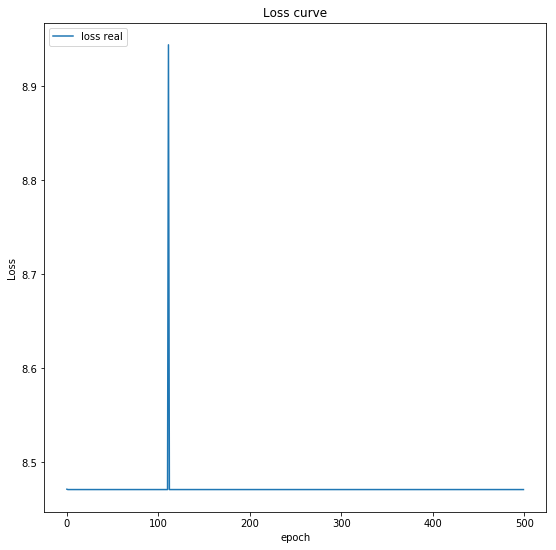

In [0]:
import matplotlib.pyplot as plt

print(d_losses_real)
np_d_losses_real = np.array(d_losses_real)
np_d_losses_fake = np.array(d_losses_fake)
np_d_losses = np.array(d_losses)
np_g_losses = np.array(g_losses)
np_val_losses = np.array(val_losses)

# Plot curve for loss
plt.rcParams["figure.figsize"] = [9,9]
plt.plot(np_d_losses[:,0] + np_d_losses[:,1])
plt.title('Loss curve')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['loss real'], loc='upper left')
plt.show()

## Loss generator

The generator error overall decrease during training. The reduction is considerable at the beginning and slow down after 50 itererations which is a good thing. 

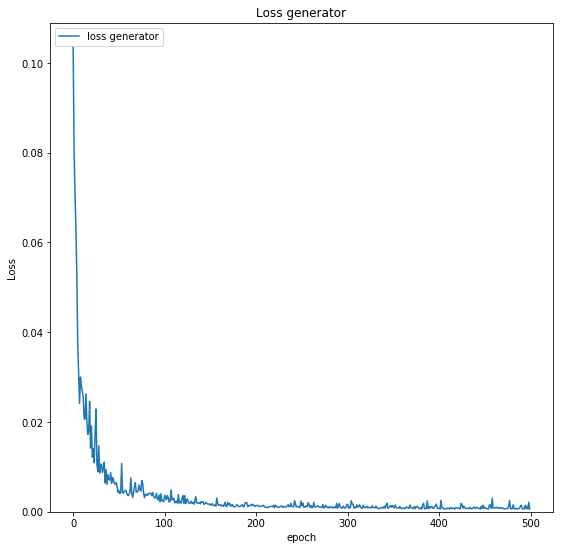

In [0]:
# Plot curve for loss
plt.rcParams["figure.figsize"] = [9,9]
plt.plot(np_g_losses[:,2])
plt.title('Loss generator')
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.legend(['loss generator'], loc='upper left')
plt.ylim(bottom=0)
plt.show()

# Val loss

The loss for the generator during validation follows the same pattern as during trainning. We observe an incremental reduction of the error.

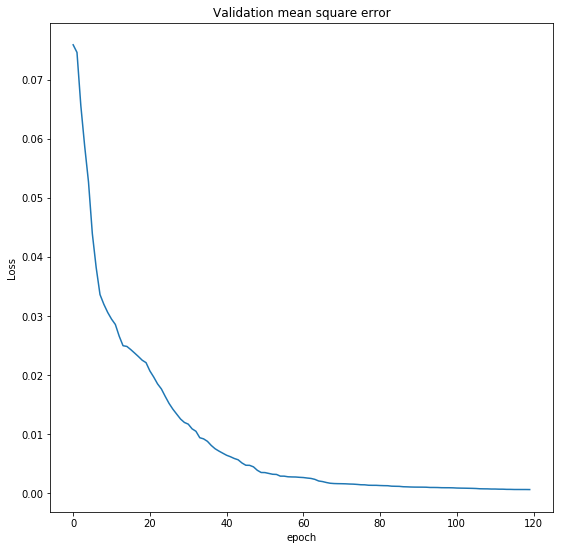

In [0]:
plt.rcParams["figure.figsize"] = [9,9]
plt.plot(np_val_losses[:,0])
plt.title("Validation mean square error")
plt.ylabel('Loss')
plt.xlabel('epoch')
plt.show()

# Model Accuracy

We maintained the same threshold as in the asian notebook and we observe here that the result are less good since we have 89 bad colorization compared to only 4 for the asian race.

In [0]:
from skimage.feature import match_template

#copy_generator = generator
#generator.load_weights(weight_path)
batch_rgb_test, batch_gs_test = load_batch(imgs_rgb_test, imgs_gs_test, 
                                           list(range(len(imgs_gs_test))))
gen_rgb_images = generator.predict(batch_gs_test)


# Takes too much time
#correlations = []
#for i in range(gen_rgb_images.shape[0]):
#  sum = np.sum(match_template(gen_rgb_images[i], imgs_rgb_test[i]))
#  correlations.append(sum)

absolute_diff = np.abs(gen_rgb_images - batch_rgb_test) / (img_width * img_height)
sad = np.sum(absolute_diff, axis=(1,2,3)) / 3

# Arbitrary thereshold for separating bad and good colorization
thresh = 0.02
good_colorization = len(sad[sad < thresh])

print("Number of good colorization:", good_colorization)
print("Number of bad colorization:", len(sad) - good_colorization)

print("----")

#print(good_colorization)
#print(sad)

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


Number of good colorization: 584
Number of bad colorization: 89
----


<Figure size 648x648 with 0 Axes>

# Good and bad examples

In [0]:
i_top3_bad = sad.argsort()[-3:]
i_top3_good = sad.argsort()[:3]

# Show the 3 best exampes

The same observation as with the Asian race can also be made here. Prediction are good when people have "mostly" black hair and wear no glasses.

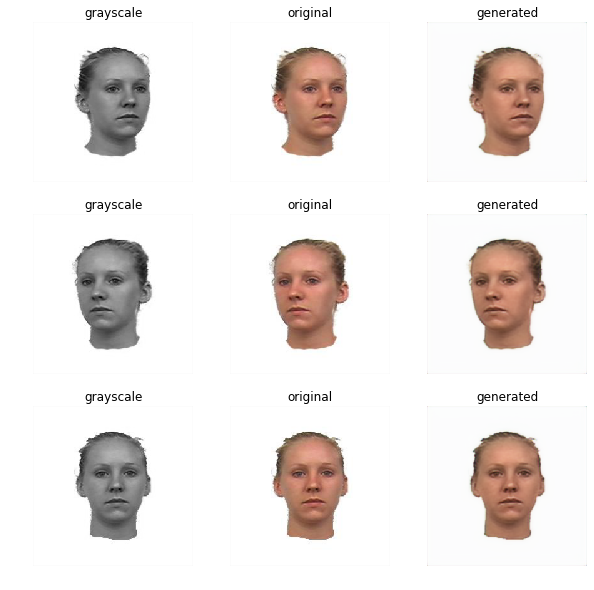

In [0]:
fig, axis = plt.subplots(3, 3, sharey=True, figsize=(10,10))
cnt = 0
for i in i_top3_good:
  axis[cnt,0].imshow(batch_gs_test[i, :, :,0], cmap='gray')
  axis[cnt,0].axis('off')
  axis[cnt,0].set_title('grayscale')
  
  axis[cnt,1].imshow(batch_rgb_test[i, :, :,])
  axis[cnt,1].axis('off')
  axis[cnt,1].set_title('original')
  
  axis[cnt,2].imshow(gen_rgb_images[i, :, :,])
  axis[cnt,2].axis('off')
  axis[cnt,2].set_title('generated')
  
  cnt += 1
plt.show()
plt.close()

# Show the 3 worse exampes

As in the Asian notebook also, our generator struggle to colorize images that include people having colored hair and/or wearing glasses. But that totally make sense and overall we can say we have very good looking results.

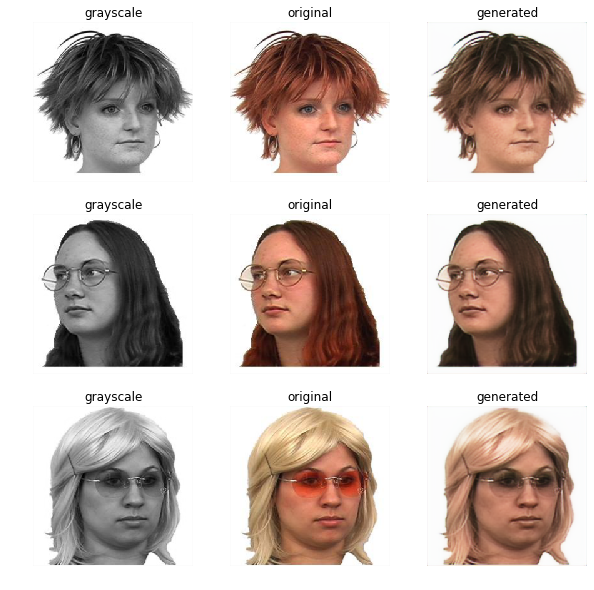

In [0]:
fig, axis = plt.subplots(3, 3, sharey=True, figsize=(10,10))
cnt = 0
for i in i_top3_bad:
  axis[cnt,0].imshow(batch_gs_test[i, :, :,0], cmap='gray')
  axis[cnt,0].axis('off')
  axis[cnt,0].set_title('grayscale')
  
  axis[cnt,1].imshow(batch_rgb_test[i, :, :,])
  axis[cnt,1].axis('off')
  axis[cnt,1].set_title('original')
  
  axis[cnt,2].imshow(gen_rgb_images[i, :, :,])
  axis[cnt,2].axis('off')
  axis[cnt,2].set_title('generated')
  
  cnt += 1
plt.show()
plt.close()

# Save best model in my Google Drive

In [0]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

#!ls "/content/drive/My Drive"
TP_DL_dir = "/content/drive/My\ Drive/TP_DL"

BEST_WEIGHTS = (TP_DL_dir + "/generator_caucasian_weights.hd5").replace('\ ', ' ')
BEST_MODEL = (TP_DL_dir + "/generator_caucasian_model.hd5").replace('\ ', ' ')

print(BEST_MODEL)

generator.save_weights(BEST_WEIGHTS)
generator.save(BEST_MODEL)

!ls {TP_DL_dir}

Mounted at /content/drive
/content/drive/My Drive/TP_DL/generator_caucasian_model.hd5
densenet_model.hd5		 mobilenetv2_weights.hd5
densenet_weights.hd5		 own_model.hd5
FaceData.csv			 own_model_weights.hd5
FacesDataset.zip		 tp_dl_gan_generator.png
generator_asian_model.hd5	 vgg_no_transfert_best_model.hd5
generator_asian_weights.hd5	 vgg_no_transfert_best_weights.hd5
generator_caucasian_model.hd5	 vgg_transfert_best_model.hd5
generator_caucasian_weights.hd5  vgg_transfert_best_weights.hd5
mobilenetv2_model.hd5
